In [1]:
import os
os.chdir('mmpose')

In [2]:
!python tools/misc/publish_model.py \
        work_dirs/rtmpose-m-Dog_hip_all_heatmap2/best_PCK_epoch_10.pth\
        checkpoint/all_m_heatmap2_best_PCK_epoch_10.pth

11/05 01:36:42 - mmengine - INFO - Key `message_hub` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.
11/05 01:36:42 - mmengine - INFO - Key `ema_state_dict` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.


In [2]:

!python tools/model_converters/publish_model.py \
        work_dirs/rtmdet_m_dog_hip/best_m_all_epoch_287-487eb8f1.pth\
        checkpoint/rtmdet_m_dog_hip_287.pth

10/31 05:35:55 - mmengine - INFO - The published model is saved at checkpoint/rtmdet_m_dog_hip_287-55485ded.pth.


In [3]:
import cv2
import numpy as np
from PIL import Image

import matplotlib.pyplot as plt
%matplotlib inline
import scipy
import pandas as pd

import torch

import mmcv
from mmcv import imread
import mmengine
from mmengine.registry import init_default_scope

from mmpose.apis import inference_topdown
from mmpose.apis import init_model as init_pose_estimator
from mmpose.evaluation.functional import nms
from mmpose.registry import VISUALIZERS
from mmpose.structures import merge_data_samples
import matplotlib.patches as patches

from mmdet.apis import inference_detector, init_detector



In [4]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('device', device)

device cuda:0


In [5]:
# rtmdet
detector = init_detector(
    '/home/featurize/work/mmdetection/data/rtmdet_m_dog_hip_all.py',
    
    '/home/featurize/work/mmdetection/checkpoint/rtmdet_m_dog_hip_287-55485ded.pth',
    device=device
)

Loads checkpoint by local backend from path: /home/featurize/work/mmdetection/checkpoint/rtmdet_m_dog_hip_287-55485ded.pth


In [6]:
img_path = '/home/featurize/work/Dataset2/data/July_2024/138477.jpg'
init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

detect_result = inference_detector(detector, img_path)

/environment/miniconda3/lib/python3.7/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [7]:
detect_result.keys()

['gt_instances', 'pred_instances', 'ignored_instances']

In [8]:
labels =detect_result.pred_instances.labels
labels

tensor([1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0,
        1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0,
        1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0,
        0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1,
        0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0,
        1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1,
        0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0,
        0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1,
        0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0,

In [9]:
print(dir(detect_result.pred_instances))

['__class__', '__contains__', '__delattr__', '__delitem__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getitem__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__len__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__setitem__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_data_fields', '_metainfo_fields', 'all_items', 'all_keys', 'all_values', 'bboxes', 'cat', 'clone', 'cpu', 'cuda', 'detach', 'get', 'items', 'keys', 'labels', 'metainfo', 'metainfo_items', 'metainfo_keys', 'metainfo_values', 'mlu', 'musa', 'new', 'npu', 'numpy', 'pop', 'scores', 'set_data', 'set_field', 'set_metainfo', 'to', 'to_dict', 'to_tensor', 'update', 'values']


In [10]:
scores = detect_result.pred_instances.scores
scores 

tensor([0.8907, 0.8867, 0.8737, 0.8702, 0.0294, 0.0287, 0.0280, 0.0233, 0.0230,
        0.0224, 0.0221, 0.0208, 0.0204, 0.0200, 0.0195, 0.0193, 0.0193, 0.0192,
        0.0189, 0.0182, 0.0181, 0.0180, 0.0177, 0.0176, 0.0172, 0.0169, 0.0168,
        0.0167, 0.0164, 0.0164, 0.0163, 0.0162, 0.0161, 0.0160, 0.0160, 0.0160,
        0.0154, 0.0154, 0.0153, 0.0153, 0.0148, 0.0148, 0.0146, 0.0145, 0.0144,
        0.0143, 0.0142, 0.0142, 0.0140, 0.0139, 0.0139, 0.0136, 0.0133, 0.0132,
        0.0130, 0.0130, 0.0130, 0.0129, 0.0127, 0.0126, 0.0125, 0.0122, 0.0121,
        0.0121, 0.0120, 0.0120, 0.0119, 0.0118, 0.0118, 0.0118, 0.0118, 0.0118,
        0.0118, 0.0118, 0.0116, 0.0115, 0.0114, 0.0114, 0.0114, 0.0114, 0.0113,
        0.0113, 0.0112, 0.0112, 0.0112, 0.0111, 0.0111, 0.0111, 0.0111, 0.0110,
        0.0109, 0.0109, 0.0109, 0.0109, 0.0109, 0.0109, 0.0108, 0.0108, 0.0108,
        0.0108, 0.0107, 0.0105, 0.0105, 0.0105, 0.0104, 0.0104, 0.0103, 0.0101,
        0.0101, 0.0100, 0.0100, 0.0099, 

In [11]:
bboxes=detect_result.pred_instances.bboxes[:]
bboxes

tensor([[670.9723, 102.6737, 777.4457, 208.7479],
        [203.4628, 117.4417, 313.1943, 226.7877],
        [690.3491,  43.8762, 797.8333, 150.8404],
        ...,
        [103.2378,   0.0000, 228.7820,  18.5969],
        [ 82.3360, 181.3803, 108.6817, 215.5638],
        [670.5011, 157.0962, 734.7714, 208.8127]], device='cuda:0')

In [12]:
pose_estimator = init_pose_estimator(
    '/home/featurize/work/mmpose/data/rtmpose-m-Dog_hip_all_heatmap2.py',
    '/home/featurize/work/mmpose/checkpoint/all_m_heatmap2_best_PCK_epoch_10-cc5eeb91_20241105.pth',
    device=device,
    cfg_options={'model': {'test_cfg': {'output_heatmaps': True}}}
)

Loads checkpoint by local backend from path: /home/featurize/work/mmpose/checkpoint/all_m_heatmap2_best_PCK_epoch_10-cc5eeb91_20241105.pth


In [13]:
img_path = '/home/featurize/work/Dataset2/data/July_2024/138477.jpg'

In [14]:
init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

11/05 01:38:34 - mmengine - WARNING - The current default scope "mmpose" is not "mmdet", `init_default_scope` will force set the currentdefault scope to "mmdet".


In [15]:
detect_result = inference_detector(detector, img_path)

In [16]:
detect_result.keys()

['gt_instances', 'pred_instances', 'ignored_instances']

In [17]:
CONF_THRES = 0.5

In [18]:
pred_instance = detect_result.pred_instances.cpu().numpy()
bboxes = np.concatenate((pred_instance.bboxes, pred_instance.scores[:, None]), axis=1)
bboxes = bboxes[np.logical_and(pred_instance.labels == 0, pred_instance.scores > CONF_THRES)]
bboxes = bboxes[nms(bboxes, 0.3)][:, :4].astype('int')

In [19]:
bboxes

array([[690,  43, 797, 150],
       [175,  60, 285, 170]])

In [20]:

pose_results = inference_topdown(pose_estimator, img_path, bboxes)

11/05 01:38:38 - mmengine - WARNING - The current default scope "mmdet" is not "mmpose", `init_default_scope` will force set the currentdefault scope to "mmpose".


In [21]:
len(pose_results)

2

In [22]:
print(dir(pose_results[0]))


['__class__', '__contains__', '__delattr__', '__delitem__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_data_fields', '_gt_instance_labels', '_gt_instances', '_metainfo_fields', '_pred_heatmaps', '_pred_instances', 'all_items', 'all_keys', 'all_values', 'clone', 'cpu', 'cuda', 'detach', 'flip_indices', 'get', 'gt_fields', 'gt_instance_labels', 'gt_instances', 'img_path', 'img_shape', 'input_size', 'items', 'keys', 'metainfo', 'metainfo_items', 'metainfo_keys', 'metainfo_values', 'mlu', 'musa', 'new', 'npu', 'numpy', 'ori_shape', 'pop', 'pred_fields', 'pred_instances', 'set_data', 'set_field', 'set_metainfo', 'to', 'to_dict', 'to_tensor', 'update', 'values']


In [23]:
pose_results[0]._pred_heatmaps

<PixelData(

    META INFORMATION

    DATA FIELDS
    heatmaps: tensor([[[ 9.7307e-03,  9.1916e-03,  8.4011e-03,  ...,  7.5609e-03,
                   8.3858e-03,  9.1898e-03],
                 [ 7.1709e-03,  6.3178e-03,  4.7630e-03,  ...,  5.1146e-03,
                   4.7639e-03,  6.3240e-03],
                 [ 8.7616e-04, -8.8162e-05, -2.3300e-03,  ...,  1.2723e-02,
                  -2.3465e-03, -8.8178e-05],
                 ...,
                 [ 5.3861e-03,  4.7827e-03,  7.2439e-03,  ...,  7.1838e-03,
                   7.2490e-03,  4.7954e-03],
                 [ 7.3732e-03,  7.4484e-03,  1.1261e-02,  ...,  6.1815e-03,
                   1.1267e-02,  7.4293e-03],
                 [ 5.5658e-03,  4.1004e-03,  1.6156e-04,  ...,  2.8254e-03,
                   1.5963e-04,  4.1038e-03]]], device='cuda:0')
) at 0x7fc33e58dc90>

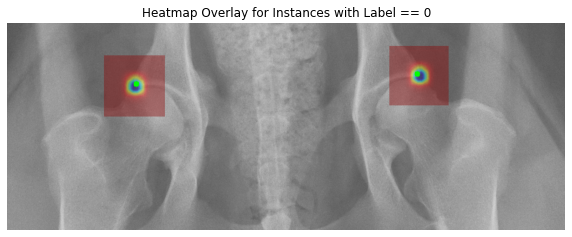

In [24]:
original_img = cv2.imread(img_path)
original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
img_height, img_width = original_img.shape[:2]

# 复制原图作为叠加的基础
overlay = original_img.copy()

# 遍历每个 pose 结果
for idx, result in enumerate(pose_results):
    # 获取当前边界框
    bbox = bboxes[idx]
    x1, y1, x2, y2 = bbox
    bbox_width, bbox_height = x2 - x1, y2 - y1

    # 获取对应的热力图并调整大小
    heatmap = result._pred_heatmaps.heatmaps[0].cpu().numpy()  # 假设只有一个关键点
    heatmap_resized = cv2.resize(heatmap, (bbox_width, bbox_height))

    # 归一化并转换为颜色映射
    heatmap_normalized = cv2.normalize(heatmap_resized, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    heatmap_colored = cv2.applyColorMap(heatmap_normalized, cv2.COLORMAP_JET)

    # 将热力图叠加到边界框的区域上
    overlay[y1:y2, x1:x2] = cv2.addWeighted(overlay[y1:y2, x1:x2], 0.6, heatmap_colored, 0.4, 0)

    # 获取关键点位置并绘制
    keypoints = result.pred_instances.keypoints[0]
    x, y = int(keypoints[0][0]), int(keypoints[0][1])
    cv2.circle(overlay, (x, y), radius=5, color=(0, 255, 0), thickness=-1)

# 显示结果
plt.figure(figsize=(10, 10))
plt.imshow(overlay)
plt.title("Heatmap Overlay for Instances with Label == 0")
plt.axis('off')
plt.show()

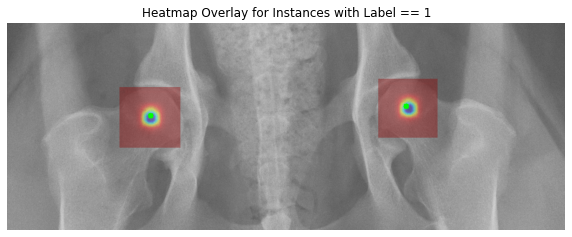

In [25]:
pred_instance = detect_result.pred_instances.cpu().numpy()
bboxes = np.concatenate((pred_instance.bboxes, pred_instance.scores[:, None]), axis=1)
bboxes = bboxes[np.logical_and(pred_instance.labels == 1, pred_instance.scores > CONF_THRES)]
bboxes = bboxes[nms(bboxes, 0.3)][:, :4].astype('int')
pose_results = inference_topdown(pose_estimator, img_path, bboxes)

original_img = cv2.imread(img_path)
original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
img_height, img_width = original_img.shape[:2]

# 复制原图作为叠加的基础
overlay = original_img.copy()

# 遍历每个 pose 结果
for idx, result in enumerate(pose_results):
    # 获取当前边界框
    bbox = bboxes[idx]
    x1, y1, x2, y2 = bbox
    bbox_width, bbox_height = x2 - x1, y2 - y1

    # 获取对应的热力图并调整大小
    heatmap = result._pred_heatmaps.heatmaps[0].cpu().numpy()  # 假设只有一个关键点
    heatmap_resized = cv2.resize(heatmap, (bbox_width, bbox_height))

    # 归一化并转换为颜色映射
    heatmap_normalized = cv2.normalize(heatmap_resized, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    heatmap_colored = cv2.applyColorMap(heatmap_normalized, cv2.COLORMAP_JET)

    # 将热力图叠加到边界框的区域上
    overlay[y1:y2, x1:x2] = cv2.addWeighted(overlay[y1:y2, x1:x2], 0.6, heatmap_colored, 0.4, 0)

    # 获取关键点位置并绘制
    keypoints = result.pred_instances.keypoints[0]
    x, y = int(keypoints[0][0]), int(keypoints[0][1])
    cv2.circle(overlay, (x, y), radius=5, color=(0, 255, 0), thickness=-1)

# 显示结果
plt.figure(figsize=(10, 10))
plt.imshow(overlay)
plt.title("Heatmap Overlay for Instances with Label == 1")
plt.axis('off')
plt.show()

Processing /home/featurize/work/Dataset2/data/Testing/Images/340563.jpeg


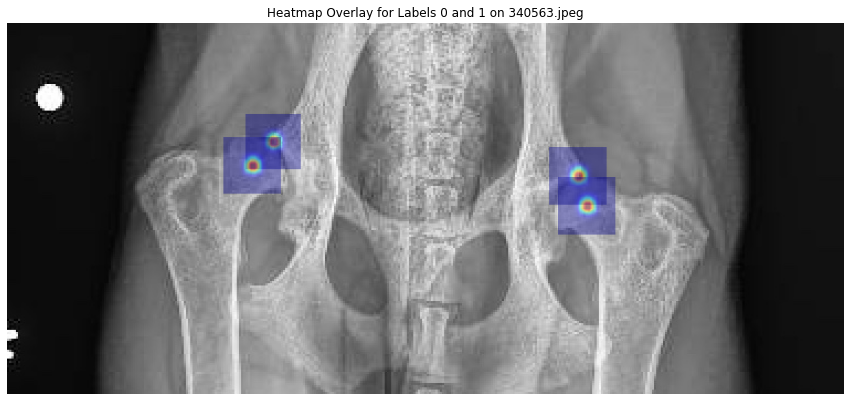

Processing /home/featurize/work/Dataset2/data/Testing/Images/359971.jpeg


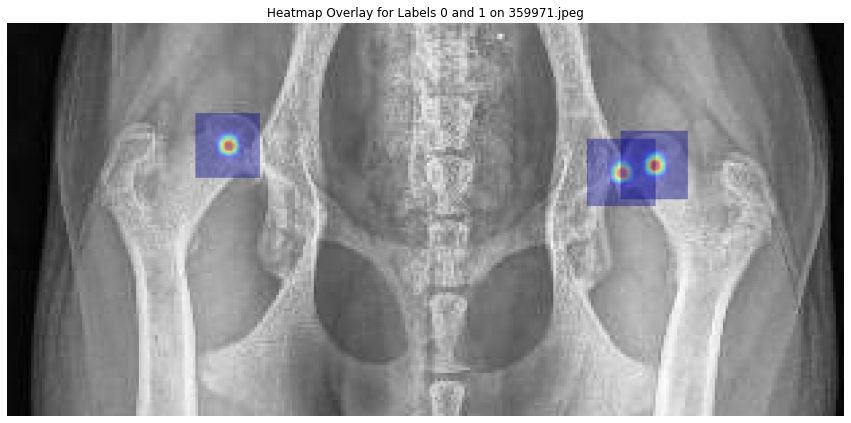

Processing /home/featurize/work/Dataset2/data/Testing/Images/328949.jpeg


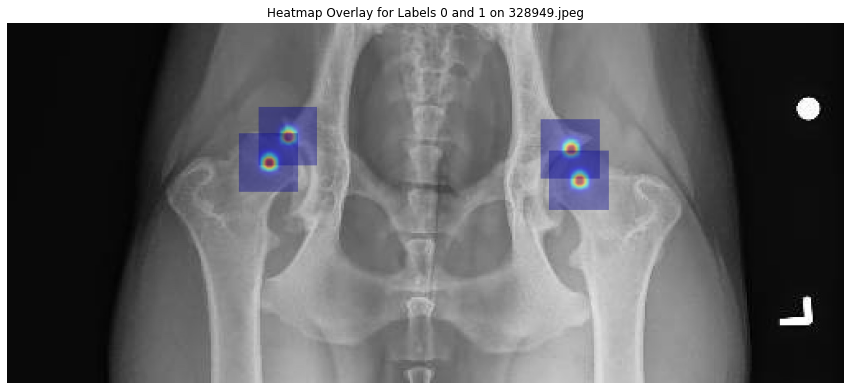

Processing /home/featurize/work/Dataset2/data/Testing/Images/348742.jpeg


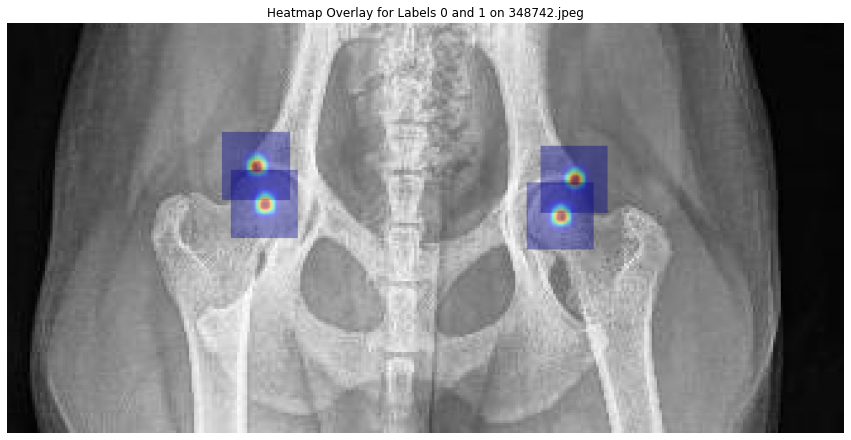

Processing /home/featurize/work/Dataset2/data/Testing/Images/355767.jpeg


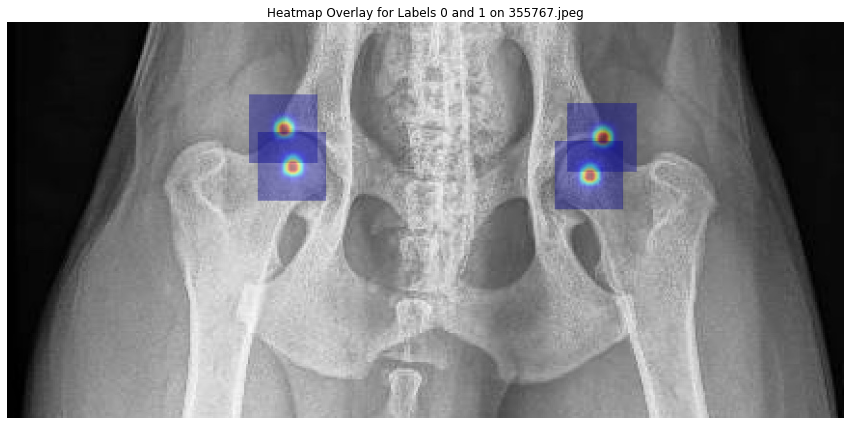

Processing /home/featurize/work/Dataset2/data/Testing/Images/353517.jpeg


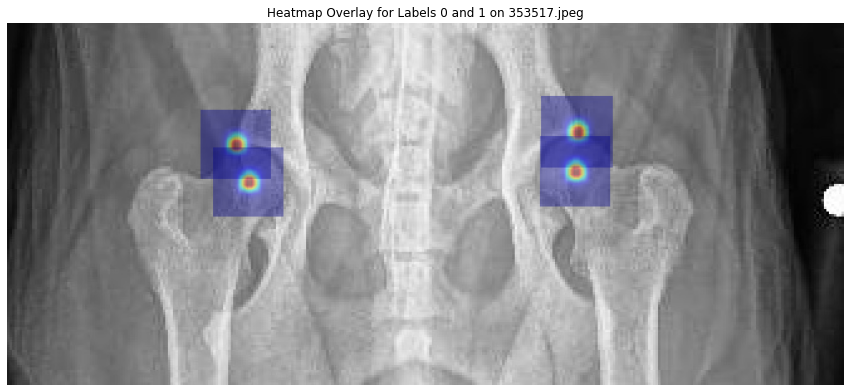

Processing /home/featurize/work/Dataset2/data/Testing/Images/355524.jpeg


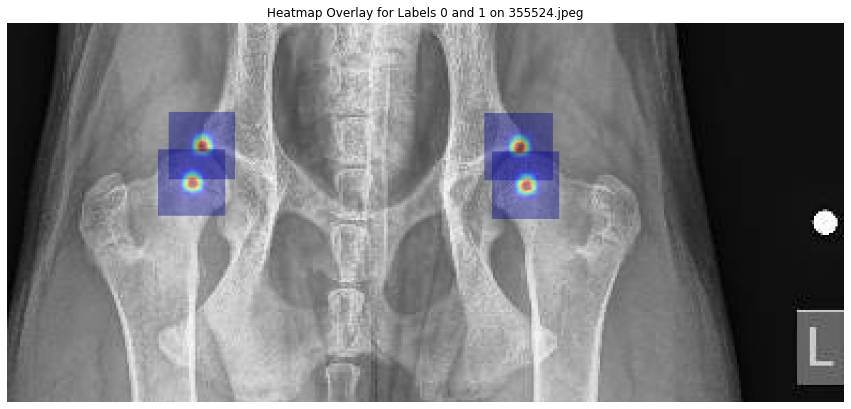

Processing /home/featurize/work/Dataset2/data/Testing/Images/358587.jpeg


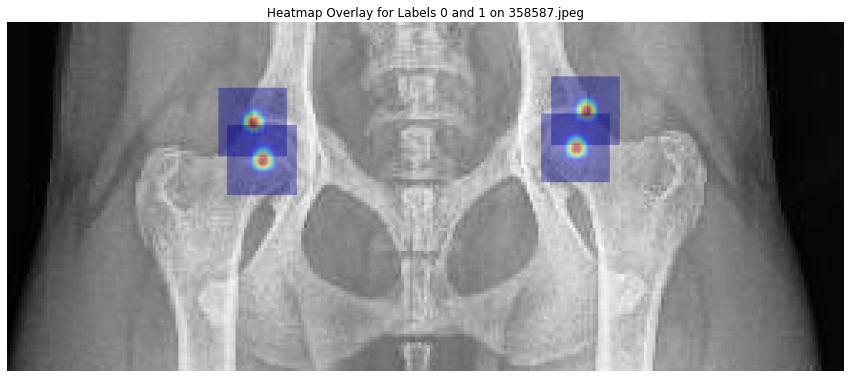

Processing /home/featurize/work/Dataset2/data/Testing/Images/355223.jpeg


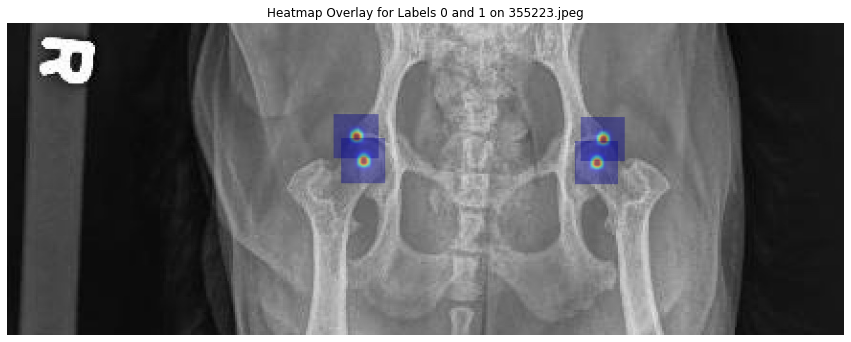

Processing /home/featurize/work/Dataset2/data/Testing/Images/264113.jpeg


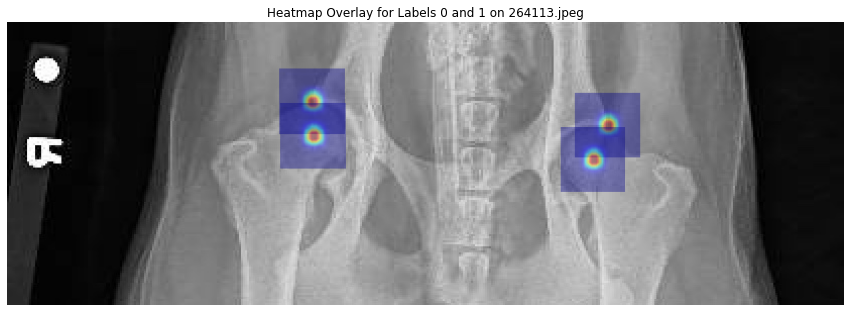

Processing /home/featurize/work/Dataset2/data/Testing/Images/365780.jpeg


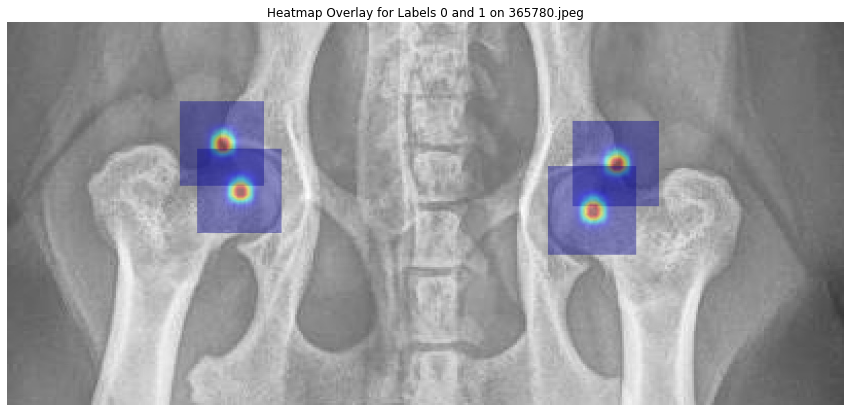

Processing /home/featurize/work/Dataset2/data/Testing/Images/360388.jpeg


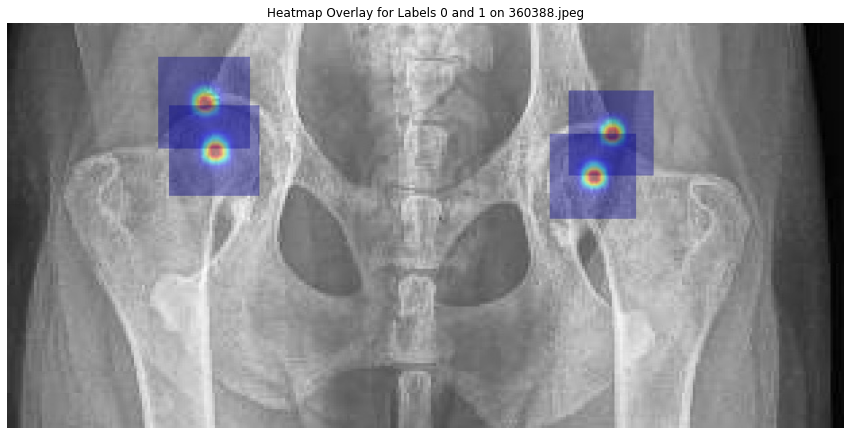

Processing /home/featurize/work/Dataset2/data/Testing/Images/246775.jpeg


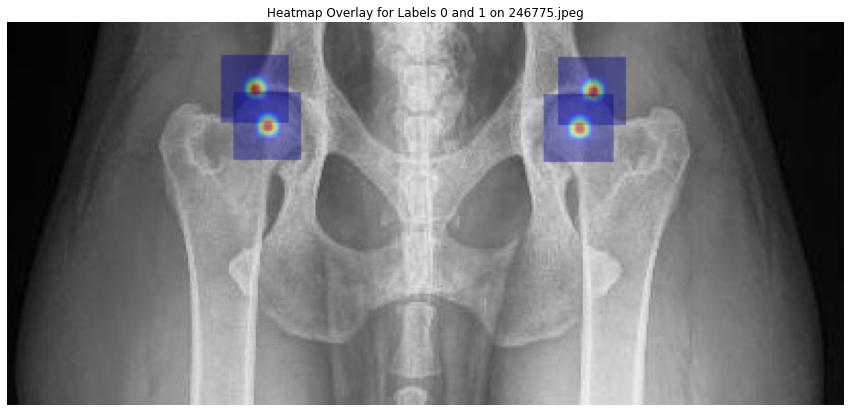

Processing /home/featurize/work/Dataset2/data/Testing/Images/361492.jpeg


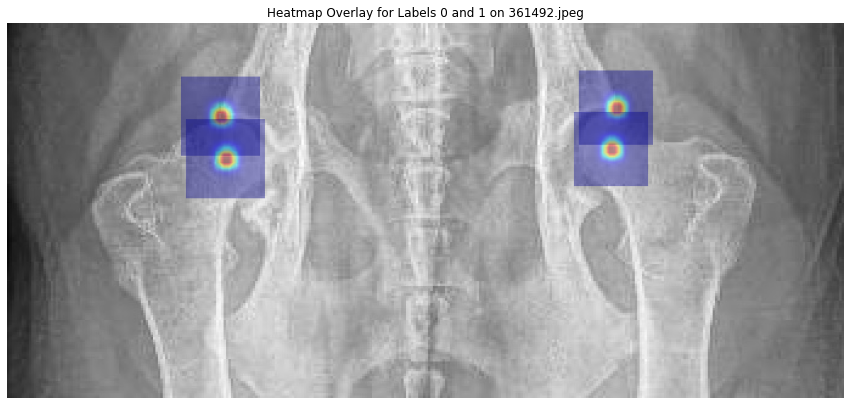

Processing /home/featurize/work/Dataset2/data/Testing/Images/336938.jpeg


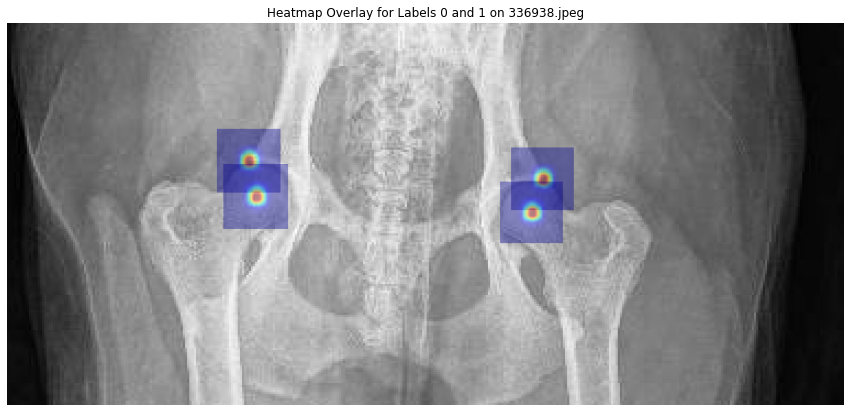

Processing /home/featurize/work/Dataset2/data/Testing/Images/358275.jpeg


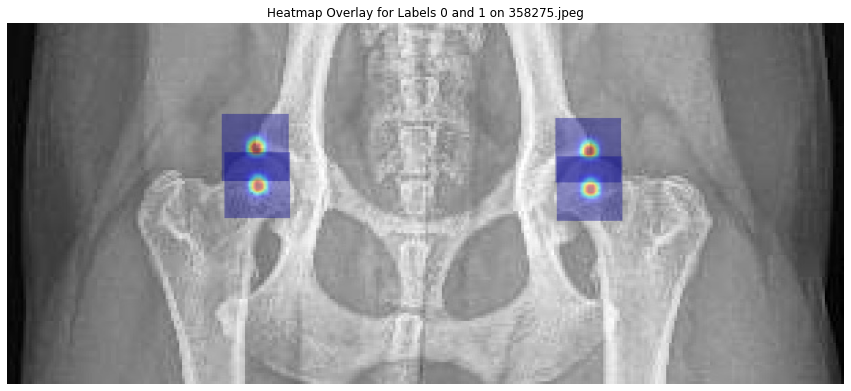

Processing /home/featurize/work/Dataset2/data/Testing/Images/364394.jpeg


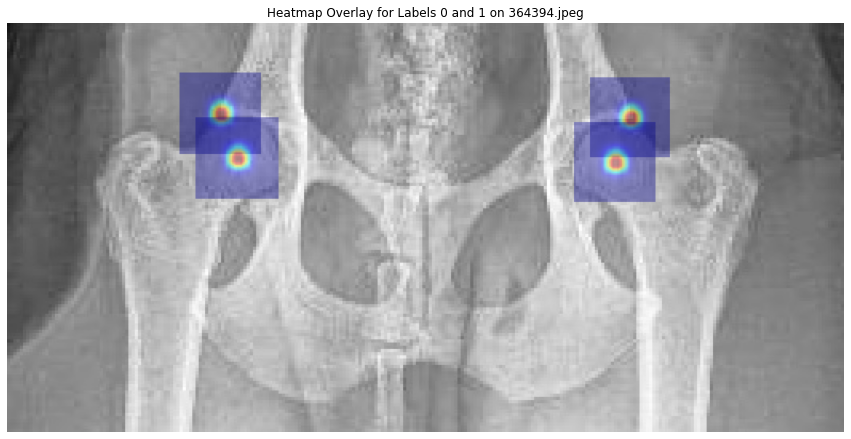

Processing /home/featurize/work/Dataset2/data/Testing/Images/353262.jpg


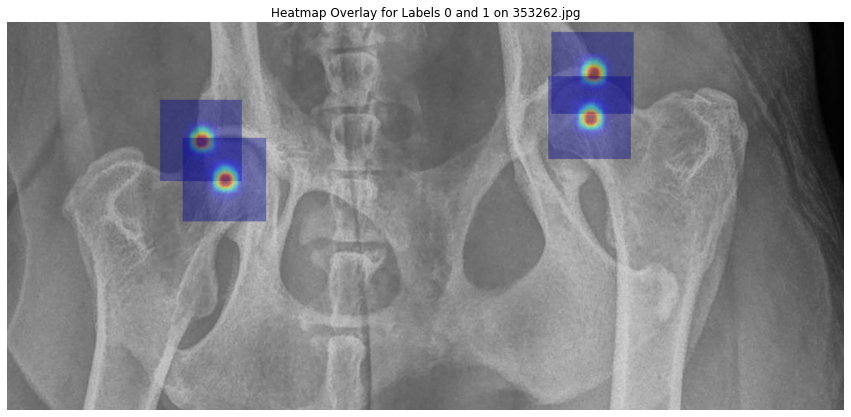

Processing /home/featurize/work/Dataset2/data/Testing/Images/359216.jpeg


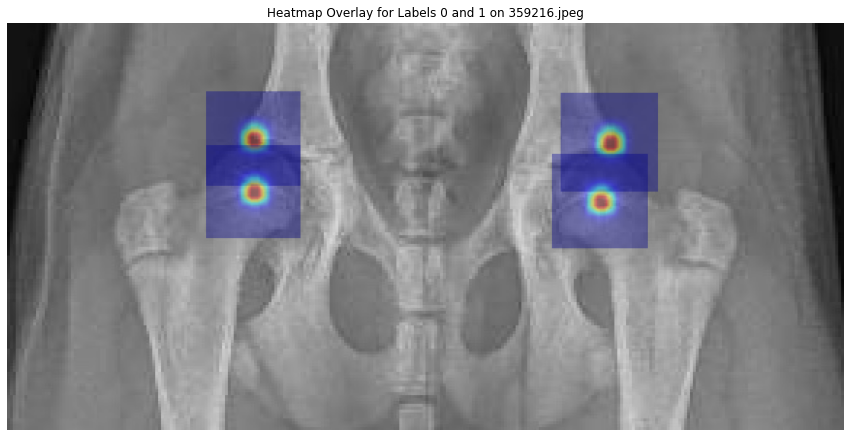

Processing /home/featurize/work/Dataset2/data/Testing/Images/352697.jpeg


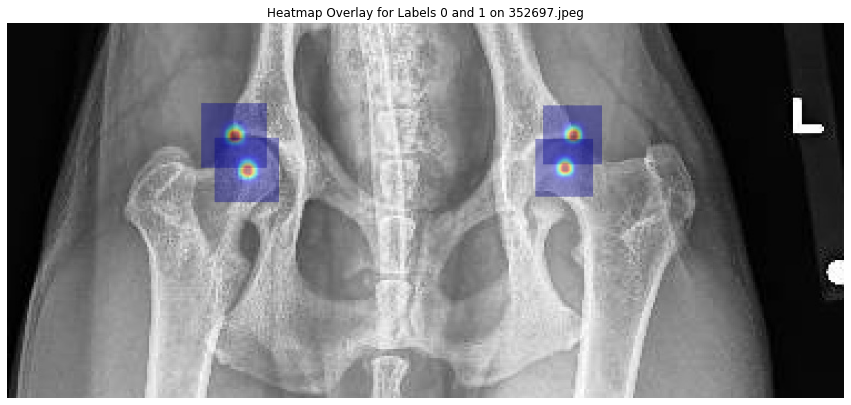

Processing /home/featurize/work/Dataset2/data/Testing/Images/359792.jpeg


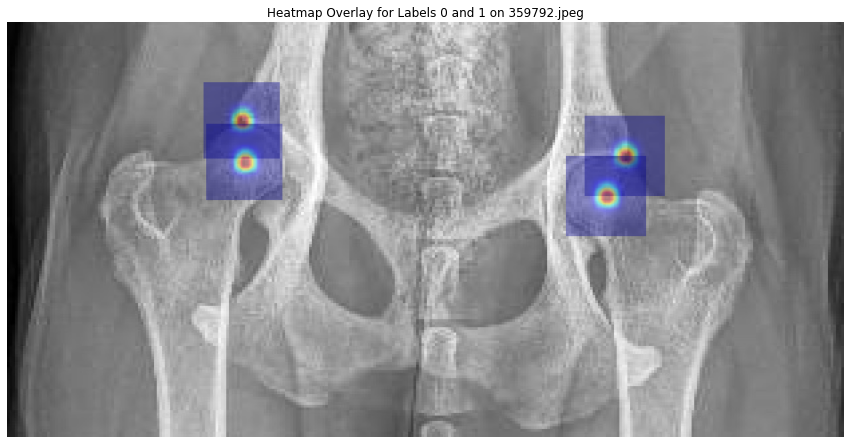

Processing /home/featurize/work/Dataset2/data/Testing/Images/360132.jpeg


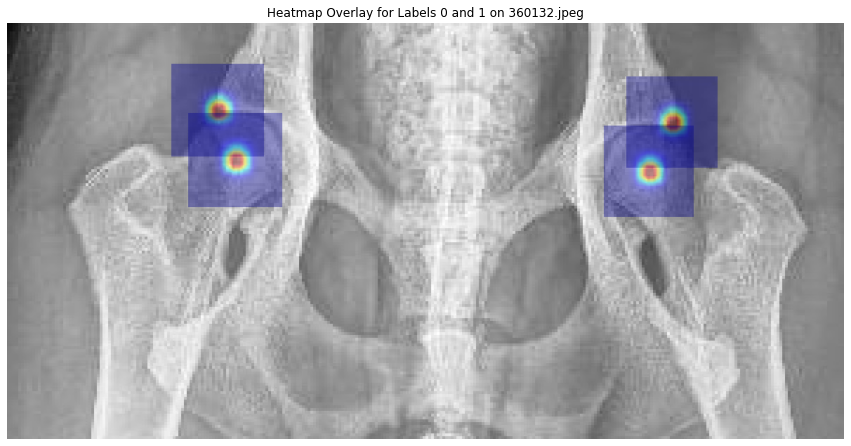

Processing /home/featurize/work/Dataset2/data/Testing/Images/251256.jpg


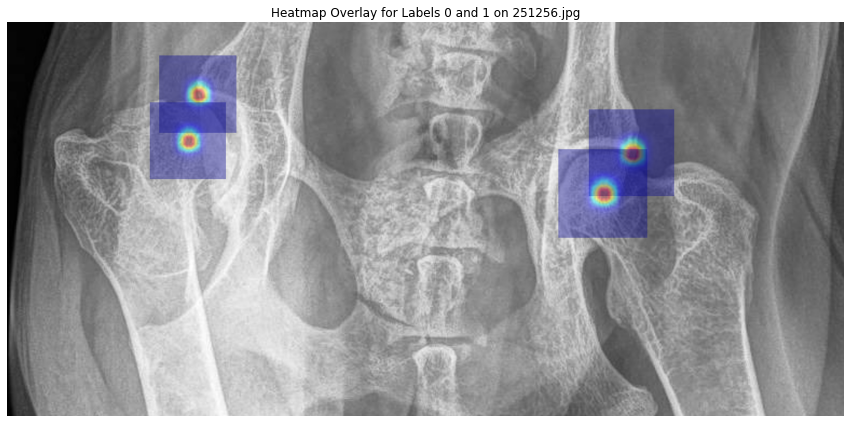

Processing /home/featurize/work/Dataset2/data/Testing/Images/350186.jpeg


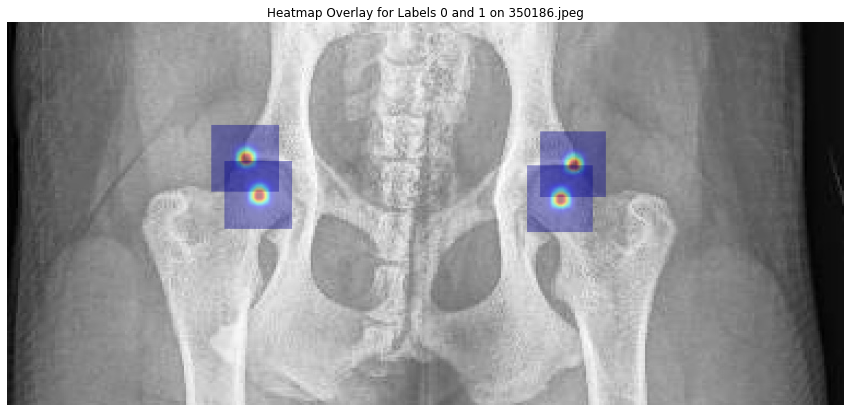

Processing /home/featurize/work/Dataset2/data/Testing/Images/367031.jpg


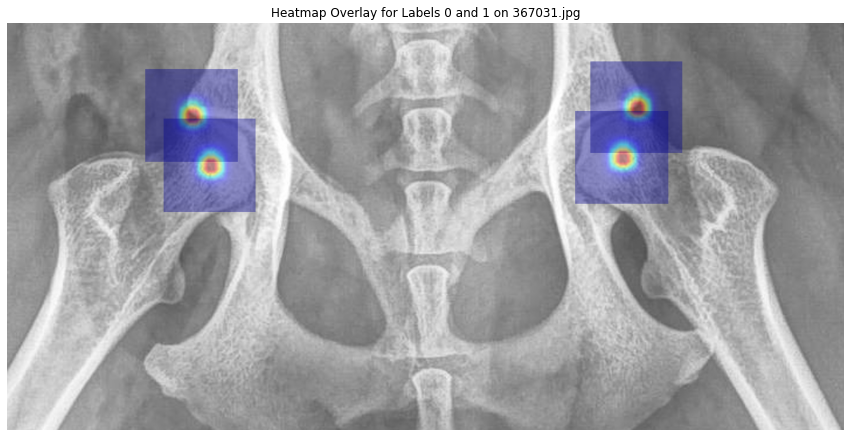

Processing /home/featurize/work/Dataset2/data/Testing/Images/348064.jpeg


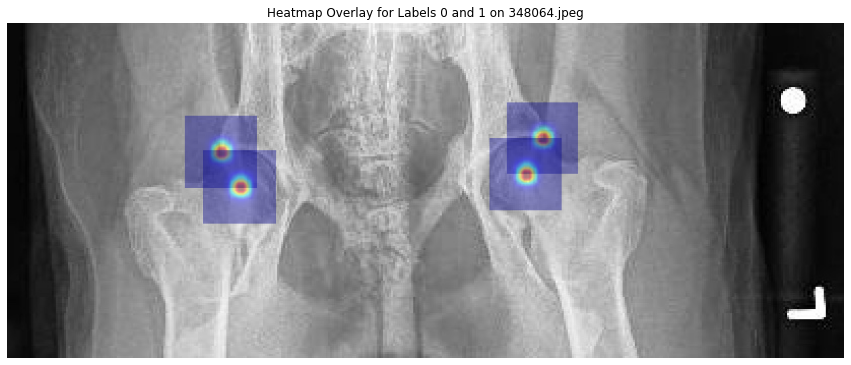

Processing /home/featurize/work/Dataset2/data/Testing/Images/337935.jpeg


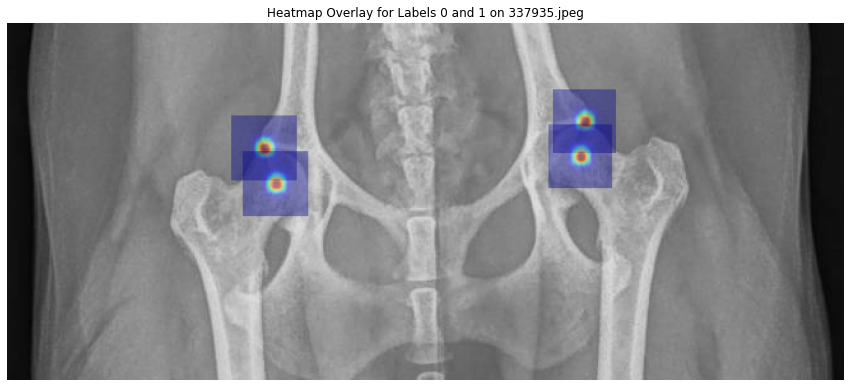

Processing /home/featurize/work/Dataset2/data/Testing/Images/360778.jpeg


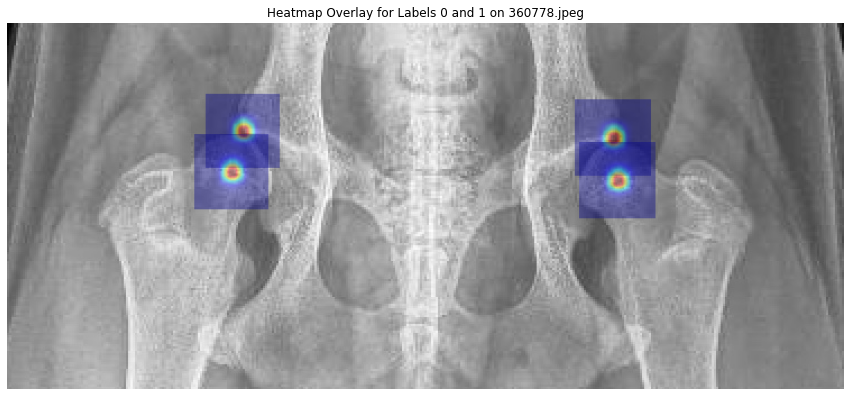

Processing /home/featurize/work/Dataset2/data/Testing/Images/204964.jpg


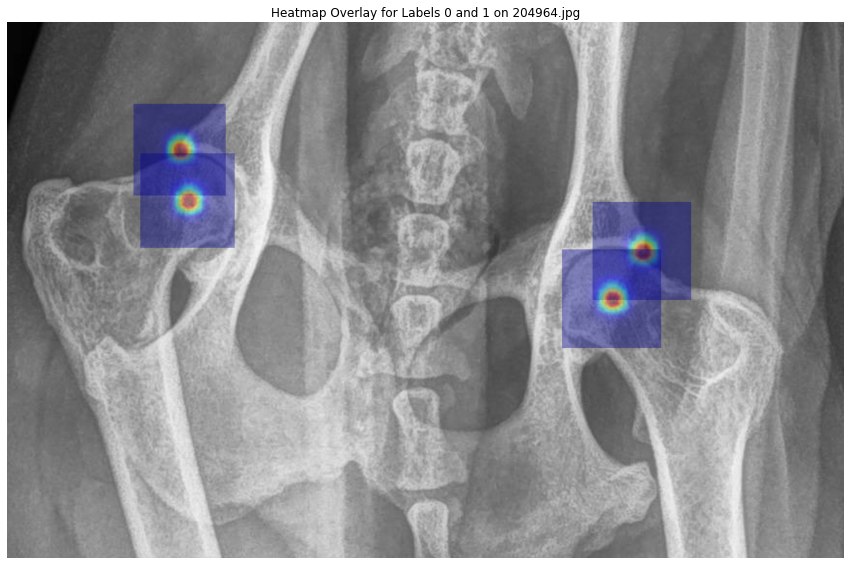

Processing /home/featurize/work/Dataset2/data/Testing/Images/357039.jpeg


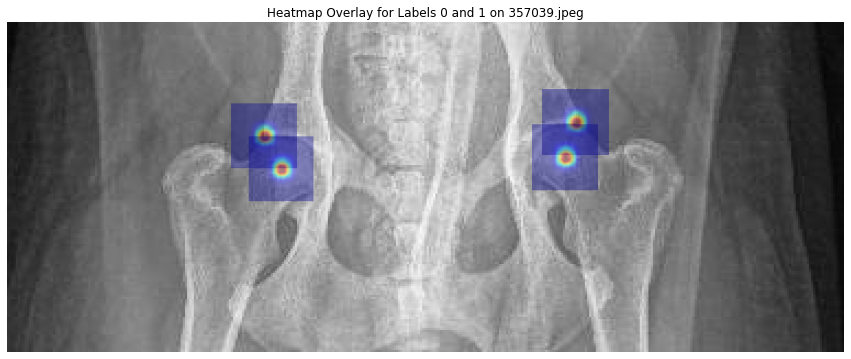

Processing /home/featurize/work/Dataset2/data/Testing/Images/261359.jpeg


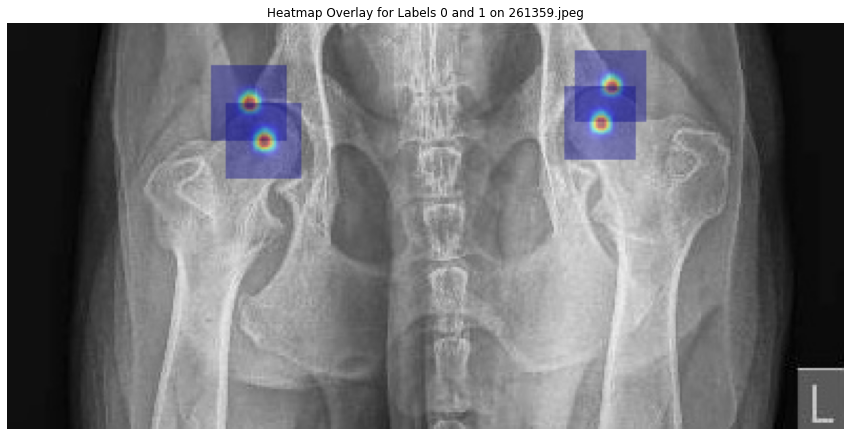

Processing /home/featurize/work/Dataset2/data/Testing/Images/363515.jpeg


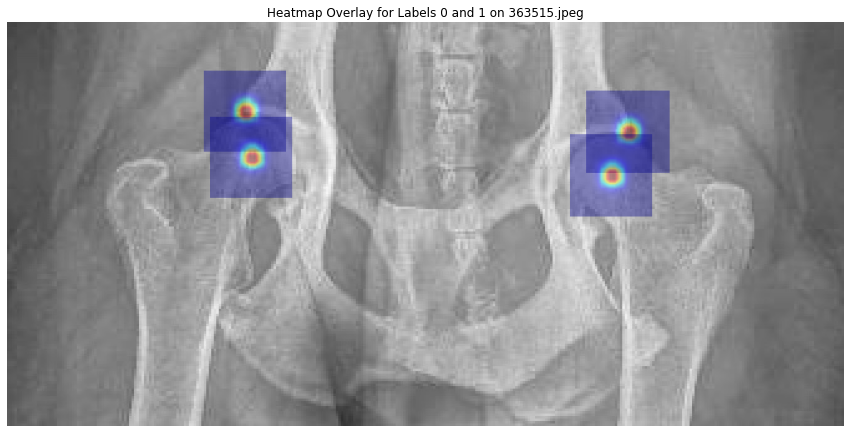

Processing /home/featurize/work/Dataset2/data/Testing/Images/359626.jpeg


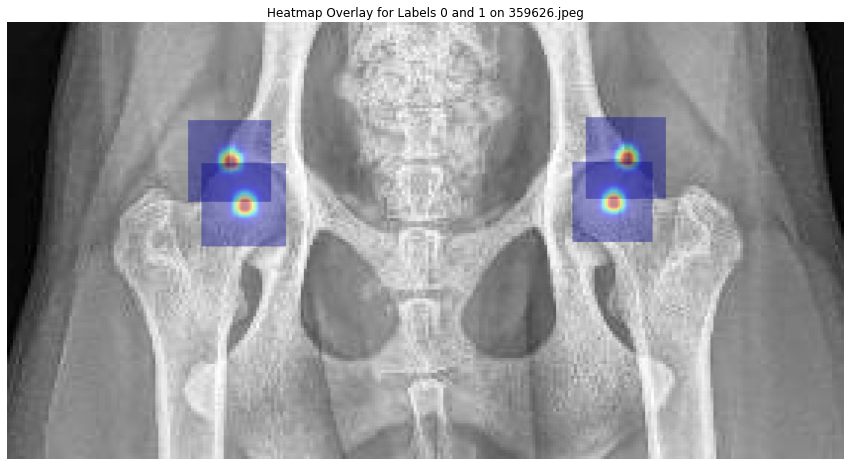

Processing /home/featurize/work/Dataset2/data/Testing/Images/341649.jpeg


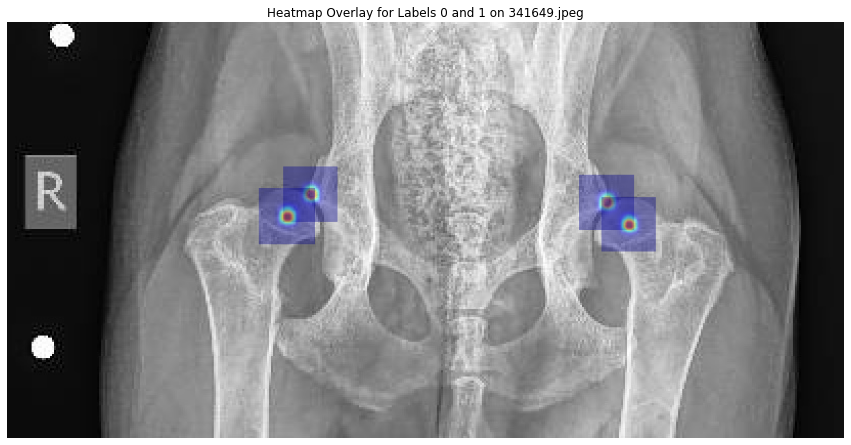

Processing /home/featurize/work/Dataset2/data/Testing/Images/348002.jpeg


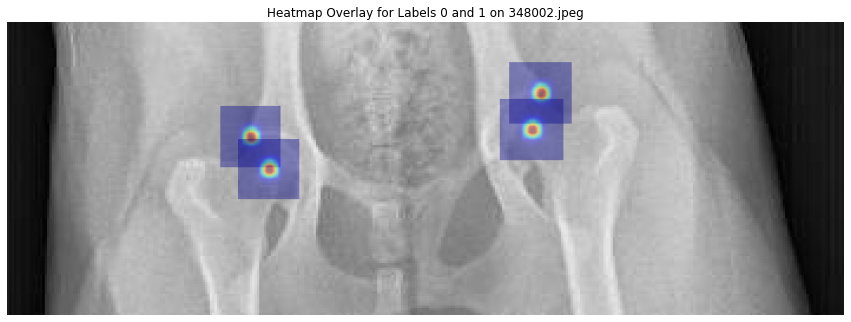

Processing /home/featurize/work/Dataset2/data/Testing/Images/359782.jpeg


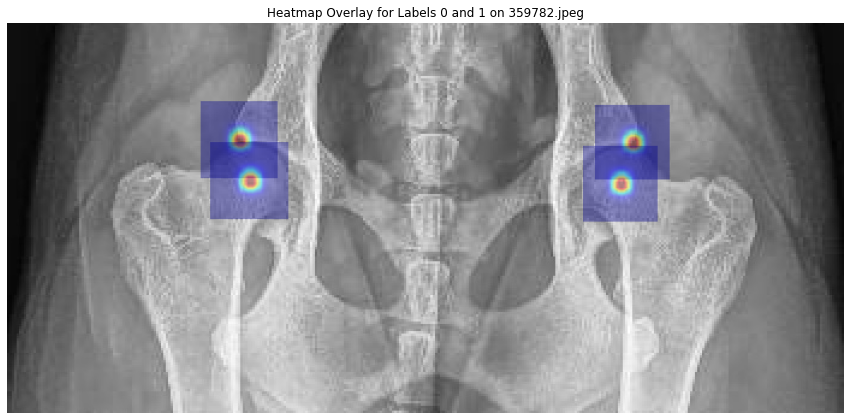

Processing /home/featurize/work/Dataset2/data/Testing/Images/270257.jpeg


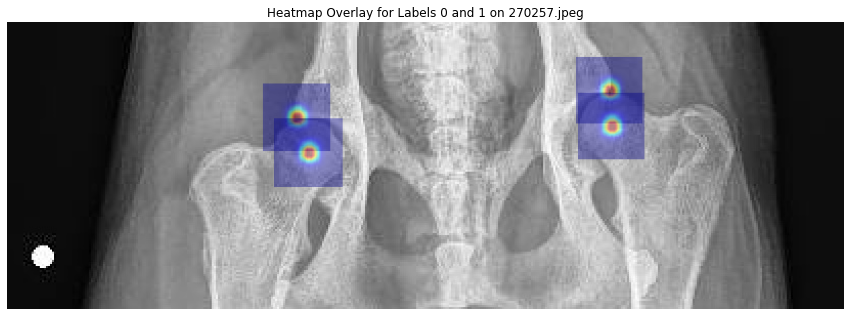

Processing /home/featurize/work/Dataset2/data/Testing/Images/350556.jpeg


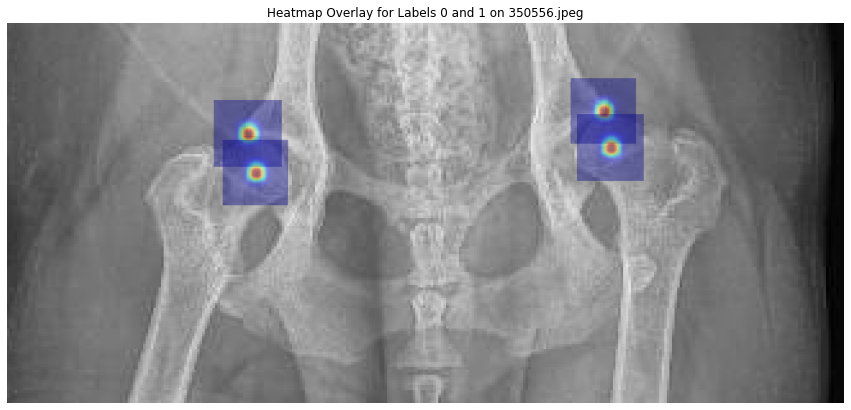

Processing /home/featurize/work/Dataset2/data/Testing/Images/360678.jpg


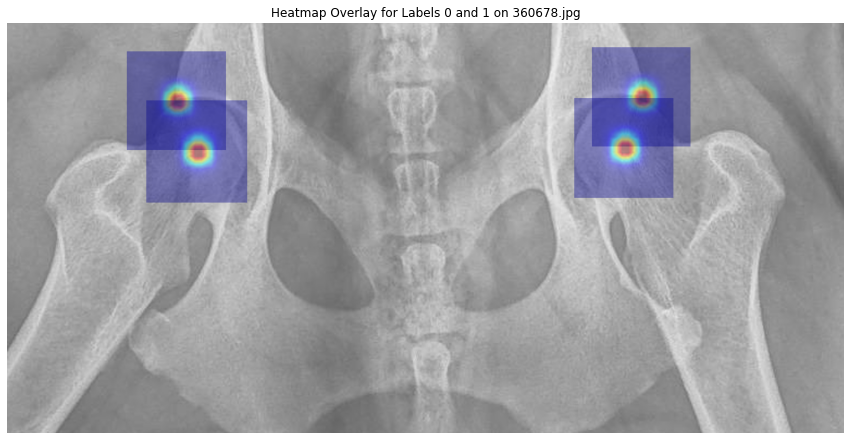

Processing /home/featurize/work/Dataset2/data/Testing/Images/364276.jpeg


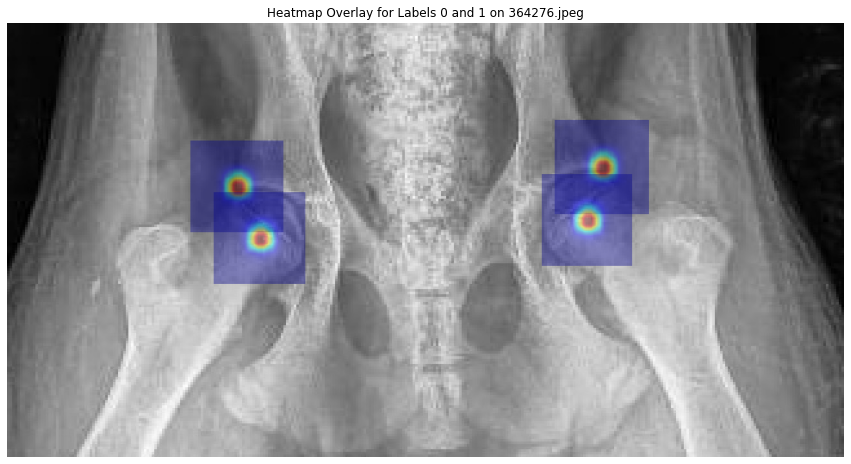

Processing /home/featurize/work/Dataset2/data/Testing/Images/349607.jpeg


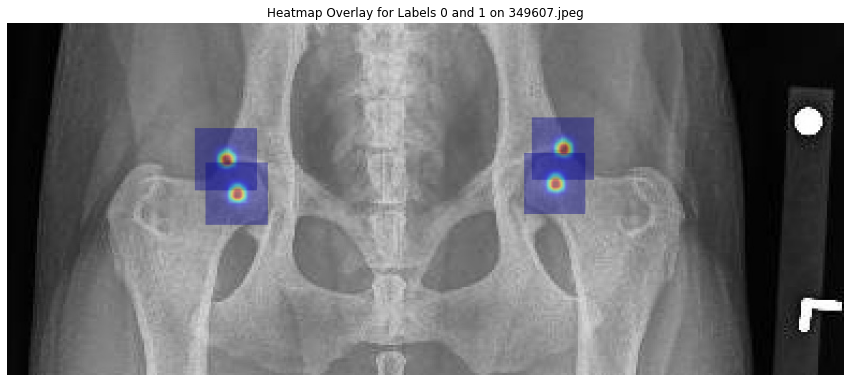

Processing /home/featurize/work/Dataset2/data/Testing/Images/302735.jpeg


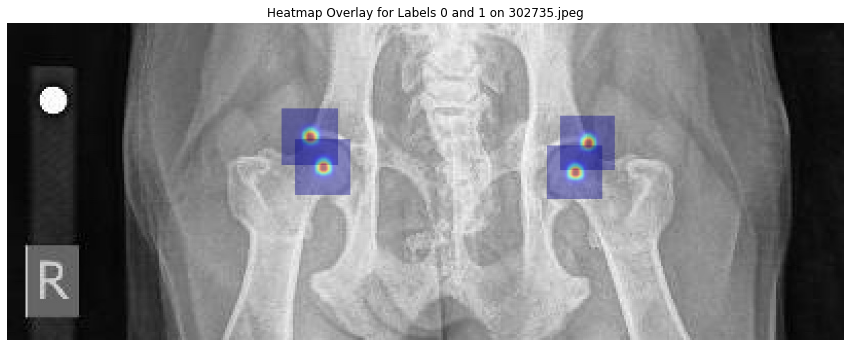

Processing /home/featurize/work/Dataset2/data/Testing/Images/361188.jpeg


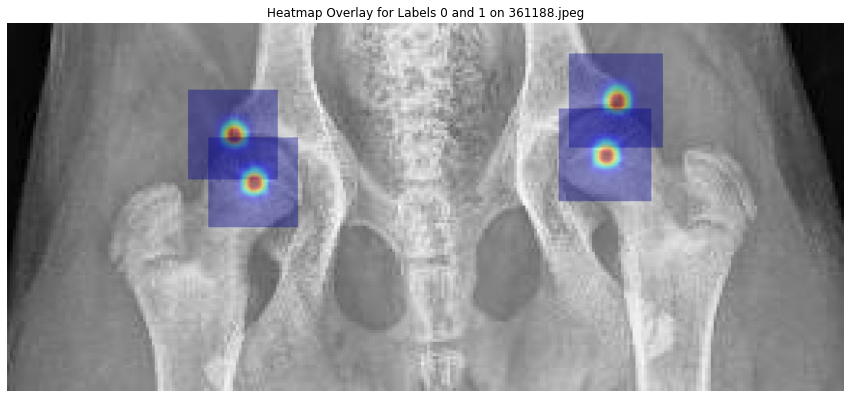

Processing /home/featurize/work/Dataset2/data/Testing/Images/335450.jpeg


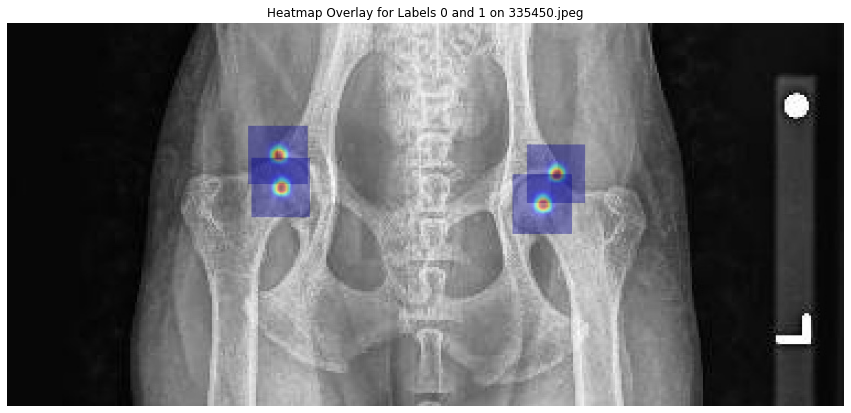

Processing /home/featurize/work/Dataset2/data/Testing/Images/352456.jpeg


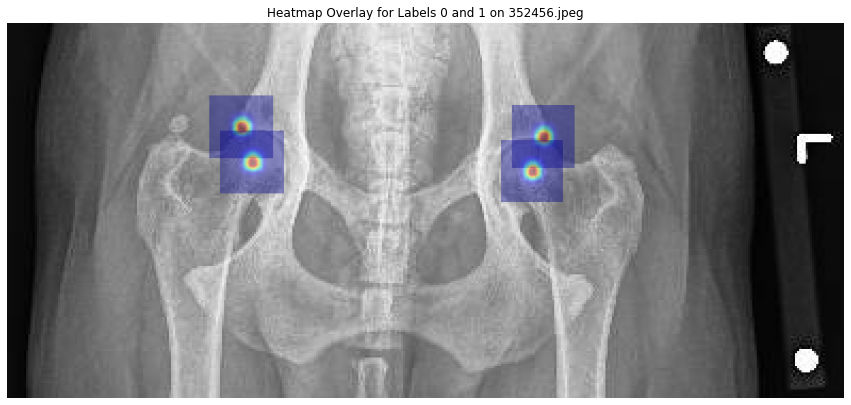

Processing /home/featurize/work/Dataset2/data/Testing/Images/314200.jpeg


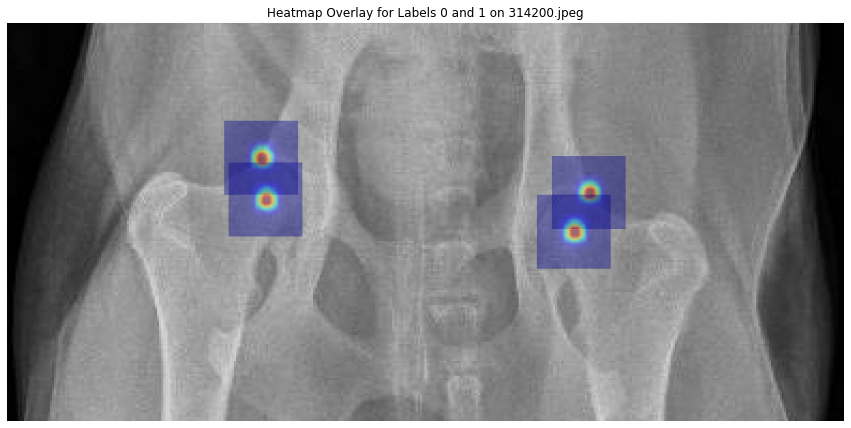

Processing /home/featurize/work/Dataset2/data/Testing/Images/351971.jpg


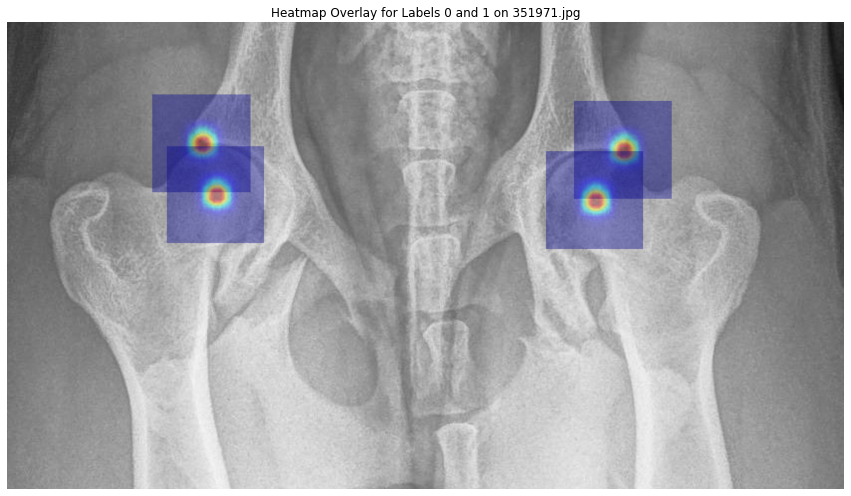

Processing /home/featurize/work/Dataset2/data/Testing/Images/339041.jpeg


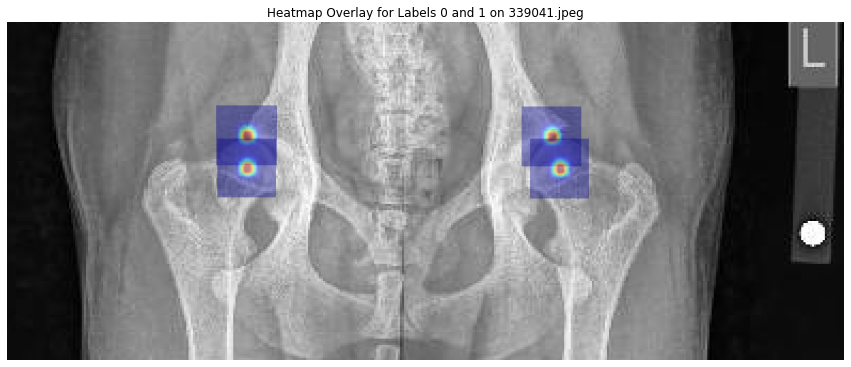

Processing /home/featurize/work/Dataset2/data/Testing/Images/332727.jpeg


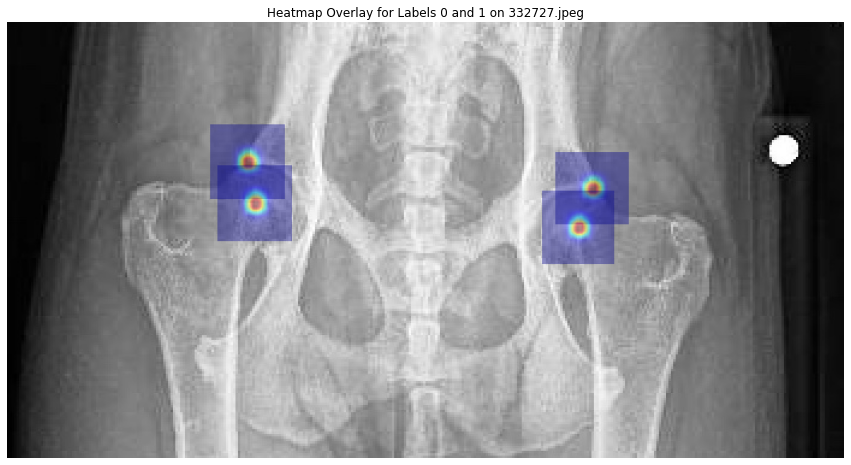

Processing /home/featurize/work/Dataset2/data/Testing/Images/351666.jpg


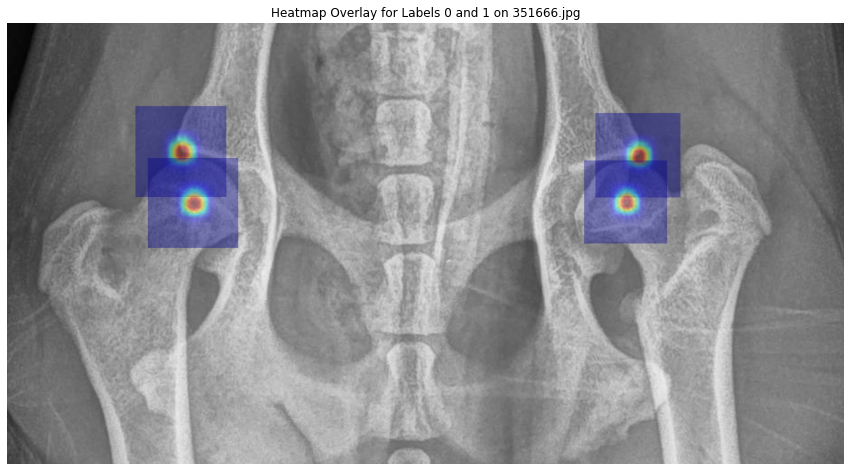

Processing /home/featurize/work/Dataset2/data/Testing/Images/351294.jpeg


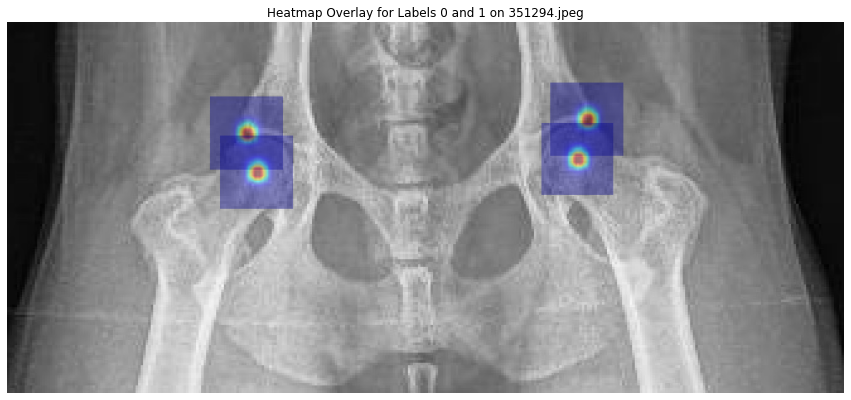

Processing /home/featurize/work/Dataset2/data/Testing/Images/288625.jpeg


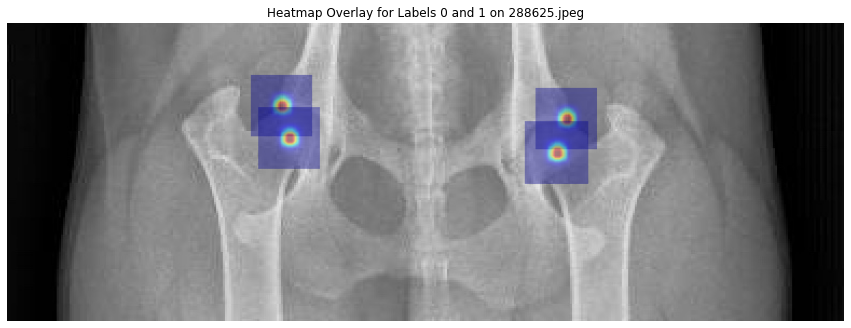

Processing /home/featurize/work/Dataset2/data/Testing/Images/357332.jpeg


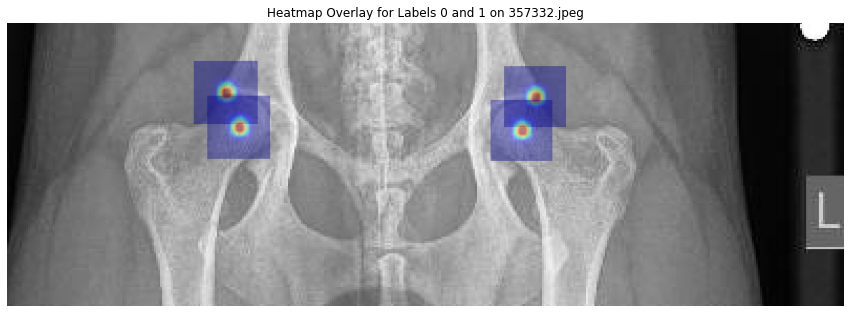

Processing /home/featurize/work/Dataset2/data/Testing/Images/345281.jpeg


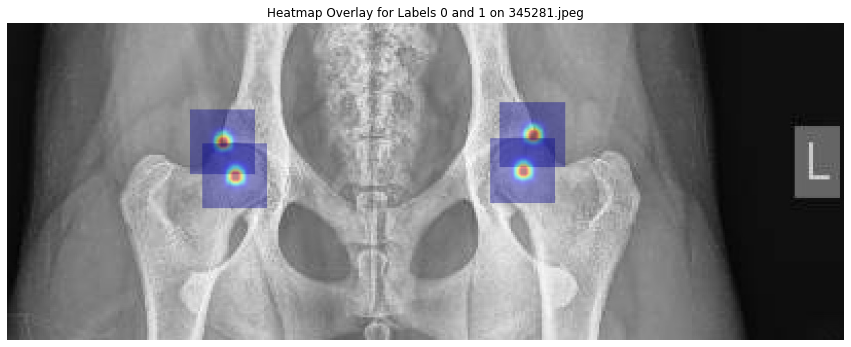

Processing /home/featurize/work/Dataset2/data/Testing/Images/364123.jpeg


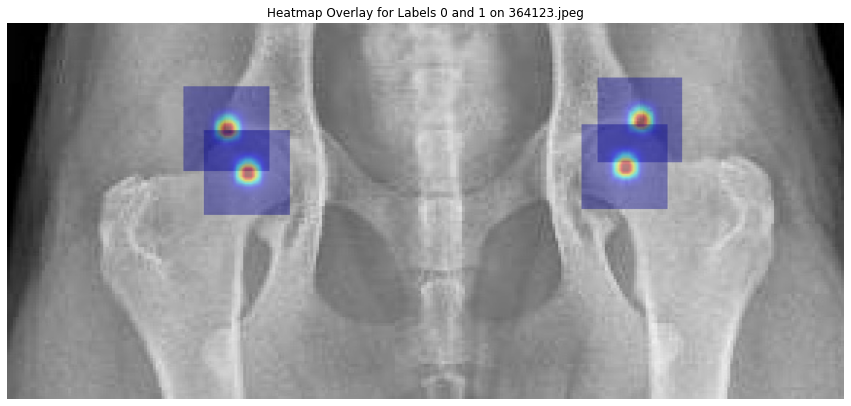

Processing /home/featurize/work/Dataset2/data/Testing/Images/332635.jpeg


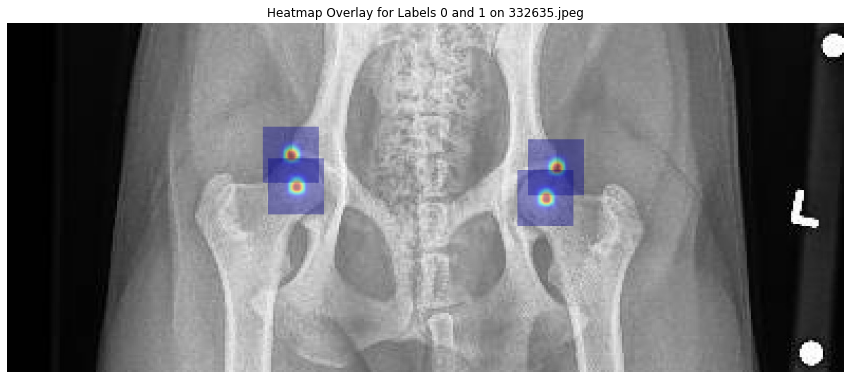

Processing /home/featurize/work/Dataset2/data/Testing/Images/355423.jpeg


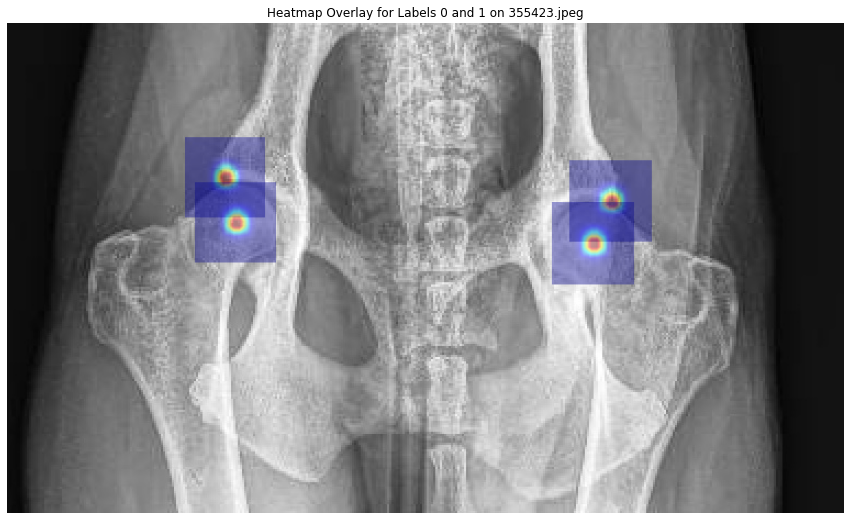

Processing /home/featurize/work/Dataset2/data/Testing/Images/360391.jpeg


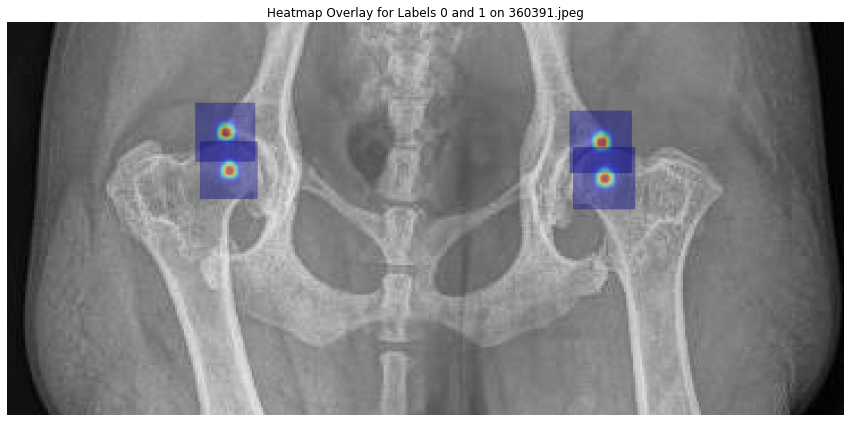

Processing /home/featurize/work/Dataset2/data/Testing/Images/366863.jpeg


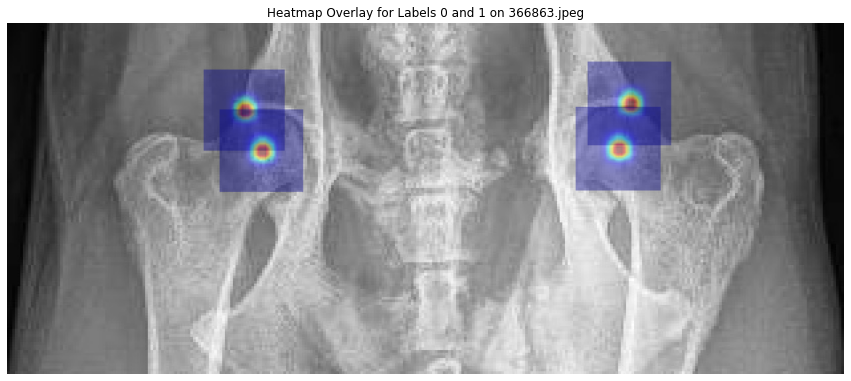

Processing /home/featurize/work/Dataset2/data/Testing/Images/353028.jpeg


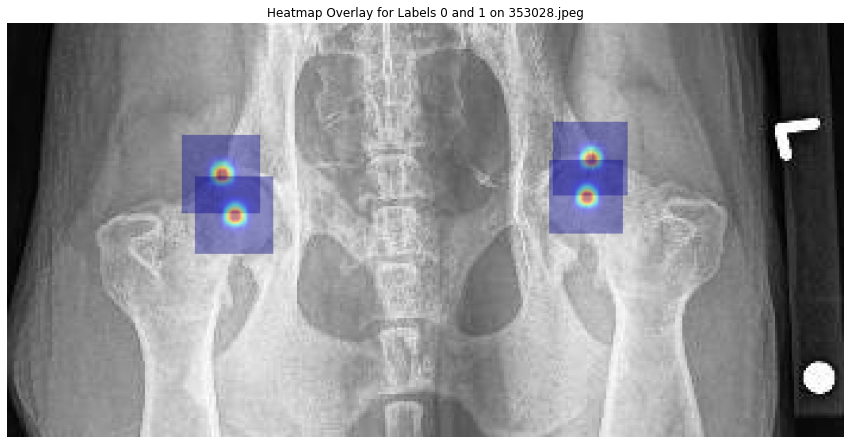

Processing /home/featurize/work/Dataset2/data/Testing/Images/358586.jpeg


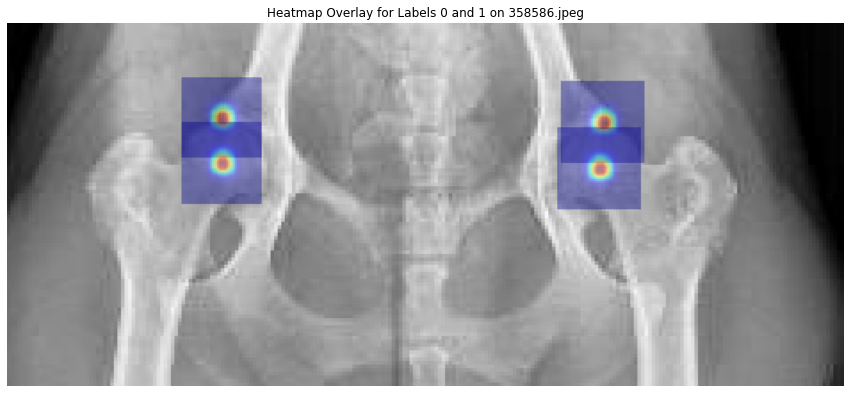

Processing /home/featurize/work/Dataset2/data/Testing/Images/357885.jpeg


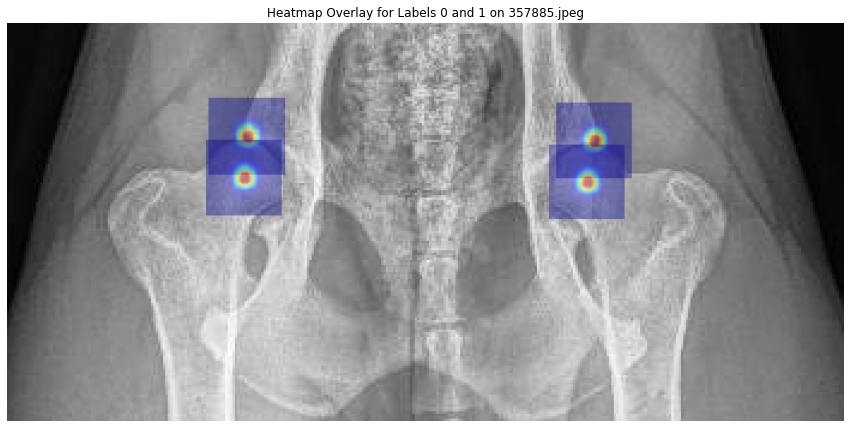

Processing /home/featurize/work/Dataset2/data/Testing/Images/360713.jpeg


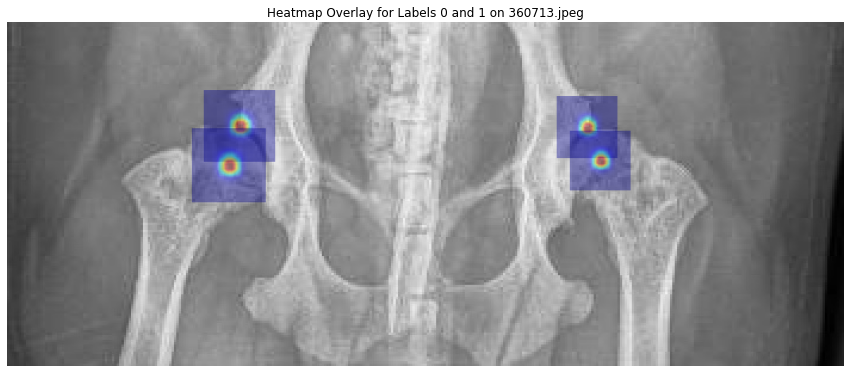

Processing /home/featurize/work/Dataset2/data/Testing/Images/355048.jpeg


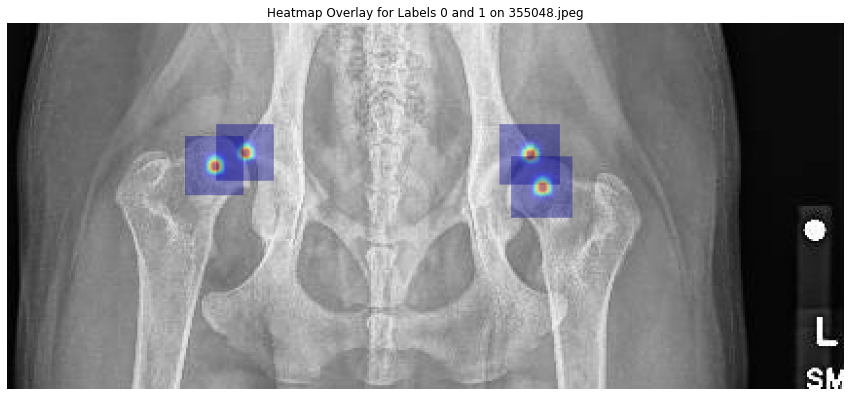

Processing /home/featurize/work/Dataset2/data/Testing/Images/328125.jpeg


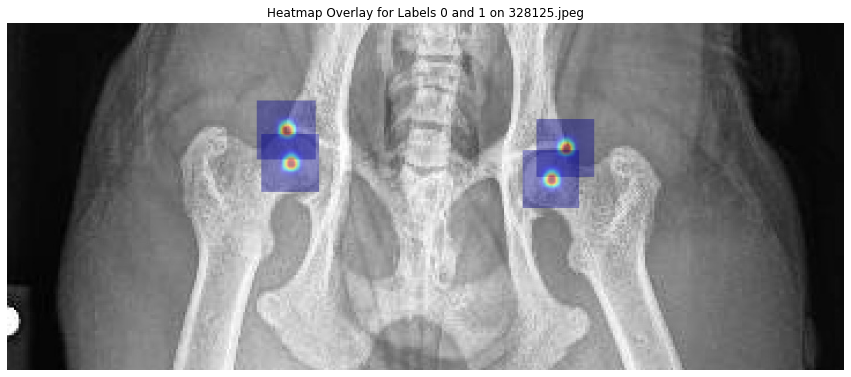

Processing /home/featurize/work/Dataset2/data/Testing/Images/366596.jpeg


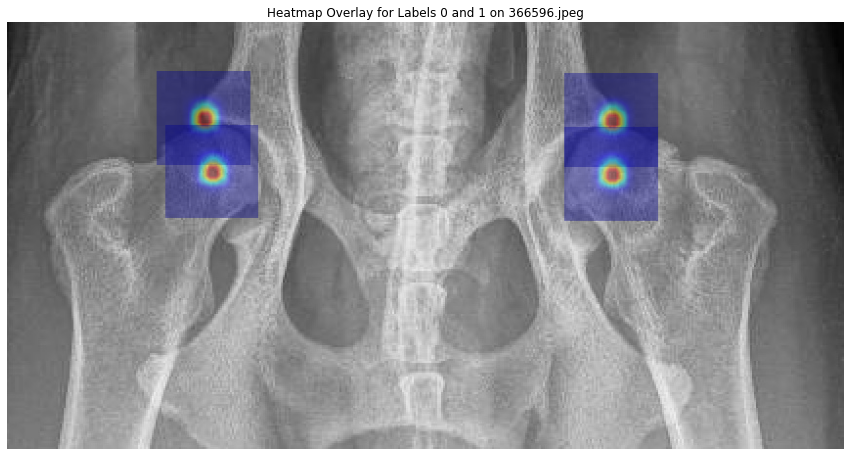

Processing /home/featurize/work/Dataset2/data/Testing/Images/274791.jpeg


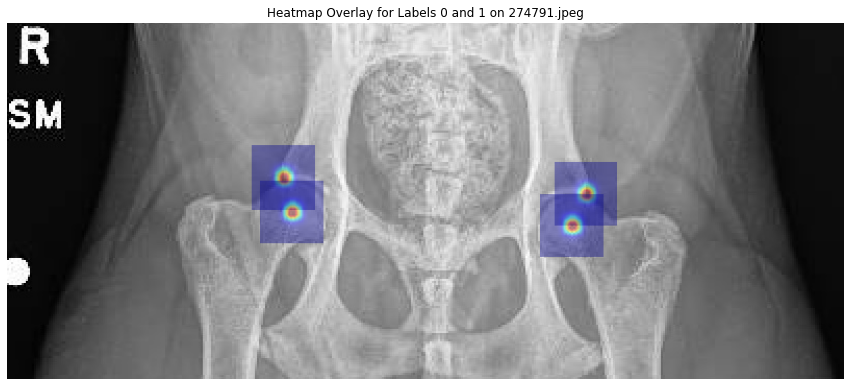

Processing /home/featurize/work/Dataset2/data/Testing/Images/361394.jpeg


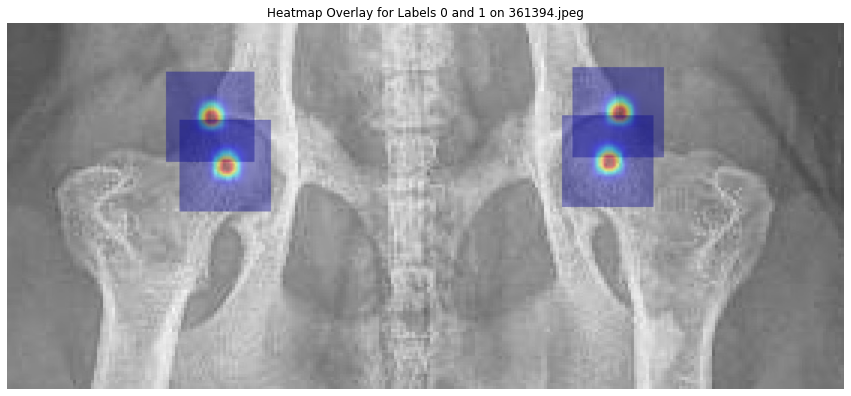

Processing /home/featurize/work/Dataset2/data/Testing/Images/355416.jpeg


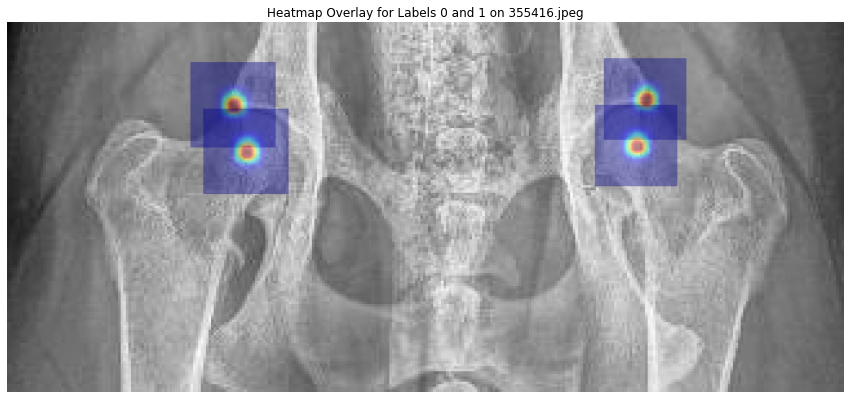

Processing /home/featurize/work/Dataset2/data/Testing/Images/361506.jpeg


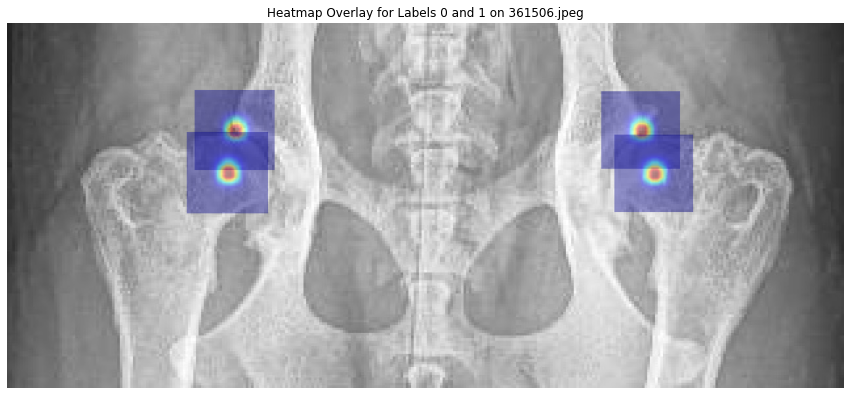

Processing /home/featurize/work/Dataset2/data/Testing/Images/354095.jpeg


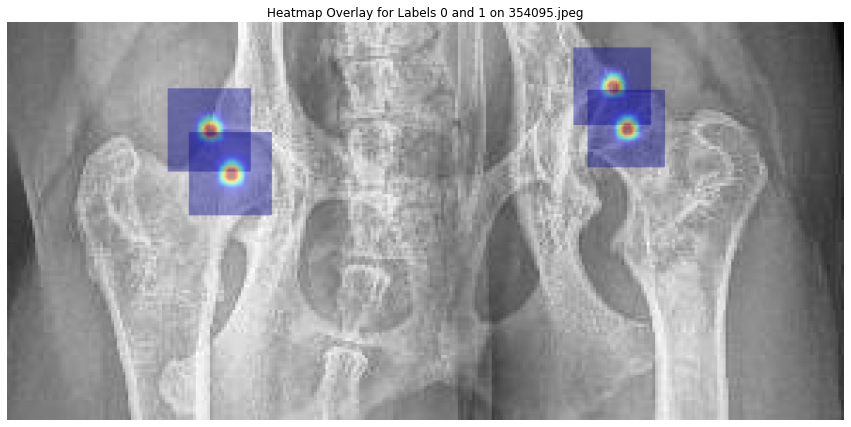

Processing /home/featurize/work/Dataset2/data/Testing/Images/331722.jpeg


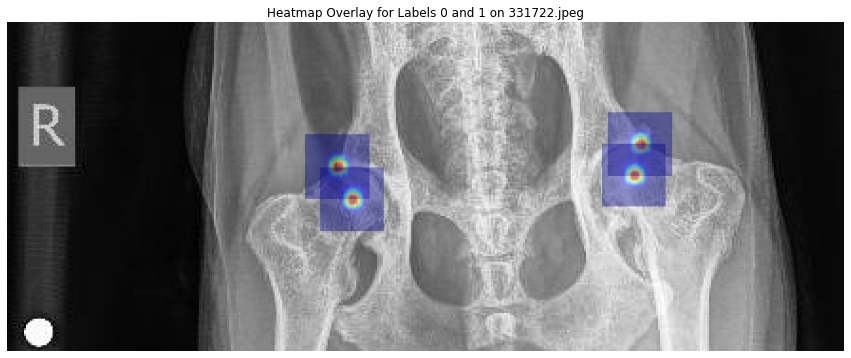

Processing /home/featurize/work/Dataset2/data/Testing/Images/353949.jpg


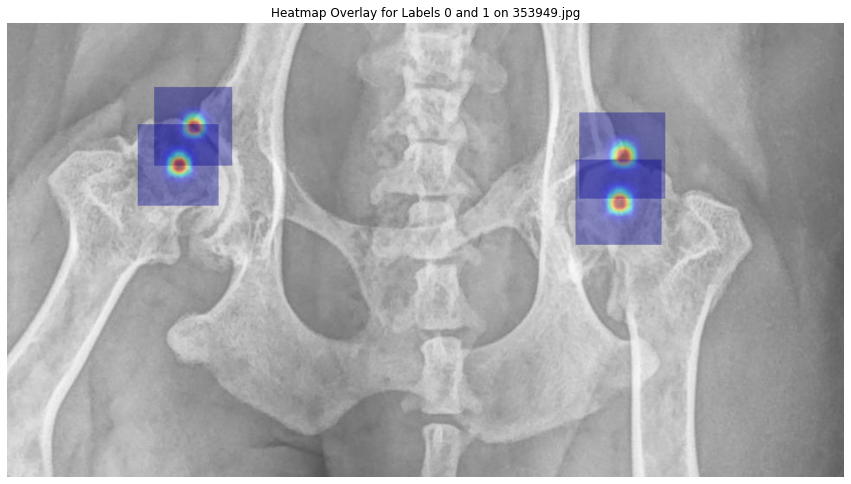

Processing /home/featurize/work/Dataset2/data/Testing/Images/351595.jpeg


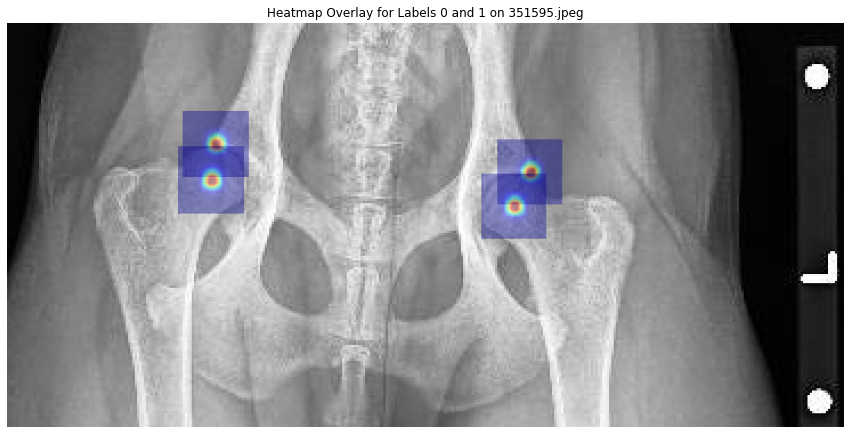

Processing /home/featurize/work/Dataset2/data/Testing/Images/349667.jpeg


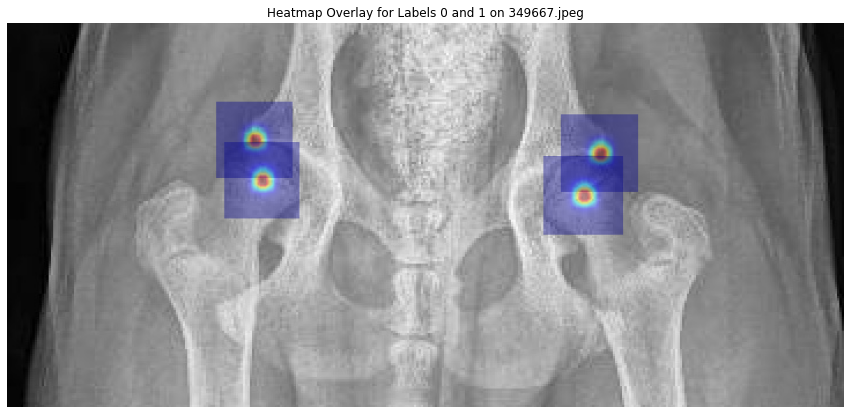

Processing /home/featurize/work/Dataset2/data/Testing/Images/353433.jpeg


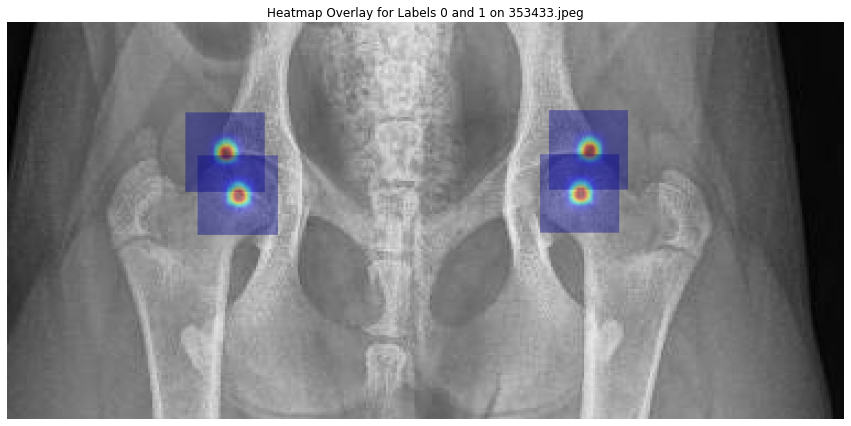

Processing /home/featurize/work/Dataset2/data/Testing/Images/325050.jpg


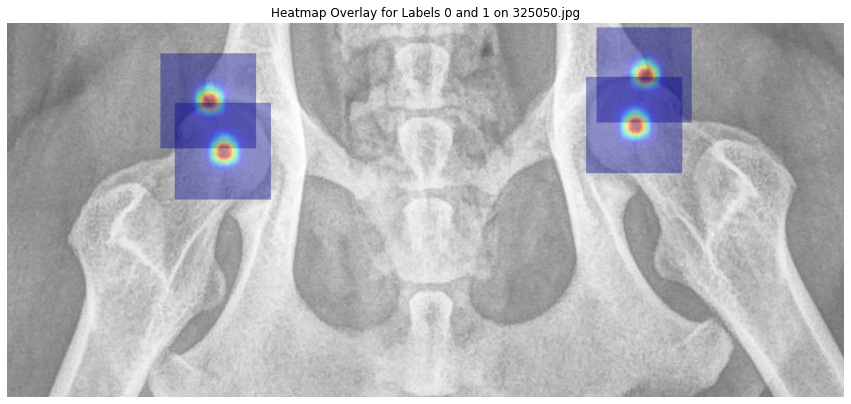

Processing /home/featurize/work/Dataset2/data/Testing/Images/347694.jpeg


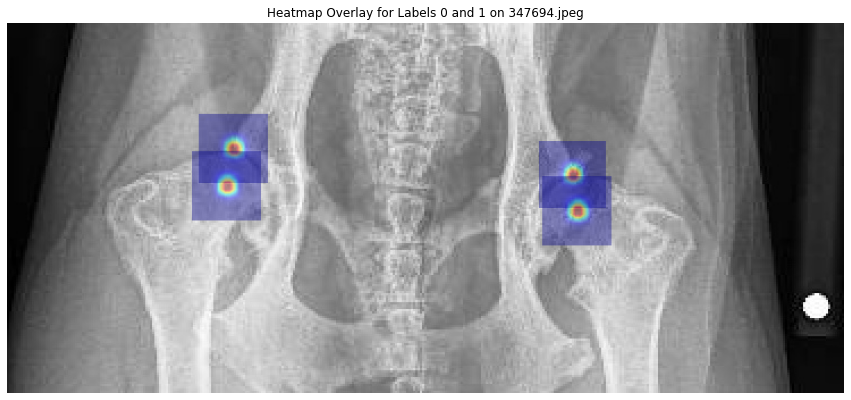

Processing /home/featurize/work/Dataset2/data/Testing/Images/354826.jpg


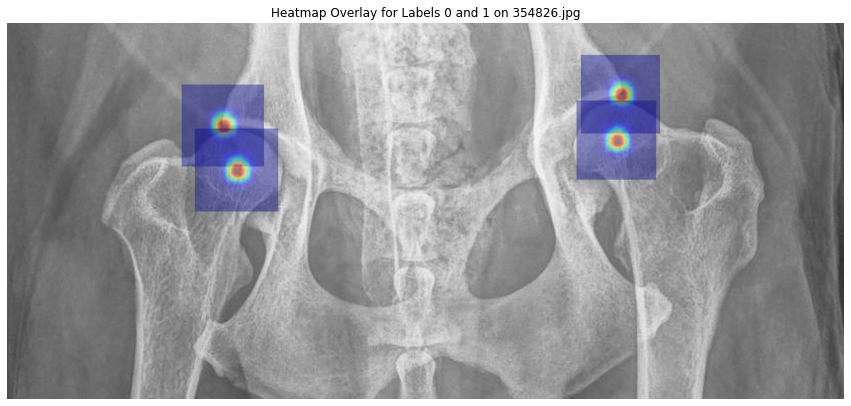

Processing /home/featurize/work/Dataset2/data/Testing/Images/346249.jpg


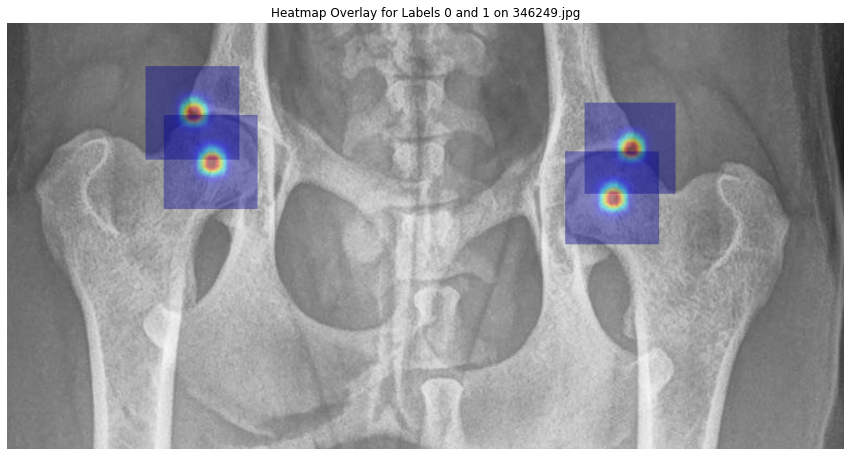

Processing /home/featurize/work/Dataset2/data/Testing/Images/357623.jpg


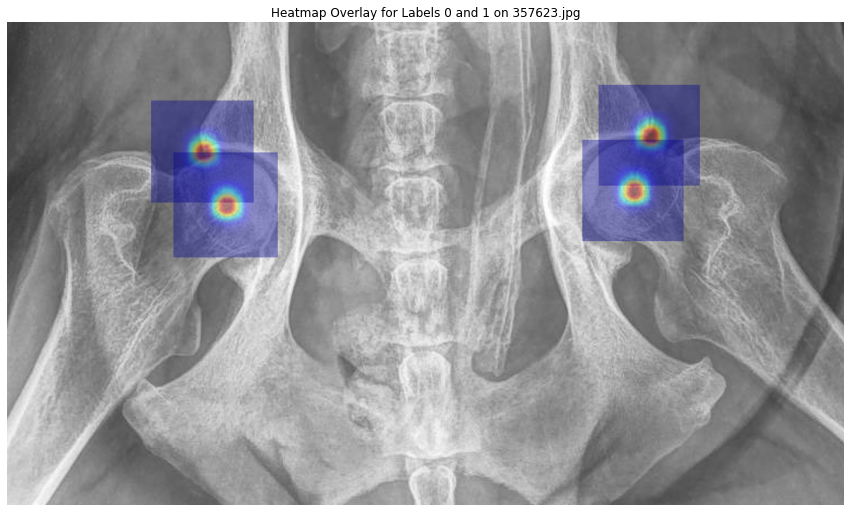

Processing /home/featurize/work/Dataset2/data/Testing/Images/357265.jpeg


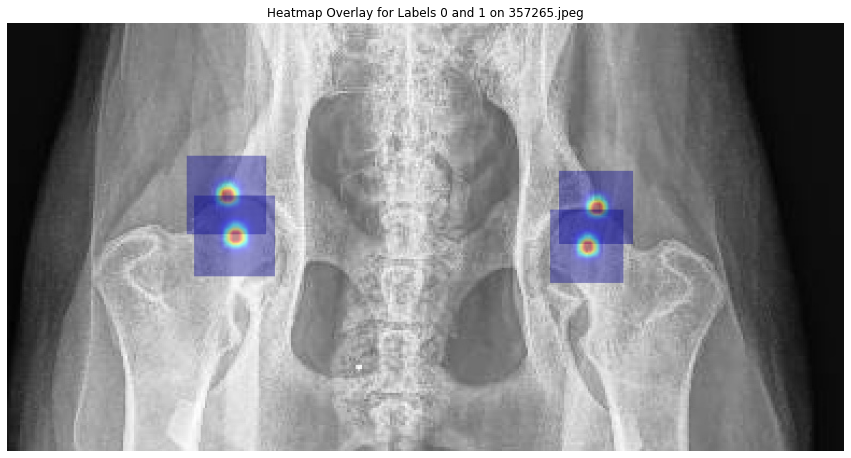

Processing /home/featurize/work/Dataset2/data/Testing/Images/353330.jpeg


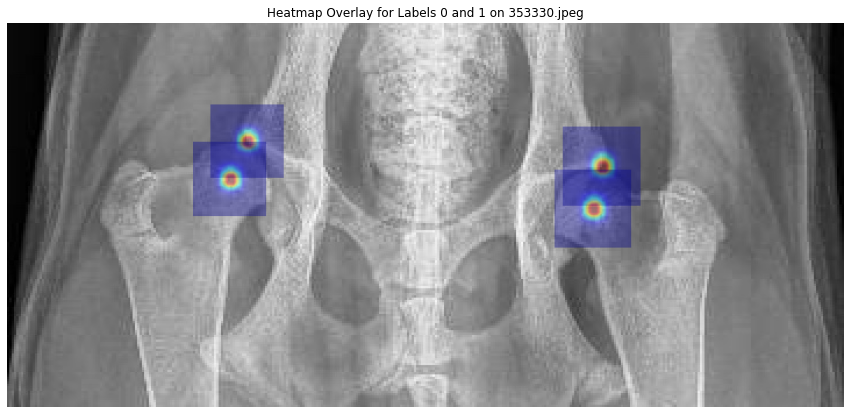

Processing /home/featurize/work/Dataset2/data/Testing/Images/363860.jpeg


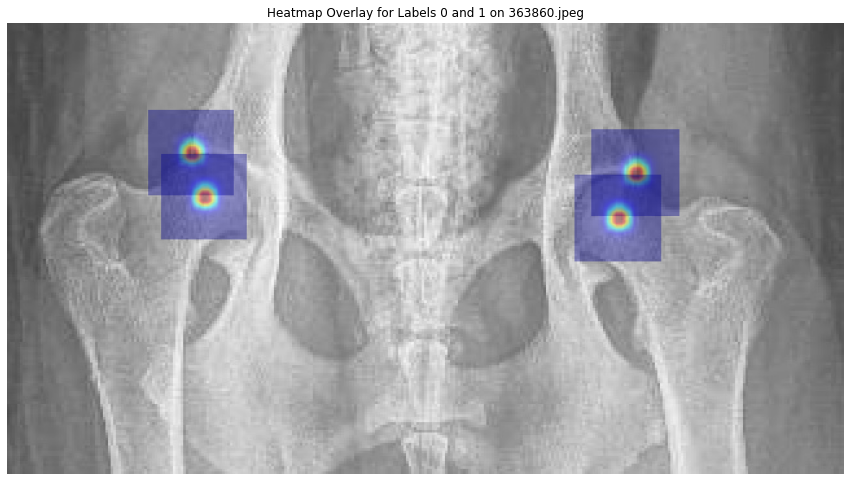

Processing /home/featurize/work/Dataset2/data/Testing/Images/325038.jpeg


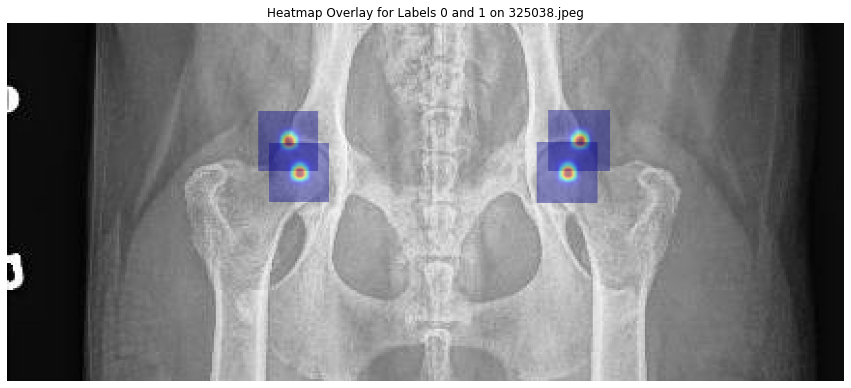

Processing /home/featurize/work/Dataset2/data/Testing/Images/357970.jpeg


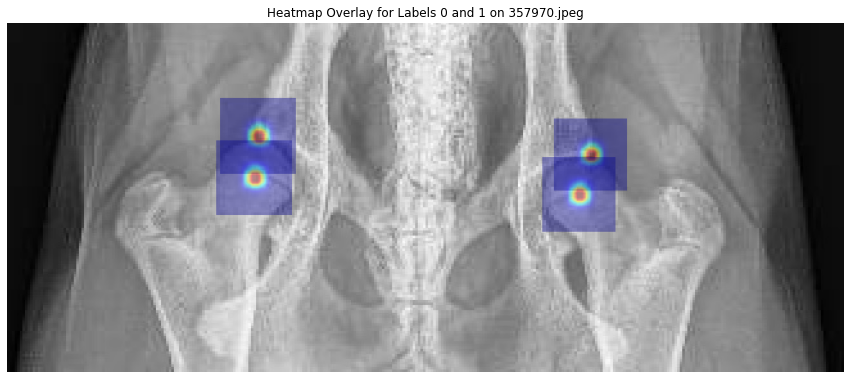

Processing /home/featurize/work/Dataset2/data/Testing/Images/268505.jpeg


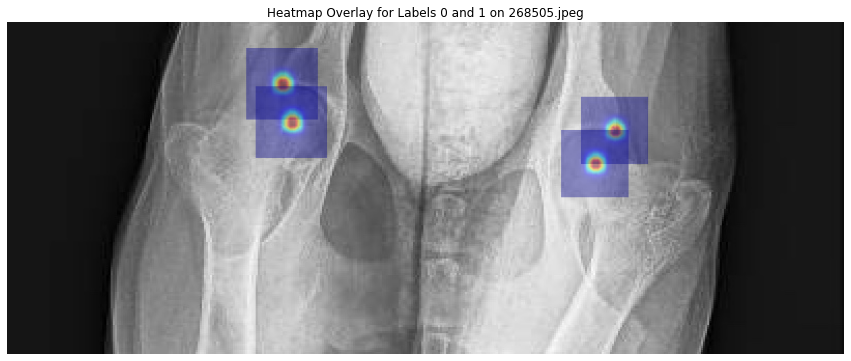

Processing /home/featurize/work/Dataset2/data/Testing/Images/349744.jpeg


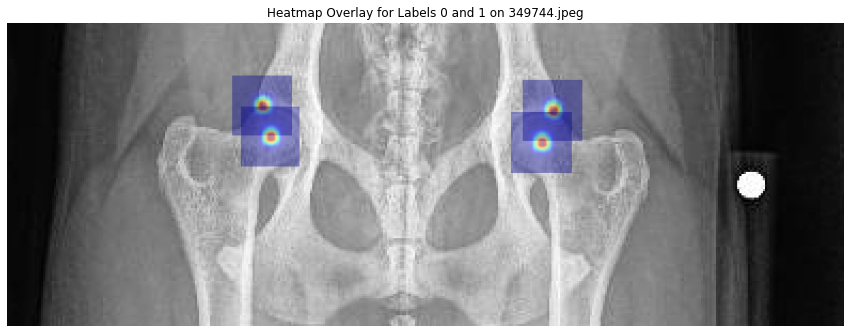

Processing /home/featurize/work/Dataset2/data/Testing/Images/351103.jpeg


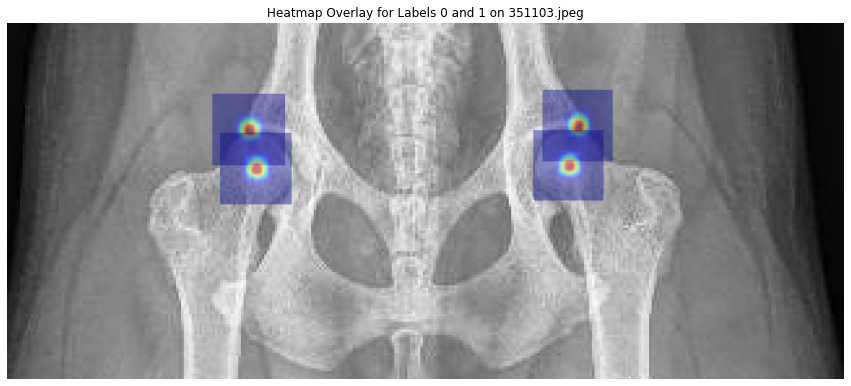

Processing /home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg


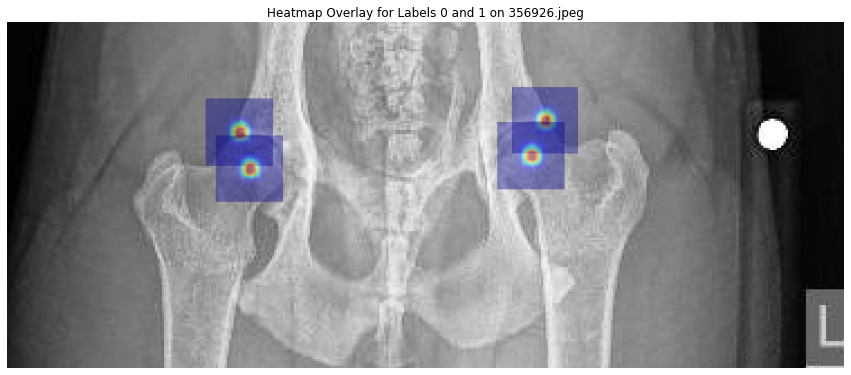

Processing /home/featurize/work/Dataset2/data/Testing/Images/352310.jpeg


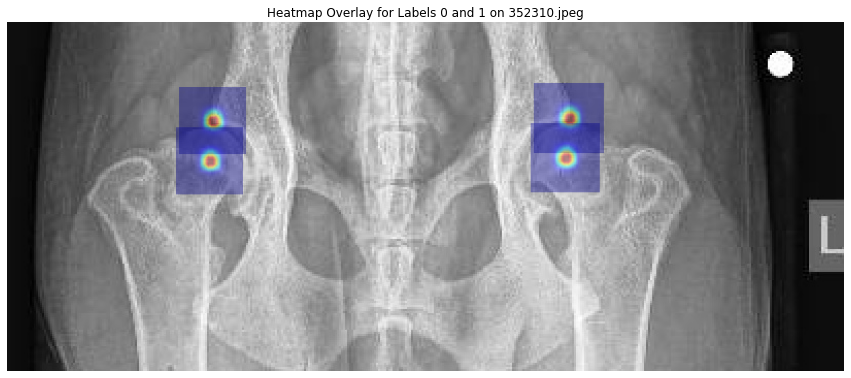

Processing /home/featurize/work/Dataset2/data/Testing/Images/364990.jpeg


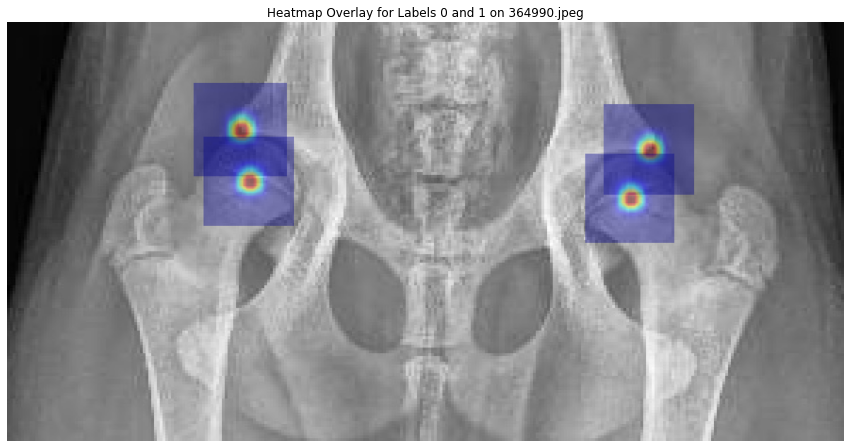

Processing /home/featurize/work/Dataset2/data/Testing/Images/361597.jpeg


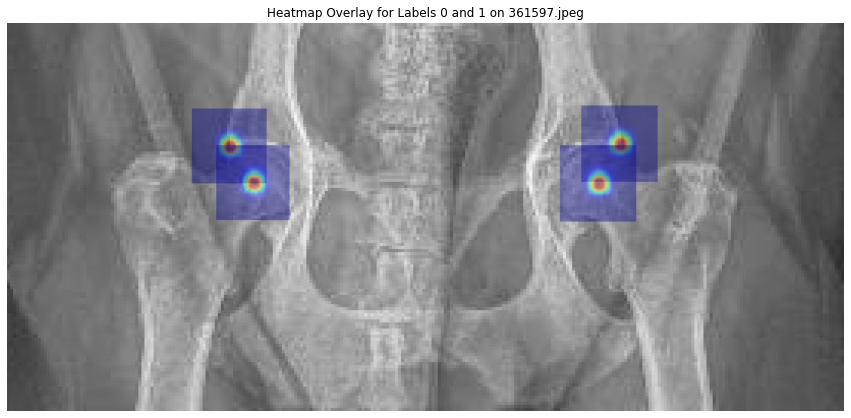

Processing /home/featurize/work/Dataset2/data/Testing/Images/360012.jpeg


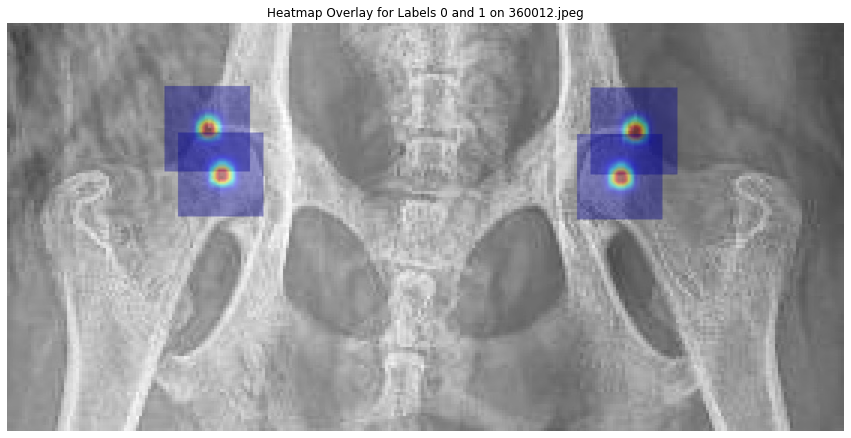

Processing /home/featurize/work/Dataset2/data/Testing/Images/329554.jpeg


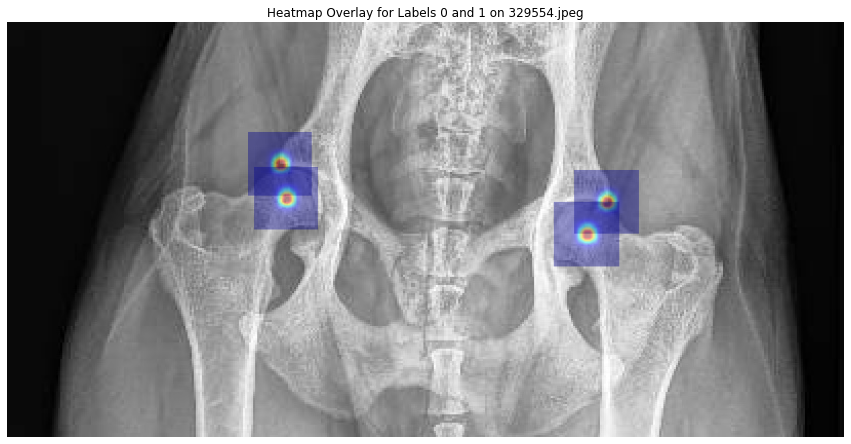

Processing /home/featurize/work/Dataset2/data/Testing/Images/357815.jpeg


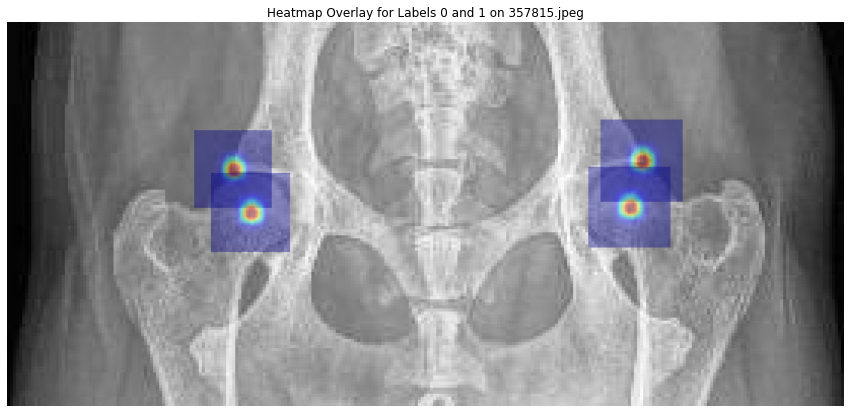

Processing /home/featurize/work/Dataset2/data/Testing/Images/354570.jpeg


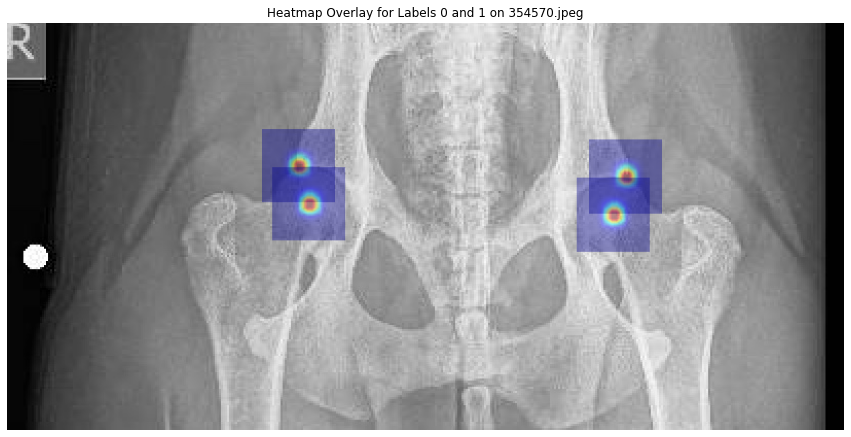

Processing /home/featurize/work/Dataset2/data/Testing/Images/361479.jpeg


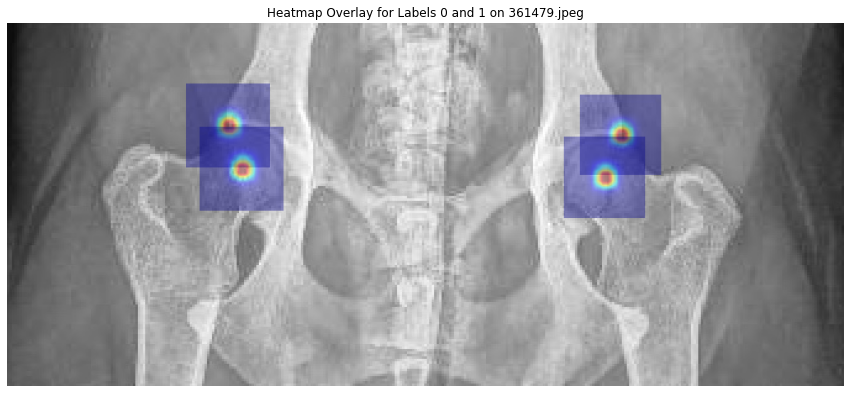

Processing /home/featurize/work/Dataset2/data/Testing/Images/357153.jpeg


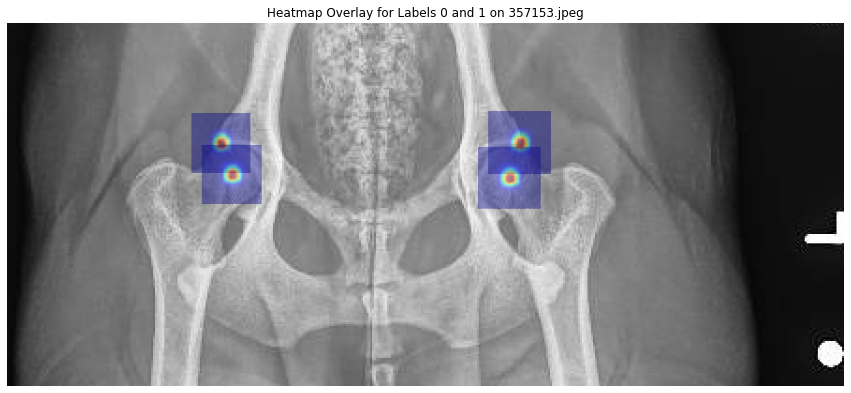

Processing /home/featurize/work/Dataset2/data/Testing/Images/308700.jpg


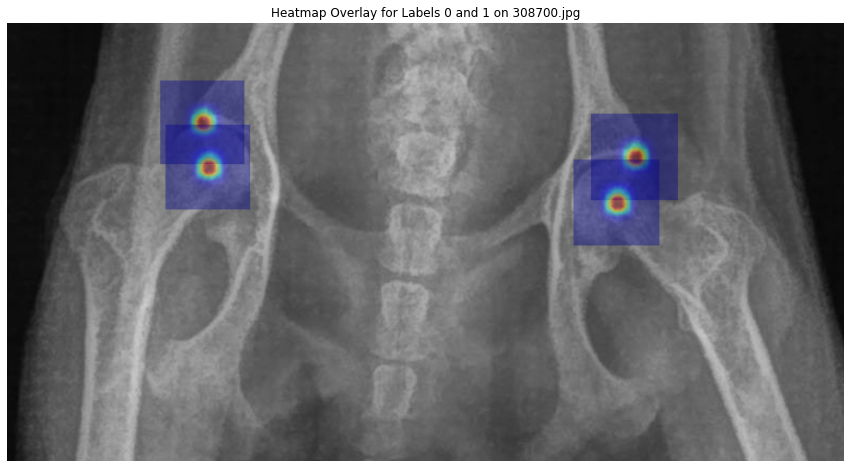

Processing /home/featurize/work/Dataset2/data/Testing/Images/361233.jpeg


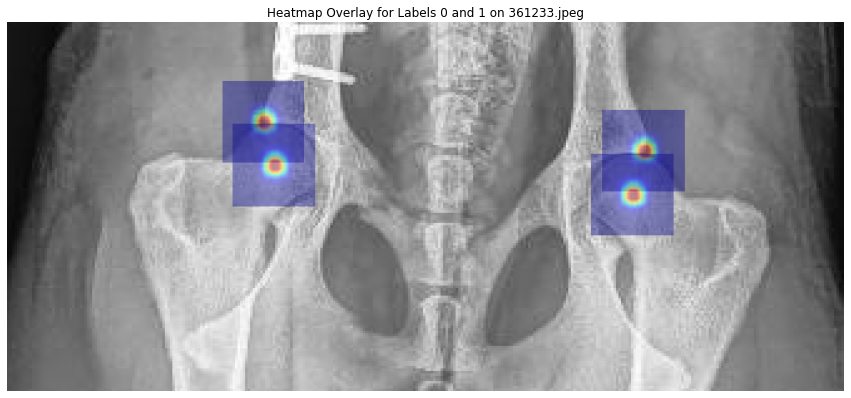

Processing /home/featurize/work/Dataset2/data/Testing/Images/357274.jpeg


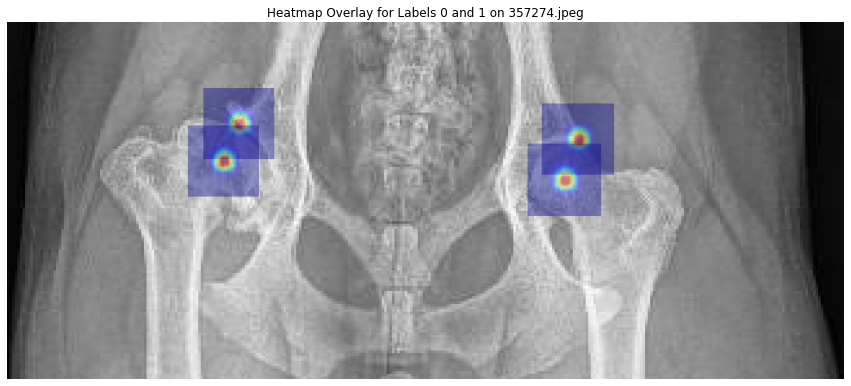

Processing /home/featurize/work/Dataset2/data/Testing/Images/330817.jpeg


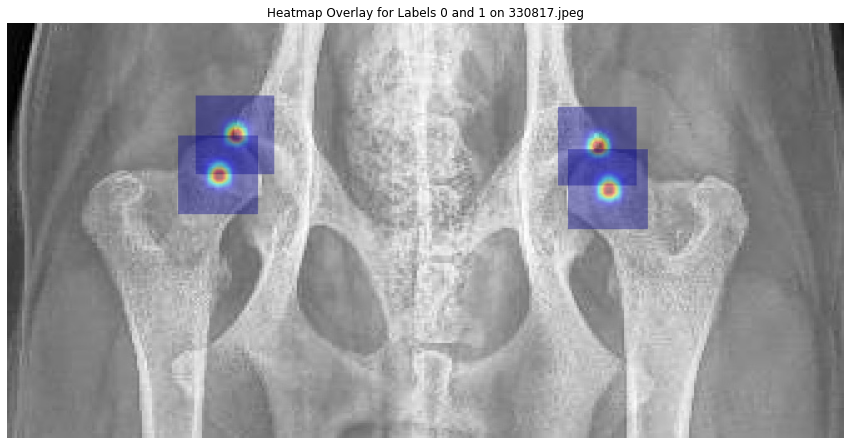

Processing /home/featurize/work/Dataset2/data/Testing/Images/359477.jpeg


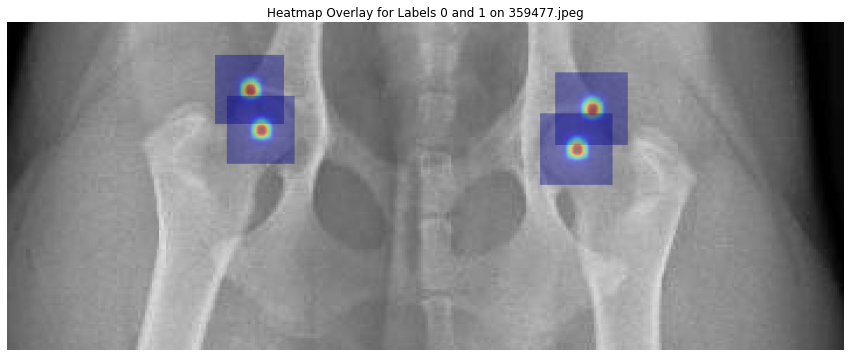

Processing /home/featurize/work/Dataset2/data/Testing/Images/320802.jpeg


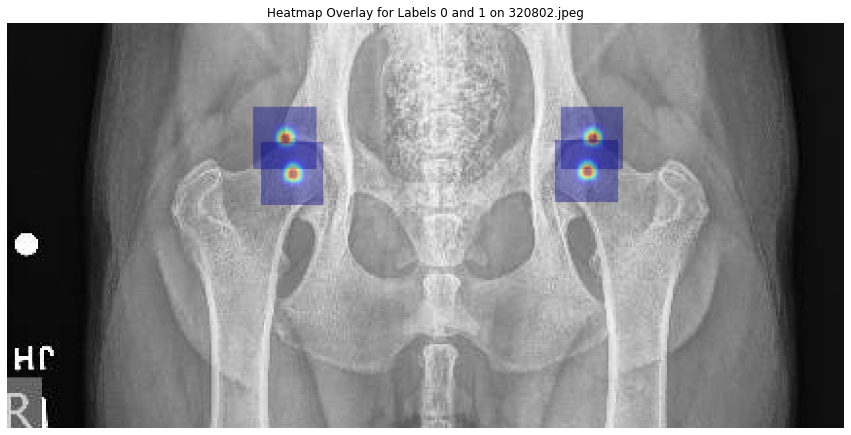

Processing /home/featurize/work/Dataset2/data/Testing/Images/362005.jpeg


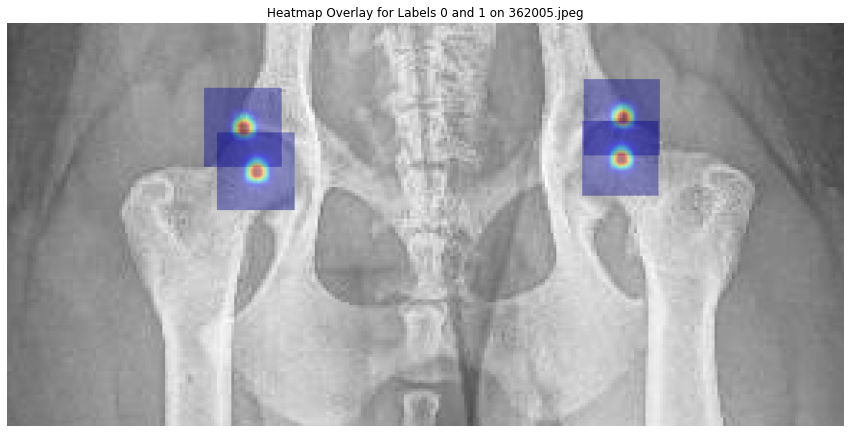

Processing /home/featurize/work/Dataset2/data/Testing/Images/362215.jpeg


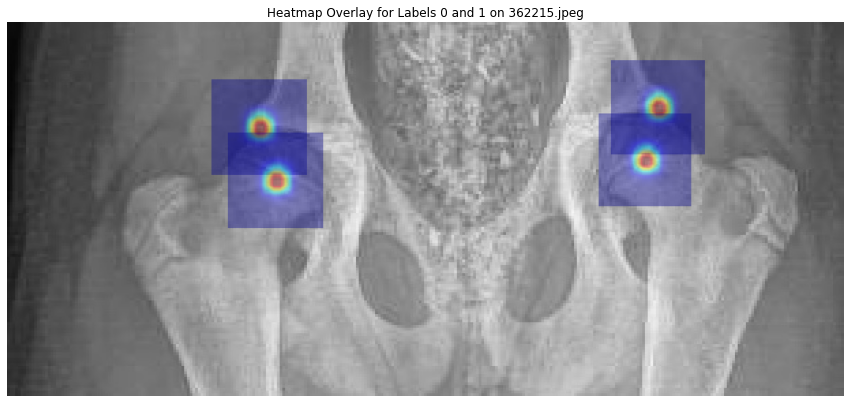

Processing /home/featurize/work/Dataset2/data/Testing/Images/351008.jpeg


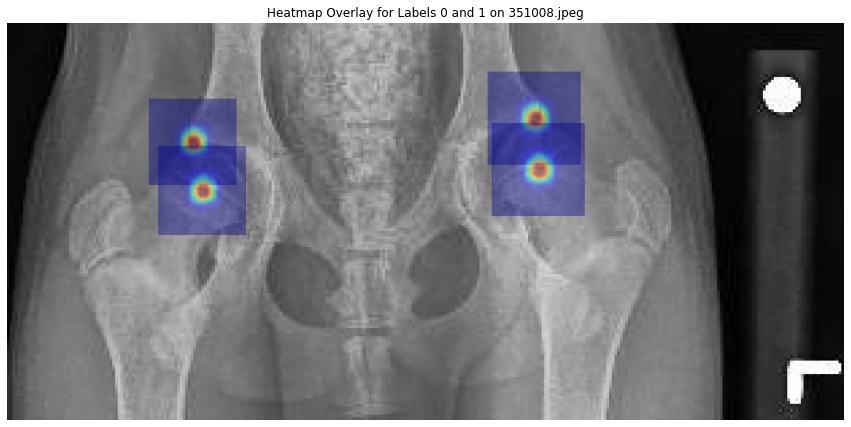

Processing /home/featurize/work/Dataset2/data/Testing/Images/356989.jpeg


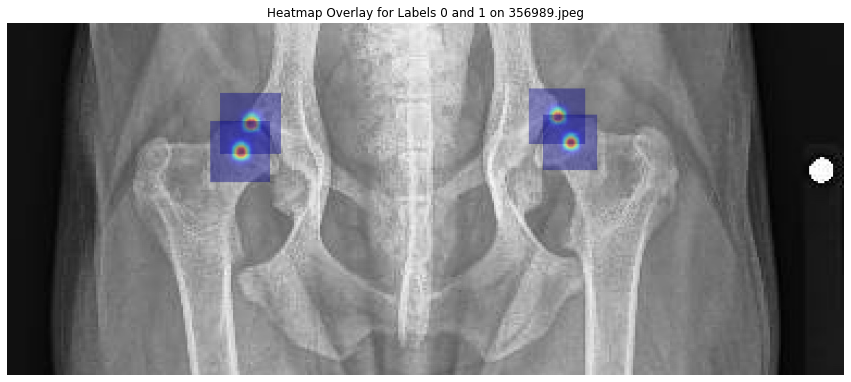

Processing /home/featurize/work/Dataset2/data/Testing/Images/331046.jpeg


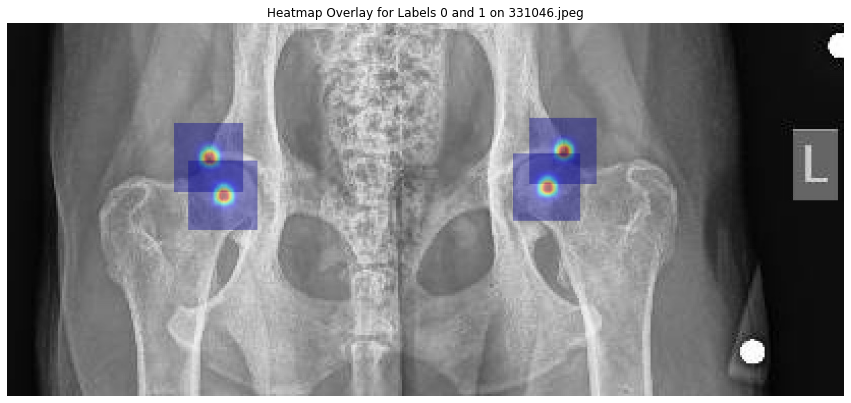

Processing /home/featurize/work/Dataset2/data/Testing/Images/324194.jpeg


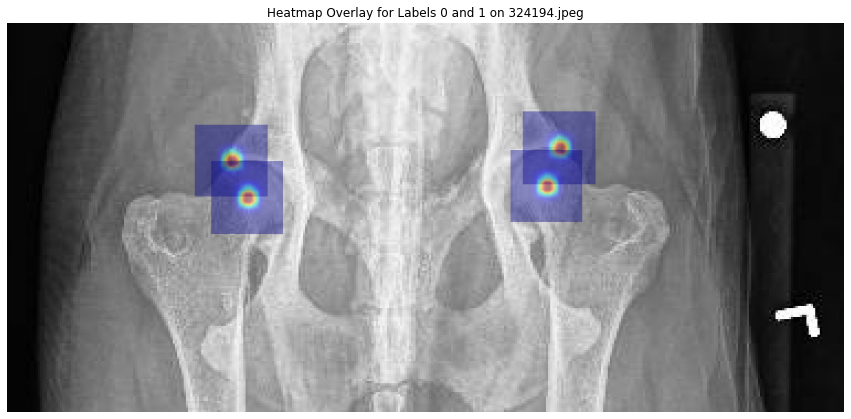

Processing /home/featurize/work/Dataset2/data/Testing/Images/342636.jpeg


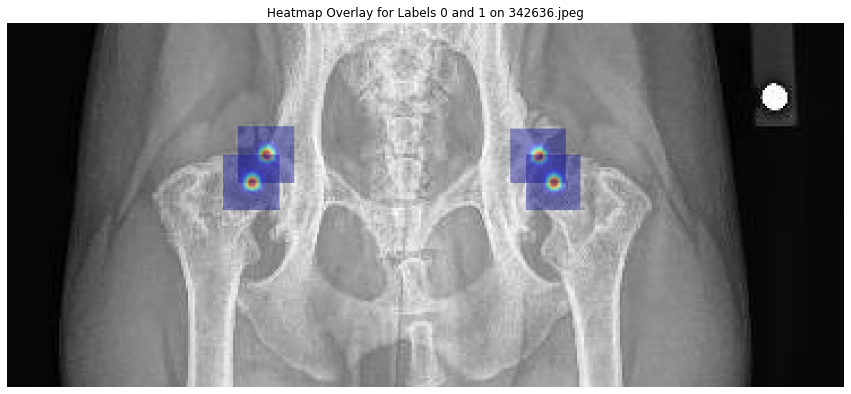

Processing /home/featurize/work/Dataset2/data/Testing/Images/361122.jpg


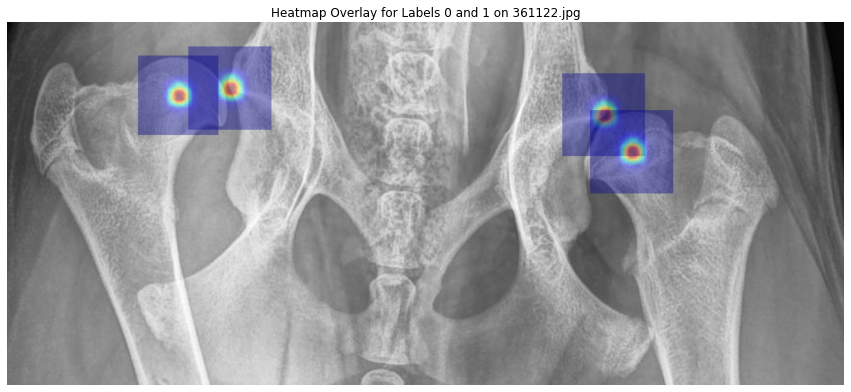

Processing /home/featurize/work/Dataset2/data/Testing/Images/363424.jpeg


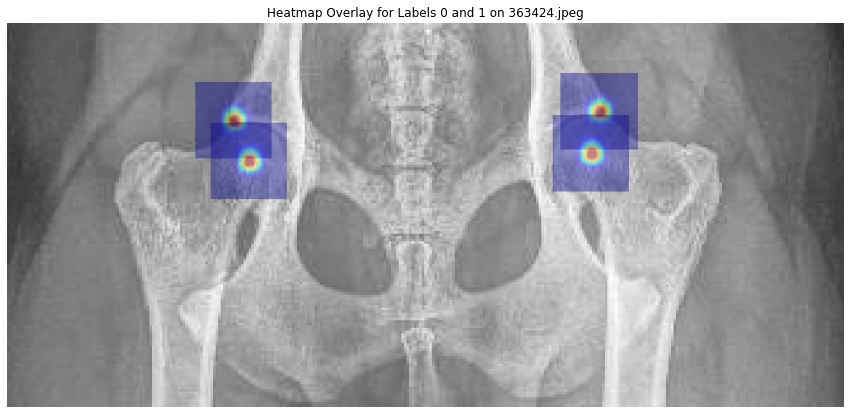

Processing /home/featurize/work/Dataset2/data/Testing/Images/351181.jpeg


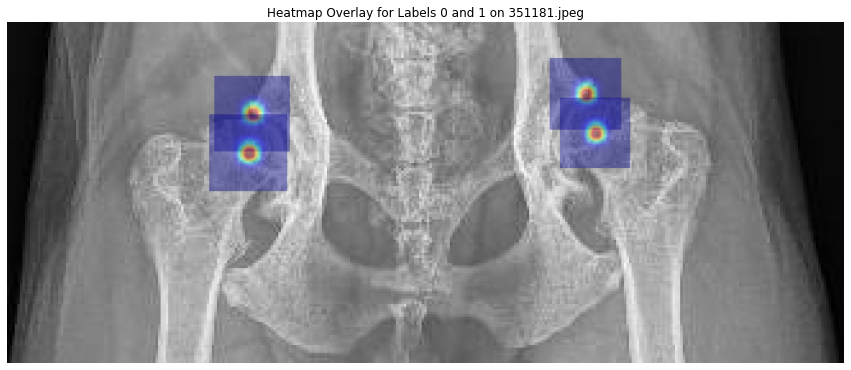

Processing /home/featurize/work/Dataset2/data/Testing/Images/282434.jpeg


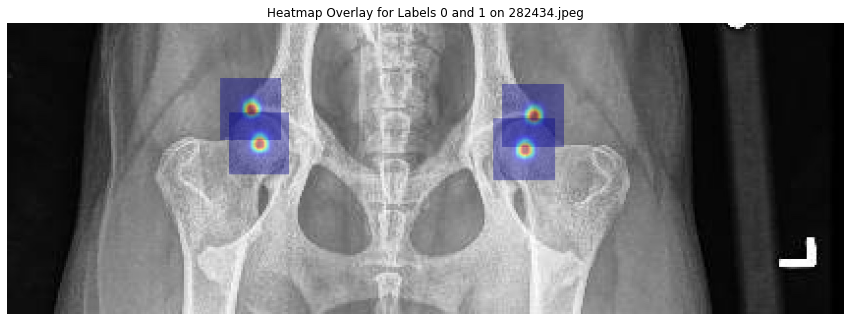

Processing /home/featurize/work/Dataset2/data/Testing/Images/281142.jpeg


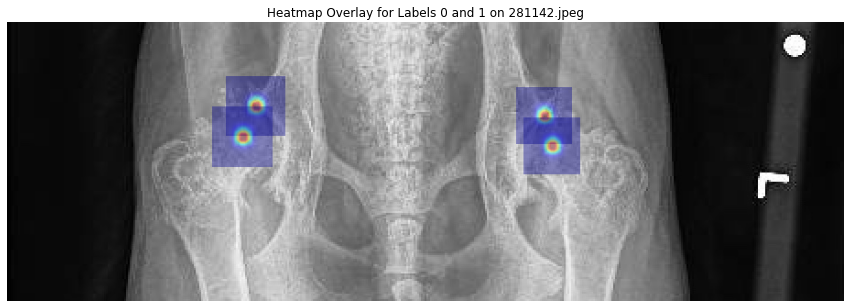

Processing /home/featurize/work/Dataset2/data/Testing/Images/359798.jpeg


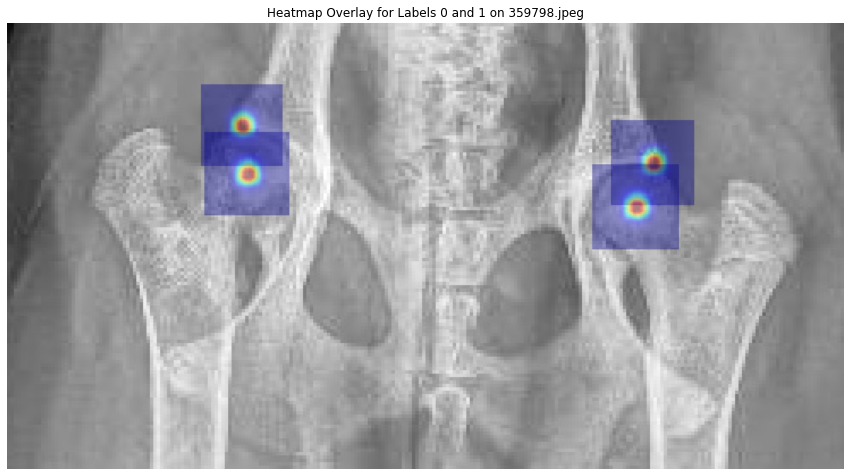

Processing /home/featurize/work/Dataset2/data/Testing/Images/293062.jpeg


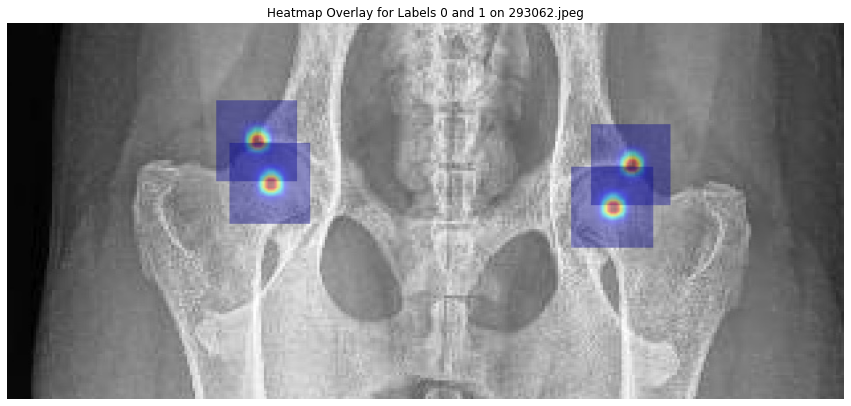

Processing /home/featurize/work/Dataset2/data/Testing/Images/308131.jpeg


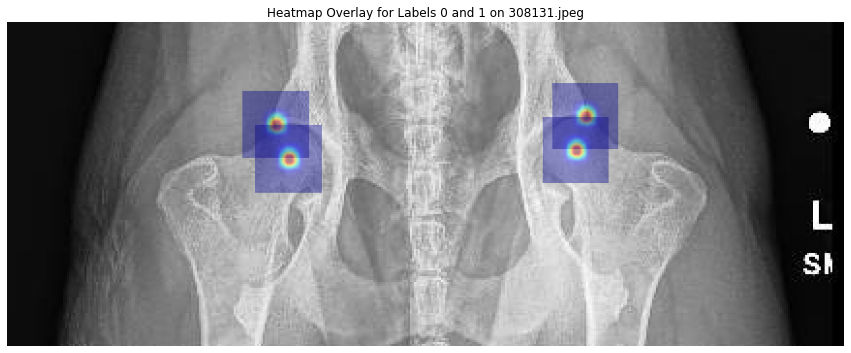

Processing /home/featurize/work/Dataset2/data/Testing/Images/332903.jpeg


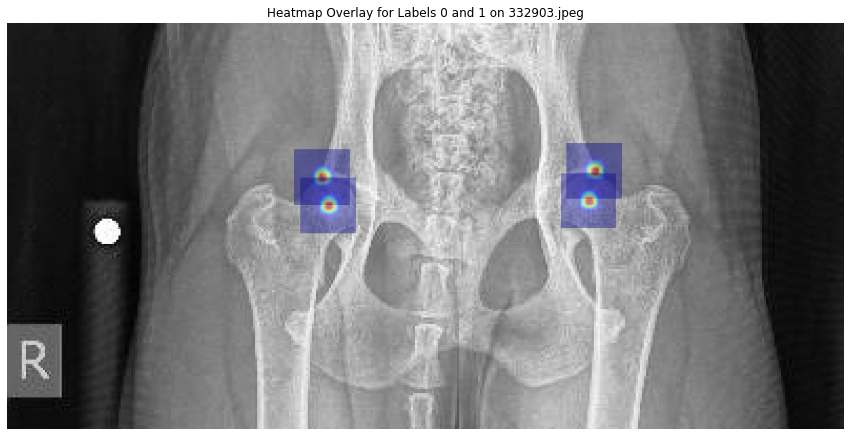

In [26]:
img_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
image_files = [f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

# Colors for keypoints
colors = [
    (255, 0, 0),    # Red for 'head'
    (0, 255, 0),    # Green for 'center'
]


for image_file in image_files:
    image_path = os.path.join(img_dir, image_file)
    print(f'Processing {image_path}')
    image = imread(image_path)
    
    # 初始化范围
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    # 检测结果
    detect_result = inference_detector(detector, image_path)
    CONF_THRES = 0.5
    pred_instance = detect_result.pred_instances.cpu().numpy()
    bboxes = np.concatenate((pred_instance.bboxes, pred_instance.scores[:, None]), axis=1)
    
    # 提取label=0和label=1的边界框
    bboxes_label_0 = bboxes[np.logical_and(pred_instance.labels == 0, pred_instance.scores > CONF_THRES)]
    bboxes_label_1 = bboxes[np.logical_and(pred_instance.labels == 1, pred_instance.scores > CONF_THRES)]
    
    bboxes_label_0 = bboxes_label_0[nms(bboxes_label_0, 0.3)][:, :4].astype('int')
    bboxes_label_1 = bboxes_label_1[nms(bboxes_label_1, 0.3)][:, :4].astype('int')

    # 如果存在label=0的边界框，预测关键点并绘制热力图
    if len(bboxes_label_0) > 0:
        pose_results_label_0 = inference_topdown(pose_estimator, image_path, bboxes_label_0)

    # 如果存在label=1的边界框，预测关键点并绘制热力图
    if len(bboxes_label_1) > 0:
        pose_results_label_1 = inference_topdown(pose_estimator, image_path, bboxes_label_1)

    # 创建叠加图层
    overlay = image.copy()

    # 绘制label=0的热力图
    for idx, pose_result in enumerate(pose_results_label_0):
        heatmap = pose_result._pred_heatmaps.heatmaps[0].cpu().numpy()
        x1, y1, x2, y2 = bboxes_label_0[idx]
        width, height = x2 - x1, y2 - y1

        heatmap_resized = cv2.resize(heatmap, (width, height))
        heatmap_normalized = cv2.normalize(heatmap_resized, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
        heatmap_colored = cv2.applyColorMap(heatmap_normalized, cv2.COLORMAP_JET)

        # 叠加热力图
        overlay[y1:y2, x1:x2] = cv2.addWeighted(overlay[y1:y2, x1:x2], 0.6, heatmap_colored, 0.4, 0)

    # 绘制label=1的热力图
    for idx, pose_result in enumerate(pose_results_label_1):
        heatmap = pose_result._pred_heatmaps.heatmaps[0].cpu().numpy()
        x1, y1, x2, y2 = bboxes_label_1[idx]
        width, height = x2 - x1, y2 - y1

        heatmap_resized = cv2.resize(heatmap, (width, height))
        heatmap_normalized = cv2.normalize(heatmap_resized, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
        heatmap_colored = cv2.applyColorMap(heatmap_normalized, cv2.COLORMAP_JET)

        # 叠加热力图
        overlay[y1:y2, x1:x2] = cv2.addWeighted(overlay[y1:y2, x1:x2], 0.6, heatmap_colored, 0.4, 0)

    # 绘制结果
    fig, ax = plt.subplots(figsize=(15, 15))
    ax.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.title(f'Heatmap Overlay for Labels 0 and 1 on {image_file}')
    plt.axis('off')
    plt.show()

In [ ]:
img_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
image_files = [f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

# 初始化总误差
total_mae = 0
num_points = 0  # 总的关键点数

for image_file in image_files:
    image_path = os.path.join(img_dir, image_file)
    print(f'Processing {image_path}')
    image = imread(image_path)
    
    # 初始化范围
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    # 检测结果
    detect_result = inference_detector(detector, image_path)
    CONF_THRES = 0.5
    pred_instance = detect_result.pred_instances.cpu().numpy()
    bboxes = np.concatenate((pred_instance.bboxes, pred_instance.scores[:, None]), axis=1)
    
    # 提取label=0和label=1的边界框
    bboxes_label_0 = bboxes[np.logical_and(pred_instance.labels == 0, pred_instance.scores > CONF_THRES)]
    bboxes_label_1 = bboxes[np.logical_and(pred_instance.labels == 1, pred_instance.scores > CONF_THRES)]
    
    bboxes_label_0 = bboxes_label_0[nms(bboxes_label_0, 0.3)][:, :4].astype('int')
    bboxes_label_1 = bboxes_label_1[nms(bboxes_label_1, 0.3)][:, :4].astype('int')

    # 如果存在label=0的边界框，预测关键点并绘制热力图
    if len(bboxes_label_0) > 0:
        pose_results_label_0 = inference_topdown(pose_estimator, image_path, bboxes_label_0)

    # 如果存在label=1的边界框，预测关键点并绘制热力图
    if len(bboxes_label_1) > 0:
        pose_results_label_1 = inference_topdown(pose_estimator, image_path, bboxes_label_1)

    # 创建叠加图层
    overlay = image.copy()

    for idx, pose_result in enumerate(pose_results_label_0 + pose_results_label_1):
        # 获取模型预测的关键点
        model_keypoints = pose_result.pred_instances.keypoints[0].astype('int')
        model_x, model_y = model_keypoints[0][0], model_keypoints[0][1]
        
        # 获取对应的边界框
        if idx < len(bboxes_label_0):
            x1, y1, x2, y2 = bboxes_label_0[idx]
        else:
            x1, y1, x2, y2 = bboxes_label_1[idx - len(bboxes_label_0)]
        
        # 获取heatmap并找到其最大值位置
        heatmap = pose_result._pred_heatmaps.heatmaps[0].cpu().numpy()
        width, height = x2 - x1, y2 - y1
        heatmap_resized = cv2.resize(heatmap, (width, height))
        max_y, max_x = np.unravel_index(np.argmax(heatmap_resized), heatmap_resized.shape)
        max_x += x1  # 转换到原图坐标
        max_y += y1

        # 计算MAE
        mae = np.abs(model_x - max_x) + np.abs(model_y - max_y)
        total_mae += mae
        num_points += 1

        # 可视化
        cv2.circle(overlay, (model_x, model_y), radius=5, color=(255, 0, 0), thickness=-1)  # 红色为模型预测
        cv2.circle(overlay, (max_x, max_y), radius=5, color=(0, 255, 0), thickness=-1)      # 绿色为heatmap预测

    # 绘制图像
    fig, ax = plt.subplots(figsize=(15, 15))
    ax.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.title(f'Heatmap and Keypoints for {image_file}')
    plt.axis('off')
    plt.show()

# 输出平均MAE
average_mae = total_mae / num_points if num_points > 0 else 0
print(f'Average MAE across all images: {average_mae}')

In [28]:
def predict_and_plot(image_path, detector, pose_estimator, conf_thres_center=0.39, conf_thres_head=0.46):
    print(f'Processing {image_path}')
    image = imread(image_path)
    
    # Initialize scope for detector
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    # Perform object detection
    detect_result_all = inference_detector(detector, image_path)
    pred_instance_all = detect_result_all.pred_instances.cpu().numpy()
    bboxes_all = np.concatenate((pred_instance_all.bboxes, pred_instance_all.scores[:, None]), axis=1)
    
    # Filter bounding boxes by labels and confidence thresholds
    bboxes_head = bboxes_all[np.logical_and(pred_instance_all.labels == 0, pred_instance_all.scores > conf_thres_head)]
    bboxes_center = bboxes_all[np.logical_and(pred_instance_all.labels == 1, pred_instance_all.scores > conf_thres_center)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

    # Initialize overlay layer
    overlay = image.copy()
    
    # Process 'head' label and overlay heatmap
    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator, image_path, bboxes_head)
        for idx, pose_result in enumerate(pose_results_head):
            heatmap = pose_result._pred_heatmaps.heatmaps[0].cpu().numpy()
            x1, y1, x2, y2 = bboxes_head[idx]
            width, height = x2 - x1, y2 - y1

            # Resize and normalize heatmap
            heatmap_resized = cv2.resize(heatmap, (width, height))
            heatmap_normalized = cv2.normalize(heatmap_resized, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
            heatmap_colored = cv2.applyColorMap(heatmap_normalized, cv2.COLORMAP_JET)

            # Overlay heatmap on the original image
            overlay[y1:y2, x1:x2] = cv2.addWeighted(overlay[y1:y2, x1:x2], 0.6, heatmap_colored, 0.4, 0)

    # Process 'center' label and overlay heatmap
    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
        for idx, pose_result in enumerate(pose_results_center):
            heatmap = pose_result._pred_heatmaps.heatmaps[0].cpu().numpy()
            x1, y1, x2, y2 = bboxes_center[idx]
            width, height = x2 - x1, y2 - y1

            # Resize and normalize heatmap
            heatmap_resized = cv2.resize(heatmap, (width, height))
            heatmap_normalized = cv2.normalize(heatmap_resized, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
            heatmap_colored = cv2.applyColorMap(heatmap_normalized, cv2.COLORMAP_JET)

            # Overlay heatmap on the original image
            overlay[y1:y2, x1:x2] = cv2.addWeighted(overlay[y1:y2, x1:x2], 0.6, heatmap_colored, 0.4, 0)

    # Plot the result
    fig, ax = plt.subplots(figsize=(15, 15))
    ax.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.title(f'Heatmap Overlay for Labels 0 and 1 on {image_path}')
    plt.axis('off')
    plt.show()

Processing /home/featurize/work/Dataset2/data/Testing/Images/361122.jpg


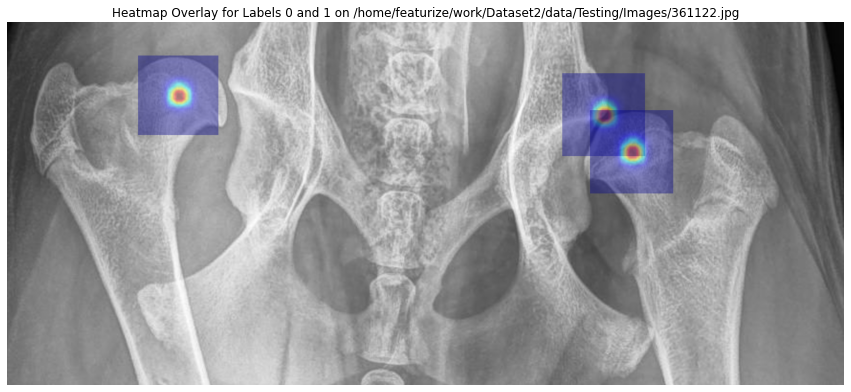

In [29]:
image_path = '/home/featurize/work/Dataset2/data/Testing/Images/361122.jpg'
predict_and_plot(image_path, detector, pose_estimator,  conf_thres_center=0.7, conf_thres_head=0.7)

Processing /home/featurize/work/Dataset2/data/Testing/Images/361122.jpg


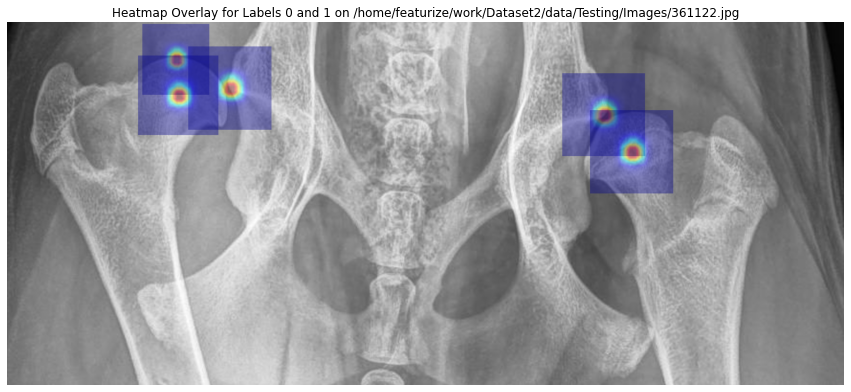

In [30]:
image_path = '/home/featurize/work/Dataset2/data/Testing/Images/361122.jpg'
predict_and_plot(image_path, detector, pose_estimator,  conf_thres_center=0.5, conf_thres_head=0.15)

In [32]:
def calculate_angle(center, head, opposite_center):
    # Ensure the arrays are flattened to (2,)
    center = np.array(center).flatten()
    head = np.array(head).flatten()
    opposite_center = np.array(opposite_center).flatten()
    
    # Vector from center to head
    vector1 = head - center
    # Vector from center to opposite center
    vector2 = opposite_center - center
    
    # Calculate cosine of the angle
    cos_angle = np.dot(vector1, vector2) / (np.linalg.norm(vector1) * np.linalg.norm(vector2))
    cos_angle = np.clip(cos_angle, -1.0, 1.0)  # Clamping to avoid numerical issues
    
    # Calculate the angle in degrees
    angle = np.arccos(cos_angle)
    return np.degrees(angle)


# Define the function to predict keypoints and save the results
def predict_and_save(image_path, mat_file_path, detector, pose_estimator, conf_thres_center=0.38, conf_thres_head=0.4):
    image = imread(image_path)
    mat_data = scipy.io.loadmat(mat_file_path)
    four_points = mat_data['Four_points']

    # Ground truth values
    left_head = four_points[2]
    right_head = four_points[3]
    center1 = four_points[0]
    center2 = four_points[1]
    radius1 = four_points[4][0]
    radius2 = four_points[4][1]
    angles = mat_data['Angles']
    
    # Initialize scope for detector and get detection results
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    detect_result_all = inference_detector(detector, image_path)
    
    # Process detection results for each label
    pred_instance_all = detect_result_all.pred_instances.cpu().numpy()
    bboxes_all = np.concatenate((pred_instance_all.bboxes, pred_instance_all.scores[:, None]), axis=1)
    bboxes_head = bboxes_all[np.logical_and(pred_instance_all.labels == 0, pred_instance_all.scores > conf_thres_head)]
    bboxes_center = bboxes_all[np.logical_and(pred_instance_all.labels == 1, pred_instance_all.scores > conf_thres_center)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')
    
    # Get predicted keypoints for heads and centers
    heads_pred = []
    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator, image_path, bboxes_head)
        heads_pred = [pose_result.pred_instances.keypoints[0].astype('int') for pose_result in pose_results_head]

    centers_pred = []
    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
        centers_pred = [pose_result.pred_instances.keypoints[0].astype('int') for pose_result in pose_results_center]
    
    # Create DataFrame to store ground truth and predicted values
    df = pd.DataFrame({
        'Image Path': [image_path],
        'Left Head X': [left_head[0]], 'Left Head Y': [left_head[1]],
        'Right Head X': [right_head[0]], 'Right Head Y': [right_head[1]],
        'Center1 X': [center1[0]], 'Center1 Y': [center1[1]],
        'Center2 X': [center2[0]], 'Center2 Y': [center2[1]],
        'Radius1': [radius1], 'Radius2': [radius2],
        'Angle1': [angles[0][0]], 'Angle2': [angles[0][1]],
        'Pred Left Head X': [np.nan], 'Pred Left Head Y': [np.nan],
        'Pred Right Head X': [np.nan], 'Pred Right Head Y': [np.nan],
        'Pred Center1 X': [np.nan], 'Pred Center1 Y': [np.nan],
        'Pred Center2 X': [np.nan], 'Pred Center2 Y': [np.nan],
        'Pred Radius1': [np.nan], 'Pred Radius2': [np.nan],
        'Pred Angle1': [np.nan], 'Pred Angle2': [np.nan]
    })

    # Update DataFrame with predicted values if predictions are available
    if len(centers_pred) >= 2 and len(heads_pred) >= 2:
        # Sort predicted points by x-coordinate to ensure left and right order
        #print('centers_pred',centers_pred)
        centers_pred = sorted(centers_pred, key=lambda p: p[0][0])
        heads_pred = sorted(heads_pred, key=lambda p: p[0][0])

        # Predicted radii
        predicted_radius1 = max(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
        predicted_radius2 = max(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2

        # Predicted angles
        predicted_angle1 = calculate_angle(centers_pred[0], heads_pred[0], centers_pred[1])
        predicted_angle2 = calculate_angle(centers_pred[1], heads_pred[1], centers_pred[0])

        # Fill DataFrame with predicted values
        pred_left_head, pred_right_head = heads_pred
        pred_center1, pred_center2 = centers_pred
        pred_left_head = pred_left_head.flatten()
        pred_right_head = pred_right_head.flatten()
        pred_center1 = pred_center1.flatten()
        pred_center2 = pred_center2.flatten()

        # Update DataFrame with the flattened predicted values
        df.loc[0, 'Pred Left Head X'], df.loc[0, 'Pred Left Head Y'] = pred_left_head
        df.loc[0, 'Pred Right Head X'], df.loc[0, 'Pred Right Head Y'] = pred_right_head
        df.loc[0, 'Pred Center1 X'], df.loc[0, 'Pred Center1 Y'] = pred_center1
        df.loc[0, 'Pred Center2 X'], df.loc[0, 'Pred Center2 Y'] = pred_center2

        # df.loc[0, 'Pred Left Head X'], df.loc[0, 'Pred Left Head Y'] = pred_left_head
        # df.loc[0, 'Pred Right Head X'], df.loc[0, 'Pred Right Head Y'] = pred_right_head
        # df.loc[0, 'Pred Center1 X'], df.loc[0, 'Pred Center1 Y'] = pred_center1
        # df.loc[0, 'Pred Center2 X'], df.loc[0, 'Pred Center2 Y'] = pred_center2
        df.loc[0, 'Pred Radius1'] = predicted_radius1
        df.loc[0, 'Pred Radius2'] = predicted_radius2
        df.loc[0, 'Pred Angle1'] = predicted_angle1
        df.loc[0, 'Pred Angle2'] = predicted_angle2

    return df

# Process all images and save results
def process_all_images_and_save(image_dir, label_dir, detector, pose_estimator, conf_thres_center=0.38, conf_thres_head=0.4, output_dir='/home/featurize/work/Result'):
    image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    all_dfs = []

    for image_file in image_files:
        image_path = os.path.join(image_dir, image_file)
        mat_file_path = os.path.join(label_dir, os.path.splitext(image_file)[0] + '.mat')
        if os.path.exists(mat_file_path):
            df = predict_and_save(image_path, mat_file_path, detector, pose_estimator, conf_thres_center, conf_thres_head)
            all_dfs.append(df)
        else:
            print(f'MAT file for image {image_file} not found.')

    # Combine all dataframes and save to CSV
    final_df = pd.concat(all_dfs, ignore_index=True)
    final_df.to_csv(os.path.join(output_dir, 'predictions_all.csv'), index=False)
    return final_df

In [33]:
# Example usage
image_dir = '/home/featurize/work/Dataset2/July_2024/Images'
label_dir = '/home/featurize/work/Dataset2/July_2024/Labels'
df1 =process_all_images_and_save(image_dir, label_dir, detector, pose_estimator, conf_thres_center=0.38, conf_thres_head=0.38, output_dir='/home/featurize/work/Result')

In [18]:
#df.to_csv('/home/featurize/work/Dataset2/data/Testing/Images/111.csv',index=False)

In [35]:
def calculate_angle(center, head, opposite_center):
    center = np.array(center).flatten()
    head = np.array(head).flatten()
    opposite_center = np.array(opposite_center).flatten()
    
    vector1 = head - center
    vector2 = opposite_center - center
    
    cos_angle = np.dot(vector1, vector2) / (np.linalg.norm(vector1) * np.linalg.norm(vector2))
    cos_angle = np.clip(cos_angle, -1.0, 1.0)  # Clamp to avoid numerical issues
    
    angle = np.arccos(cos_angle)
    return np.degrees(angle)

def predict_and_save(image_path, mat_file_path, detector, pose_estimator, conf_thres_center=0.38, conf_thres_head=0.4):
    image = imread(image_path)
    mat_data = scipy.io.loadmat(mat_file_path)
    four_points = mat_data['Four_points']

    left_head = four_points[2]
    right_head = four_points[3]
    center1 = four_points[0]
    center2 = four_points[1]
    radius1 = four_points[4][0]
    radius2 = four_points[4][1]
    angles = mat_data['Angles']
    
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    detect_result_all = inference_detector(detector, image_path)
    
    pred_instance_all = detect_result_all.pred_instances.cpu().numpy()
    bboxes_all = np.concatenate((pred_instance_all.bboxes, pred_instance_all.scores[:, None]), axis=1)
    bboxes_head = bboxes_all[np.logical_and(pred_instance_all.labels == 0, pred_instance_all.scores > conf_thres_head)]
    bboxes_center = bboxes_all[np.logical_and(pred_instance_all.labels == 1, pred_instance_all.scores > conf_thres_center)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')
    
    heads_pred, centers_pred = [], []

    def extract_keypoints_from_heatmap(pose_results, bboxes):
        keypoints = []
        for idx, pose_result in enumerate(pose_results):
            heatmap = pose_result._pred_heatmaps.heatmaps[0].cpu().numpy()
            x1, y1, x2, y2 = bboxes[idx]
            width, height = x2 - x1, y2 - y1
            heatmap_resized = cv2.resize(heatmap, (width, height))
            max_y, max_x = np.unravel_index(np.argmax(heatmap_resized), heatmap_resized.shape)
            max_x += x1
            max_y += y1
            keypoints.append([max_x, max_y])
        return keypoints
    
    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator, image_path, bboxes_head)
        heads_pred = extract_keypoints_from_heatmap(pose_results_head, bboxes_head)

    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
        centers_pred = extract_keypoints_from_heatmap(pose_results_center, bboxes_center)
    
    df = pd.DataFrame({
        'Image Path': [image_path],
        'Left Head X': [left_head[0]], 'Left Head Y': [left_head[1]],
        'Right Head X': [right_head[0]], 'Right Head Y': [right_head[1]],
        'Center1 X': [center1[0]], 'Center1 Y': [center1[1]],
        'Center2 X': [center2[0]], 'Center2 Y': [center2[1]],
        'Radius1': [radius1], 'Radius2': [radius2],
        'Angle1': [angles[0][0]], 'Angle2': [angles[0][1]],
        'Pred Left Head X': [np.nan], 'Pred Left Head Y': [np.nan],
        'Pred Right Head X': [np.nan], 'Pred Right Head Y': [np.nan],
        'Pred Center1 X': [np.nan], 'Pred Center1 Y': [np.nan],
        'Pred Center2 X': [np.nan], 'Pred Center2 Y': [np.nan],
        'Pred Radius1': [np.nan], 'Pred Radius2': [np.nan],
        'Pred Angle1': [np.nan], 'Pred Angle2': [np.nan]
    })

    if len(centers_pred) >= 2 and len(heads_pred) >= 2:
        centers_pred = sorted(centers_pred, key=lambda p: p[0])
        heads_pred = sorted(heads_pred, key=lambda p: p[0])

        pred_left_head, pred_right_head = heads_pred
        pred_center1, pred_center2 = centers_pred

        df.loc[0, ['Pred Left Head X', 'Pred Left Head Y']] = pred_left_head
        df.loc[0, ['Pred Right Head X', 'Pred Right Head Y']] = pred_right_head
        df.loc[0, ['Pred Center1 X', 'Pred Center1 Y']] = pred_center1
        df.loc[0, ['Pred Center2 X', 'Pred Center2 Y']] = pred_center2
        
        df.loc[0, 'Pred Radius1'] = max(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
        df.loc[0, 'Pred Radius2'] = max(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
        df.loc[0, 'Pred Angle1'] = calculate_angle(pred_center1, pred_left_head, pred_center2)
        df.loc[0, 'Pred Angle2'] = calculate_angle(pred_center2, pred_right_head, pred_center1)

    return df

In [36]:
image_dir = '/home/featurize/work/Dataset2/July_2024/Images'
label_dir = '/home/featurize/work/Dataset2/July_2024/Labels'
df2 =process_all_images_and_save(image_dir, label_dir, detector, pose_estimator, conf_thres_center=0.38, conf_thres_head=0.38, output_dir='/home/featurize/work/Result')

Percentage of angles with less than 1 degree error: 14.89%
Percentage of angles with less than 5 degrees error: 75.57%
Percentage of angles with less than 10 degrees error: 96.95%
Percentage of Delta Angle1 < 5: 74.81%
Percentage of Delta Angle2 < 5: 76.34%
Percentage of Delta Angle1 < 10: 96.18%
Percentage of Delta Angle2 < 10: 97.71%
MAE for Angle1: 3.830499369649541
MAE for Angle2: 3.416633311006041
MAE for all Angles: 3.6235663403277916
------------------------------------------------
Correlation between Angle1 and Pred Angle1: 0.95
Correlation between Angle2 and Pred Angle2: 0.95
------------------------------------------------
MSE Point: 13.095271615031685
MSE Angle: 22.388441584833615
MSE Radius: 6.525513210536591
MAPE Point: 0.020218869278123497
MAPE Angle: 0.03903529381085652
MAPE Radius: 0.036681138602869465
R2 Head Left: 0.9867583869147596
R2 Head Right: 0.9941854069154796
R2 Center1: 0.9857053984592867
R2 Center2: 0.9945022398339205
R2 Angle: 0.8617967927569795
Percentage o

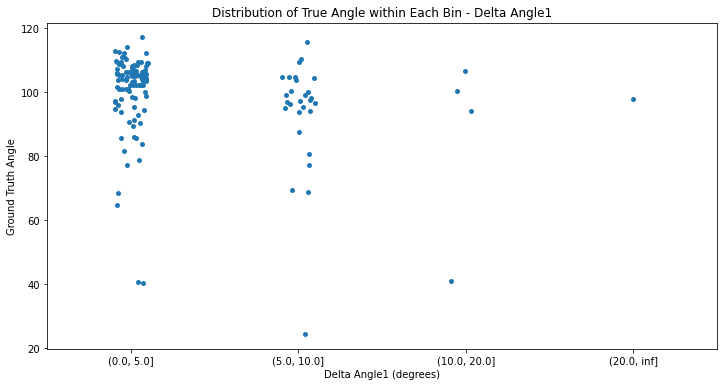

File: 39402.jpg


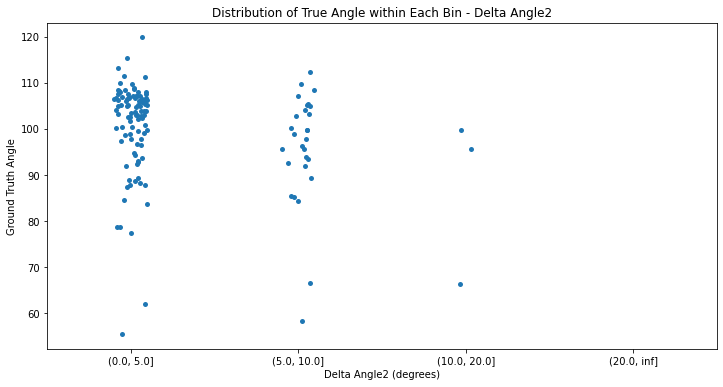

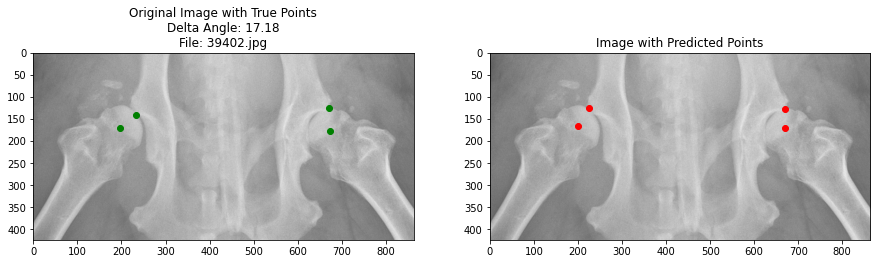

File: ZW1.jpg


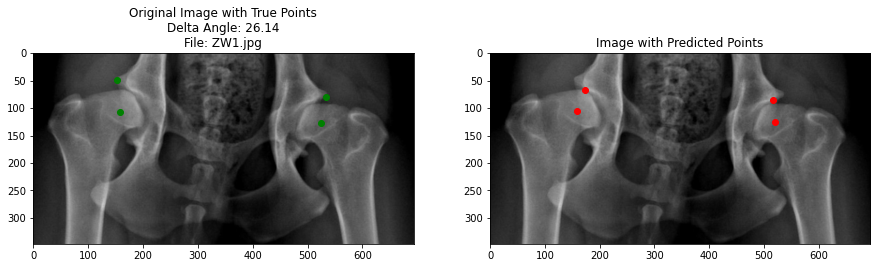

File: 37558.jpg


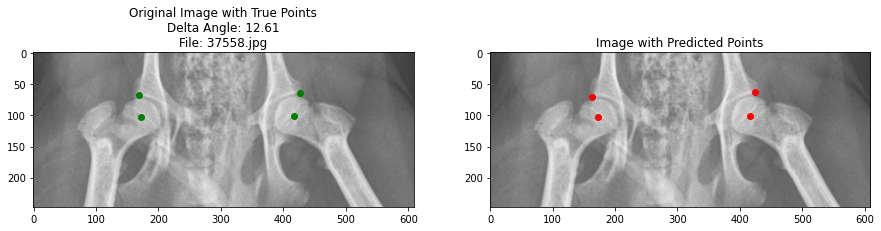

File: 8510.jpg


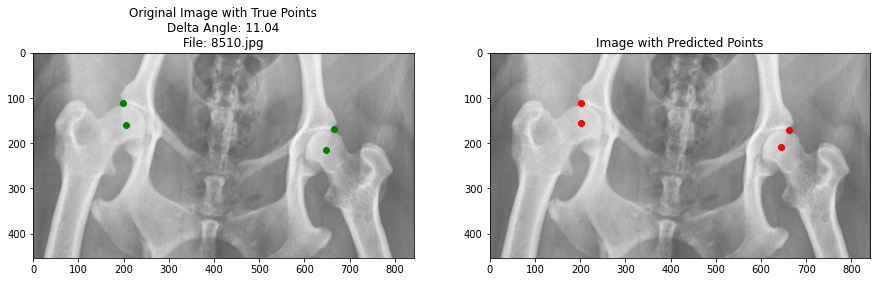

File: 13947.jpg


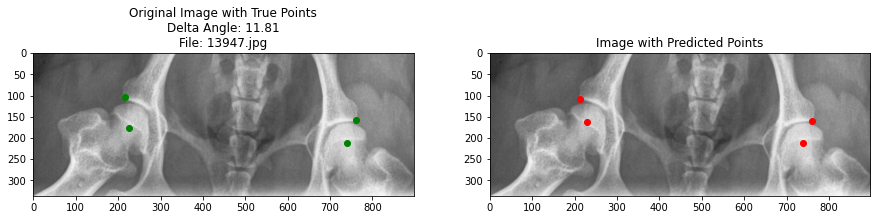

In [39]:
evaluate_df(df2)

In [44]:
all_matrics(df2)

Percentage of angles with less than 1 degree error: 14.89%
Percentage of angles with less than 5 degrees error: 75.57%
Percentage of angles with less than 10 degrees error: 96.95%
Percentage of Delta Angle1 < 5: 74.81%
Percentage of Delta Angle2 < 5: 76.34%
Percentage of Delta Angle1 < 10: 96.18%
Percentage of Delta Angle2 < 10: 97.71%
MAE for Angle1: 3.830499369649541
MAE for Angle2: 3.416633311006041
MAE for all Angles: 3.6235663403277916
MSE Point: 13.095271615031685
MSE Angle: 22.388441584833615
MSE Radius: 6.525513210536591
MAE Point: 2.762482033351125
MAE Radius: 1.6941455811295234
MAPE Point: 0.020218869278123497
MAPE Angle: 0.03903529381085652
MAPE Radius: 0.036681138602869465
R2 Head Left: 0.9867583869147596
R2 Head Right: 0.9941854069154796
R2 Center1: 0.9857053984592867
R2 Center2: 0.9945022398339205
R2 Angle: 0.8617967927569795
R2 radius: 0.9188452954582498


In [38]:
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error, r2_score,mean_absolute_error
import seaborn as sns

def classify_na(angle):
    if angle >= 105:
        return 'Excellent'
    elif 100 <= angle < 105:
        return 'Good'
    elif 95 <= angle < 100:
        return 'Fair'
    elif 90 <= angle < 95:
        return 'Borderline'
    elif 85 <= angle < 90:
        return 'Mild'
    elif 80 <= angle < 85:
        return 'Moderate'
    elif angle < 80:
        return 'Severe'
    else:
        return 'Unknown'
    
def evaluate_df(df):
    # delta_angle
    df['Delta Angle1'] = abs(df['Angle1'] - df['Pred Angle1'])
    df['Delta Angle2'] = abs(df['Angle2'] - df['Pred Angle2'])

    percentage_less_than_1_degree = (
        ((df['Delta Angle1'] < 1).sum() + (df['Delta Angle2'] < 1).sum()) / (2 * len(df))
    ) * 100

    # 计算误差小于5度的百分比
    percentage_less_than_5_degrees = (
        ((df['Delta Angle1'] < 5).sum() + (df['Delta Angle2'] < 5).sum()) / (2 * len(df))
    ) * 100

    # 计算误差小于10度的百分比
    percentage_less_than_10_degrees = (
        ((df['Delta Angle1'] < 10).sum() + (df['Delta Angle2'] < 10).sum()) / (2 * len(df))
    ) * 100

    print(f"Percentage of angles with less than 1 degree error: {percentage_less_than_1_degree:.2f}%")
    print(f"Percentage of angles with less than 5 degrees error: {percentage_less_than_5_degrees:.2f}%")
    print(f"Percentage of angles with less than 10 degrees error: {percentage_less_than_10_degrees:.2f}%")

    angle1_under_5 = (df['Delta Angle1'] < 5).sum()
    angle2_under_5 = (df['Delta Angle2'] < 5).sum()
    total_entries = len(df)

    percentage_angle1_under_5 = (angle1_under_5 / total_entries) * 100
    percentage_angle2_under_5 = (angle2_under_5 / total_entries) * 100

    print(f"Percentage of Delta Angle1 < 5: {percentage_angle1_under_5:.2f}%")
    print(f"Percentage of Delta Angle2 < 5: {percentage_angle2_under_5:.2f}%")

    angle1_under_10 = (df['Delta Angle1'] < 10).sum()
    angle2_under_10 = (df['Delta Angle2'] < 10).sum()

    percentage_angle1_under_10 = (angle1_under_10 / total_entries) * 100
    percentage_angle2_under_10 = (angle2_under_10 / total_entries) * 100

    print(f"Percentage of Delta Angle1 < 10: {percentage_angle1_under_10:.2f}%")
    print(f"Percentage of Delta Angle2 < 10: {percentage_angle2_under_10:.2f}%")
    
    mae_angle1 = mean_absolute_error(df['Angle1'], df['Pred Angle1'])
    mae_angle2 = mean_absolute_error(df['Angle2'], df['Pred Angle2'])
    combined_angles_true = df[['Angle1', 'Angle2']].values.flatten()
    combined_angles_pred = df[['Pred Angle1', 'Pred Angle2']].values.flatten()
    mae_combined_angles = mean_absolute_error(combined_angles_true, combined_angles_pred)


    print(f"MAE for Angle1: {mae_angle1}")
    print(f"MAE for Angle2: {mae_angle2}")
    print(f"MAE for all Angles: {mae_combined_angles}")


    # mse
    mse_point = mean_squared_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                   df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X', 'Pred Center2 Y']])

    mse_angle = mean_squared_error(df[['Angle1', 'Angle2']],
                                   df[['Pred Angle1', 'Pred Angle2']])

    mse_radius = mean_squared_error(df[['Radius1', 'Radius2']],
                                    df[['Pred Radius1', 'Pred Radius2']])

    # MAPE
    mape_point = mean_absolute_percentage_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                                df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X','Pred Center2 Y']])

    mape_angle = mean_absolute_percentage_error(df[['Angle1', 'Angle2']],
                                                df[['Pred Angle1', 'Pred Angle2']])

    mape_radius = mean_absolute_percentage_error(df[['Radius1', 'Radius2']],
                                                 df[['Pred Radius1', 'Pred Radius2']])

    # R2
    r2_head_left = r2_score(df[['Left Head X', 'Left Head Y']],
                            df[['Pred Left Head X', 'Pred Left Head Y']])

    r2_head_right = r2_score(df[['Right Head X', 'Right Head Y']],
                             df[['Pred Right Head X', 'Pred Right Head Y']])

    r2_center1 = r2_score(df[['Center1 X', 'Center1 Y']],
                          df[['Pred Center1 X', 'Pred Center1 Y']])

    r2_center2 = r2_score(df[['Center2 X', 'Center2 Y']],
                          df[['Pred Center2 X', 'Pred Center2 Y']])

    r2_angle = r2_score(df[['Angle1', 'Angle2']],
                        df[['Pred Angle1', 'Pred Angle2']])
    
    # 相关性分析
    print('------------------------------------------------')
    angle1_corr = df['Angle1'].corr(df['Pred Angle1'])
    angle2_corr = df['Angle2'].corr(df['Pred Angle2'])
    
    print(f"Correlation between Angle1 and Pred Angle1: {angle1_corr:.2f}")
    print(f"Correlation between Angle2 and Pred Angle2: {angle2_corr:.2f}")
    print('------------------------------------------------')

    print(f"MSE Point: {mse_point}")
    print(f"MSE Angle: {mse_angle}")
    print(f"MSE Radius: {mse_radius}")
    print(f"MAPE Point: {mape_point}")
    print(f"MAPE Angle: {mape_angle}")
    print(f"MAPE Radius: {mape_radius}")
    print(f"R2 Head Left: {r2_head_left}")
    print(f"R2 Head Right: {r2_head_right}")
    print(f"R2 Center1: {r2_center1}")
    print(f"R2 Center2: {r2_center2}")
    print(f"R2 Angle: {r2_angle}")
    
    
    df['Angle1 Classification'] = df['Angle1'].apply(classify_na)
    df['Angle2 Classification'] = df['Angle2'].apply(classify_na)

    df['Pred Angle1 Classification'] = df['Pred Angle1'].apply(classify_na)
    df['Pred Angle2 Classification'] = df['Pred Angle2'].apply(classify_na)
    
    total_count = len(df)
    same_classification_count1 = (df['Angle1 Classification'] == df['Pred Angle1 Classification']).sum()
    percentage_same_classification1 = (same_classification_count1 / total_count) * 100

    print(f"Percentage of same classification angle1: {percentage_same_classification1:.2f}%")

    same_classification_count2 = (df['Angle2 Classification'] == df['Pred Angle2 Classification']).sum()
    percentage_same_classification2 = (same_classification_count2 / total_count) * 100

    print(f"Percentage of same classification angle2: {percentage_same_classification2:.2f}%")
    
    ##
    df['Delta Angle1 Bin'] = pd.cut(df['Delta Angle1'], bins=[0, 5, 10, 20, float('inf')])
    df['Delta Angle2 Bin'] = pd.cut(df['Delta Angle2'], bins=[0, 5, 10, 20, float('inf')])

    # Delta Angle1
    plt.figure(figsize=(12, 6))
    sns.stripplot(x='Delta Angle1 Bin', y='Angle1', data=df, jitter=True)
    plt.xlabel('Delta Angle1 (degrees)')
    plt.ylabel('Ground Truth Angle')
    plt.title('Distribution of True Angle within Each Bin - Delta Angle1')
    plt.show()

    # Delta Angle2
    plt.figure(figsize=(12, 6))
    sns.stripplot(x='Delta Angle2 Bin', y='Angle2', data=df, jitter=True)
    plt.xlabel('Delta Angle2 (degrees)')
    plt.ylabel('Ground Truth Angle')
    plt.title('Distribution of True Angle within Each Bin - Delta Angle2')
    
    
    filtered_df = df[(df['Delta Angle1'] > 10)]
    for index, row in filtered_df.iterrows():
        image_path = row['Image Path']
        image_name = os.path.basename(image_path)
        image = cv2.imread(image_path)
        print(f'File: {image_name}')

        true_points = np.array([
            [row['Left Head X'], row['Left Head Y']],
            [row['Right Head X'], row['Right Head Y']],
            [row['Center1 X'], row['Center1 Y']],
            [row['Center2 X'], row['Center2 Y']]
        ], dtype=int)


        pred_points = np.array([
            [row['Pred Left Head X'], row['Pred Left Head Y']],
            [row['Pred Right Head X'], row['Pred Right Head Y']],
            [row['Pred Center1 X'], row['Pred Center1 Y']],
            [row['Pred Center2 X'], row['Pred Center2 Y']]
        ], dtype=int)

        fig, ax = plt.subplots(1, 2, figsize=(15, 7))


        ax[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        for point in true_points:
            ax[0].plot(point[0], point[1], 'go')  

        ax[0].set_title(f'Original Image with True Points\nDelta Angle: {row["Delta Angle1"]:.2f}\nFile: {image_name}')


        ax[1].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        for point in pred_points:
            ax[1].plot(point[0], point[1], 'ro') 

        ax[1].set_title('Image with Predicted Points')

        plt.show()

In [41]:
def all_matrics(df):
    # Calculate delta angles
    df['Delta Angle1'] = abs(df['Angle1'] - df['Pred Angle1'])
    df['Delta Angle2'] = abs(df['Angle2'] - df['Pred Angle2'])

    percentage_less_than_1_degree = (
        ((df['Delta Angle1'] < 1).sum() + (df['Delta Angle2'] < 1).sum()) / (2 * len(df))
    ) * 100

    percentage_less_than_5_degrees = (
        ((df['Delta Angle1'] < 5).sum() + (df['Delta Angle2'] < 5).sum()) / (2 * len(df))
    ) * 100

    percentage_less_than_10_degrees = (
        ((df['Delta Angle1'] < 10).sum() + (df['Delta Angle2'] < 10).sum()) / (2 * len(df))
    ) * 100

    print(f"Percentage of angles with less than 1 degree error: {percentage_less_than_1_degree:.2f}%")
    print(f"Percentage of angles with less than 5 degrees error: {percentage_less_than_5_degrees:.2f}%")
    print(f"Percentage of angles with less than 10 degrees error: {percentage_less_than_10_degrees:.2f}%")

    # Calculate percentage for Angle1 and Angle2 < 5 and < 10 degrees
    angle1_under_5 = (df['Delta Angle1'] < 5).sum()
    angle2_under_5 = (df['Delta Angle2'] < 5).sum()
    total_entries = len(df)

    percentage_angle1_under_5 = (angle1_under_5 / total_entries) * 100
    percentage_angle2_under_5 = (angle2_under_5 / total_entries) * 100

    print(f"Percentage of Delta Angle1 < 5: {percentage_angle1_under_5:.2f}%")
    print(f"Percentage of Delta Angle2 < 5: {percentage_angle2_under_5:.2f}%")

    angle1_under_10 = (df['Delta Angle1'] < 10).sum()
    angle2_under_10 = (df['Delta Angle2'] < 10).sum()

    percentage_angle1_under_10 = (angle1_under_10 / total_entries) * 100
    percentage_angle2_under_10 = (angle2_under_10 / total_entries) * 100

    print(f"Percentage of Delta Angle1 < 10: {percentage_angle1_under_10:.2f}%")
    print(f"Percentage of Delta Angle2 < 10: {percentage_angle2_under_10:.2f}%")
    
    # MAE calculation for angles
    mae_angle1 = mean_absolute_error(df['Angle1'], df['Pred Angle1'])
    mae_angle2 = mean_absolute_error(df['Angle2'], df['Pred Angle2'])
    combined_angles_true = df[['Angle1', 'Angle2']].values.flatten()
    combined_angles_pred = df[['Pred Angle1', 'Pred Angle2']].values.flatten()
    mae_combined_angles = mean_absolute_error(combined_angles_true, combined_angles_pred)

    print(f"MAE for Angle1: {mae_angle1}")
    print(f"MAE for Angle2: {mae_angle2}")
    print(f"MAE for all Angles: {mae_combined_angles}")

    # MSE calculation for points, radii, and angles
    mse_point = mean_squared_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                   df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X', 'Pred Center2 Y']])

    mse_angle = mean_squared_error(df[['Angle1', 'Angle2']],
                                   df[['Pred Angle1', 'Pred Angle2']])

    mse_radius = mean_squared_error(df[['Radius1', 'Radius2']],
                                    df[['Pred Radius1', 'Pred Radius2']])

    # MAE calculation for points, radii
    mae_point = mean_absolute_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                    df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X', 'Pred Center2 Y']])

    mae_radius = mean_absolute_error(df[['Radius1', 'Radius2']],
                                     df[['Pred Radius1', 'Pred Radius2']])

    # MAPE calculation for points, radii, and angles
    mape_point = mean_absolute_percentage_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                                df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X', 'Pred Center2 Y']])

    mape_angle = mean_absolute_percentage_error(df[['Angle1', 'Angle2']],
                                                df[['Pred Angle1', 'Pred Angle2']])

    mape_radius = mean_absolute_percentage_error(df[['Radius1', 'Radius2']],
                                                 df[['Pred Radius1', 'Pred Radius2']])

    # R2 score for points, radii, and angles
    r2_head_left = r2_score(df[['Left Head X', 'Left Head Y']],
                            df[['Pred Left Head X', 'Pred Left Head Y']])

    r2_head_right = r2_score(df[['Right Head X', 'Right Head Y']],
                             df[['Pred Right Head X', 'Pred Right Head Y']])

    r2_center1 = r2_score(df[['Center1 X', 'Center1 Y']],
                          df[['Pred Center1 X', 'Pred Center1 Y']])

    r2_center2 = r2_score(df[['Center2 X', 'Center2 Y']],
                          df[['Pred Center2 X', 'Pred Center2 Y']])

    r2_angle = r2_score(df[['Angle1', 'Angle2']],
                        df[['Pred Angle1', 'Pred Angle2']])
    
    r2_radius = r2_score(df[['Radius1', 'Radius2']],
                        df[['Pred Radius1', 'Pred Radius2']])
    
    print(f"MSE Point: {mse_point}")
    print(f"MSE Angle: {mse_angle}")
    print(f"MSE Radius: {mse_radius}")
    print(f"MAE Point: {mae_point}")
    print(f"MAE Radius: {mae_radius}")
    print(f"MAPE Point: {mape_point}")
    print(f"MAPE Angle: {mape_angle}")
    print(f"MAPE Radius: {mape_radius}")
    print(f"R2 Head Left: {r2_head_left}")
    print(f"R2 Head Right: {r2_head_right}")
    print(f"R2 Center1: {r2_center1}")
    print(f"R2 Center2: {r2_center2}")
    print(f"R2 Angle: {r2_angle}")
    print(f"R2 radius: {r2_radius}")


Percentage of angles with less than 1 degree error: 15.65%
Percentage of angles with less than 5 degrees error: 70.99%
Percentage of angles with less than 10 degrees error: 96.95%
Percentage of Delta Angle1 < 5: 71.76%
Percentage of Delta Angle2 < 5: 70.23%
Percentage of Delta Angle1 < 10: 95.42%
Percentage of Delta Angle2 < 10: 98.47%
MAE for Angle1: 3.884539617612535
MAE for Angle2: 3.712054437467279
MAE for all Angles: 3.7982970275399075
------------------------------------------------
Correlation between Angle1 and Pred Angle1: 0.96
Correlation between Angle2 and Pred Angle2: 0.95
------------------------------------------------
MSE Point: 19.29960561984987
MSE Angle: 22.619084896860222
MSE Radius: 6.525513210536591
MAPE Point: 0.024486236600237667
MAPE Angle: 0.040987254160414766
MAPE Radius: 0.036681138602869465
R2 Head Left: 0.9868993319822392
R2 Head Right: 0.9928291796793545
R2 Center1: 0.9786227880637706
R2 Center2: 0.9891356826362507
R2 Angle: 0.8576823067315782
Percentage o

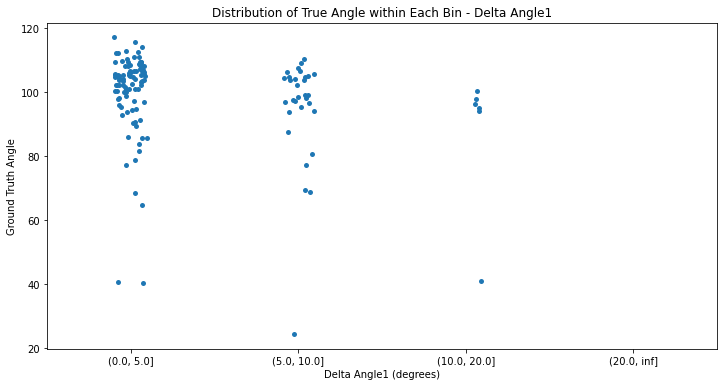

File: 13852.jpg


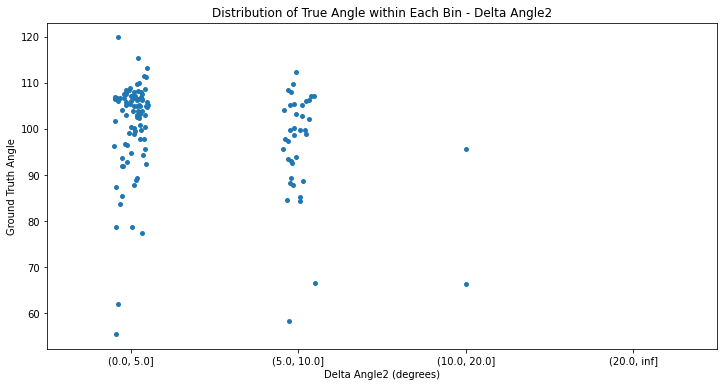

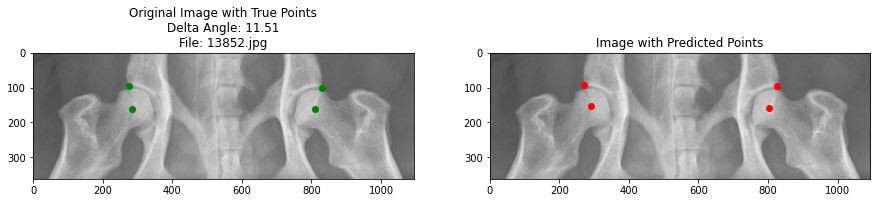

File: 39402.jpg


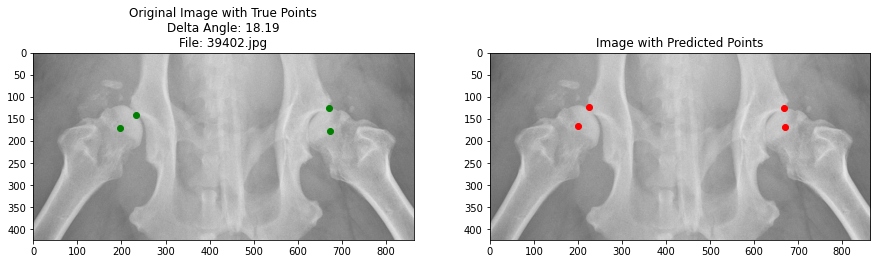

File: ZW1.jpg


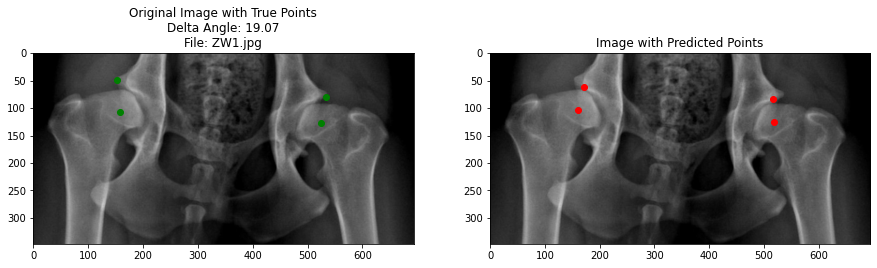

File: 37558.jpg


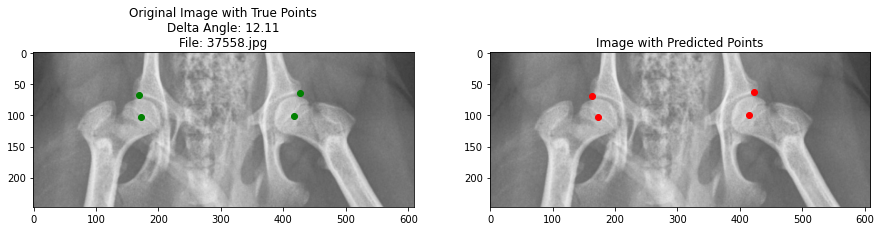

File: 13947.jpg


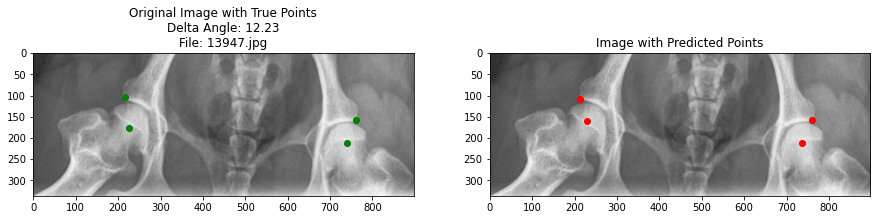

File: CIKG01XX.jpg


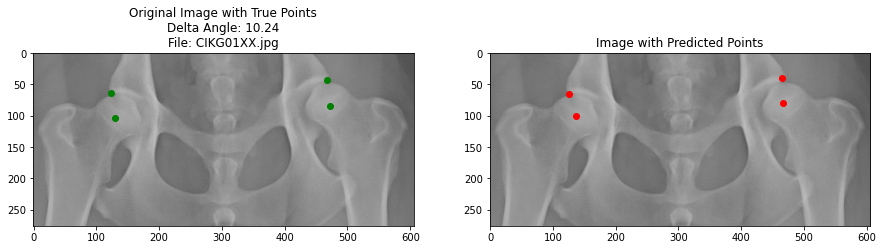

In [42]:
evaluate_df(df1)

In [43]:
all_matrics(df1)

Percentage of angles with less than 1 degree error: 15.65%
Percentage of angles with less than 5 degrees error: 70.99%
Percentage of angles with less than 10 degrees error: 96.95%
Percentage of Delta Angle1 < 5: 71.76%
Percentage of Delta Angle2 < 5: 70.23%
Percentage of Delta Angle1 < 10: 95.42%
Percentage of Delta Angle2 < 10: 98.47%
MAE for Angle1: 3.884539617612535
MAE for Angle2: 3.712054437467279
MAE for all Angles: 3.7982970275399075
MSE Point: 19.29960561984987
MSE Angle: 22.619084896860222
MSE Radius: 6.525513210536591
MAE Point: 3.5441771158181465
MAE Radius: 1.6941455811295234
MAPE Point: 0.024486236600237667
MAPE Angle: 0.040987254160414766
MAPE Radius: 0.036681138602869465
R2 Head Left: 0.9868993319822392
R2 Head Right: 0.9928291796793545
R2 Center1: 0.9786227880637706
R2 Center2: 0.9891356826362507
R2 Angle: 0.8576823067315782
R2 radius: 0.9188452954582498


In [49]:
## use different confidience threshold to compute best point

def calculate_angle(center, head, opposite_center):
    center = np.array(center).flatten()
    head = np.array(head).flatten()
    opposite_center = np.array(opposite_center).flatten()
    
    vector1 = head - center
    vector2 = opposite_center - center
    
    cos_angle = np.dot(vector1, vector2) / (np.linalg.norm(vector1) * np.linalg.norm(vector2))
    cos_angle = np.clip(cos_angle, -1.0, 1.0)
    angle = np.arccos(cos_angle)
    return np.degrees(angle)

def calculate_error(pred_points, true_points):
    return np.mean(np.linalg.norm(pred_points - true_points, axis=1))

def extract_keypoints_from_heatmap(pose_results, bboxes):
    keypoints = []
    for idx, pose_result in enumerate(pose_results):
        heatmap = pose_result._pred_heatmaps.heatmaps[0].cpu().numpy()
        x1, y1, x2, y2 = bboxes[idx]
        width, height = x2 - x1, y2 - y1
        heatmap_resized = cv2.resize(heatmap, (width, height))
        max_y, max_x = np.unravel_index(np.argmax(heatmap_resized), heatmap_resized.shape)
        max_x += x1
        max_y += y1
        keypoints.append([max_x, max_y])
    return keypoints

def predict_and_save_optimize(image_path, mat_file_path, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range):
    image = imread(image_path)
    mat_data = scipy.io.loadmat(mat_file_path)
    four_points = mat_data['Four_points']
    left_head, right_head = four_points[2], four_points[3]
    center1, center2 = four_points[0], four_points[1]
    radius1, radius2 = four_points[4][0], four_points[4][1]
    angles = mat_data['Angles']
    
    best_df = None
    best_error = float('inf')
    
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    detect_result_all = inference_detector(detector, image_path)
    pred_instance_all = detect_result_all.pred_instances.cpu().numpy()
    bboxes_all = np.concatenate((pred_instance_all.bboxes, pred_instance_all.scores[:, None]), axis=1)           
    
    for conf_thres_center in conf_thres_center_range:
        for conf_thres_head in conf_thres_head_range:
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

            # Center detection
            bboxes_center = bboxes_all[(pred_instance_all.labels == 1) & (pred_instance_all.scores > conf_thres_center)]
            bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')
            centers_pred = []
            if len(bboxes_center) > 0:
                pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
                centers_pred = [pose_result.pred_instances.keypoints[0].astype('int') for pose_result in pose_results_center]

            # Head detection
            bboxes_head = bboxes_all[(pred_instance_all.labels == 0) & (pred_instance_all.scores > conf_thres_head)]
            bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')
            heads_pred = []
            if len(bboxes_head) > 0:
                pose_results_head = inference_topdown(pose_estimator, image_path, bboxes_head)
                heads_pred = [pose_result.pred_instances.keypoints[0].astype('int') for pose_result in pose_results_head]

            df = pd.DataFrame({
                'Image Path': [image_path],
                'Left Head X': [left_head[0]], 'Left Head Y': [left_head[1]],
                'Right Head X': [right_head[0]], 'Right Head Y': [right_head[1]],
                'Center1 X': [center1[0]], 'Center1 Y': [center1[1]],
                'Center2 X': [center2[0]], 'Center2 Y': [center2[1]],
                'Radius1': [radius1], 'Radius2': [radius2],
                'Angle1': [angles[0][0]], 'Angle2': [angles[0][1]],
                'Pred Left Head X': [np.nan], 'Pred Left Head Y': [np.nan],
                'Pred Right Head X': [np.nan], 'Pred Right Head Y': [np.nan],
                'Pred Center1 X': [np.nan], 'Pred Center1 Y': [np.nan],
                'Pred Center2 X': [np.nan], 'Pred Center2 Y': [np.nan],
                'Pred Radius1': [np.nan], 'Pred Radius2': [np.nan],
                'Pred Angle1': [np.nan], 'Pred Angle2': [np.nan]
            })

            if len(centers_pred) >= 2 and len(heads_pred) >= 2:
                # Sort predicted points by x-coordinate to ensure left and right order
                #print('centers_pred',centers_pred)
                centers_pred = sorted(centers_pred, key=lambda p: p[0][0])
                heads_pred = sorted(heads_pred, key=lambda p: p[0][0])

                # Predicted radii
                predicted_radius1 = max(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
                predicted_radius2 = max(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2

                # Predicted angles
                predicted_angle1 = calculate_angle(centers_pred[0], heads_pred[0], centers_pred[1])
                predicted_angle2 = calculate_angle(centers_pred[1], heads_pred[1], centers_pred[0])

                # Fill DataFrame with predicted values
                pred_left_head, pred_right_head = heads_pred
                pred_center1, pred_center2 = centers_pred
                pred_left_head = pred_left_head.flatten()
                pred_right_head = pred_right_head.flatten()
                pred_center1 = pred_center1.flatten()
                pred_center2 = pred_center2.flatten()

                # Update DataFrame with the flattened predicted values
                df.loc[0, 'Pred Left Head X'], df.loc[0, 'Pred Left Head Y'] = pred_left_head
                df.loc[0, 'Pred Right Head X'], df.loc[0, 'Pred Right Head Y'] = pred_right_head
                df.loc[0, 'Pred Center1 X'], df.loc[0, 'Pred Center1 Y'] = pred_center1
                df.loc[0, 'Pred Center2 X'], df.loc[0, 'Pred Center2 Y'] = pred_center2

                # df.loc[0, 'Pred Left Head X'], df.loc[0, 'Pred Left Head Y'] = pred_left_head
                # df.loc[0, 'Pred Right Head X'], df.loc[0, 'Pred Right Head Y'] = pred_right_head
                # df.loc[0, 'Pred Center1 X'], df.loc[0, 'Pred Center1 Y'] = pred_center1
                # df.loc[0, 'Pred Center2 X'], df.loc[0, 'Pred Center2 Y'] = pred_center2
                df.loc[0, 'Pred Radius1'] = predicted_radius1
                df.loc[0, 'Pred Radius2'] = predicted_radius2
                df.loc[0, 'Pred Angle1'] = predicted_angle1
                df.loc[0, 'Pred Angle2'] = predicted_angle2

    return df

def process_all_images_and_save_optimize(image_dir, label_dir, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    all_dfs = []
    for image_file in os.listdir(image_dir):
        image_path = os.path.join(image_dir, image_file)
        mat_file_path = os.path.join(label_dir, os.path.splitext(image_file)[0] + '.mat')
        if os.path.exists(mat_file_path):
            df = predict_and_save_optimize(image_path, mat_file_path, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range)
            if df is not None:
                all_dfs.append(df)

    if all_dfs:
        final_df = pd.concat(all_dfs, ignore_index=True)
        output_path = os.path.join(output_dir, 'predictions_optimized.csv')
        final_df.to_csv(output_path, index=False)
    return final_df

#process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

In [50]:
import time

start_time = time.time()

output_dir = '/home/featurize/work/Result'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
df3 = process_all_images_and_save_optimize(image_dir, label_dir, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range, output_dir)

end_time = time.time()

execution_time = end_time - start_time
print(f"Execution time: {execution_time} seconds")

Execution time: 301.5983695983887 seconds


In [51]:
evaluate_df(df3)

Percentage of angles with less than 1 degree error: 15.27%
Percentage of angles with less than 5 degrees error: 69.85%
Percentage of angles with less than 10 degrees error: 95.42%
Percentage of Delta Angle1 < 5: 70.23%
Percentage of Delta Angle2 < 5: 69.47%
Percentage of Delta Angle1 < 10: 93.89%
Percentage of Delta Angle2 < 10: 96.95%


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

In [19]:
def save_predictions_to_mat(df, output_dir):
    for index, row in df.iterrows():
        
        image_file_name = os.path.splitext(os.path.basename(row['Image Path']))[0]
        
        
        four_points = np.array([
           
            [row['Pred Center1 X'], row['Pred Center1 Y']],
            [row['Pred Center2 X'], row['Pred Center2 Y']],
            [row['Pred Left Head X'], row['Pred Left Head Y']],
            [row['Pred Right Head X'], row['Pred Right Head Y']],
            [row['Pred Radius1'], row['Pred Radius2']]
        ])
        
        
        angles = np.array([[row['Pred Angle1'], row['Pred Angle2']]])
        
        
        mat_content = {
            '__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: ' + bytes(pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S'), 'utf-8'),
            '__version__': '1.0',
            '__globals__': [],
            'Four_points': four_points,
            'Angles': angles
        }
        
        
        file_name = f"{image_file_name}.mat"
        file_path = os.path.join(output_dir, file_name)
        
        
        scipy.io.savemat(file_path, mat_content)
        print(f"Saved predictions to {file_path}")


#output_dir = '/home/featurize/work/Result/Predict'
#save_predictions_to_mat(df, output_dir)

In [20]:
def predict_optimize_image_only(image_path, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range):
    image = imread(image_path)
    
    best_df = None
    ###
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    detect_result_all = inference_detector(detector, image_path)
    pred_instance_all = detect_result_all.pred_instances.cpu().numpy()
    bboxes_all = np.concatenate((pred_instance_all.bboxes, pred_instance_all.scores[:, None]), axis=1)           
    
    for conf_thres_center in conf_thres_center_range:
        for conf_thres_head in conf_thres_head_range:
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

            # Center detection
            bboxes_center = bboxes_all[np.logical_and(pred_instance_all.labels == 1, pred_instance_all.scores > conf_thres_center)]
            bboxes_center = bboxes_all[np.logical_and(pred_instance_all.labels == 1, pred_instance_all.scores > conf_thres_center)]
            bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

            centers_pred = []
            if len(bboxes_center) > 0:
                pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
                try:
                    data_samples_center = merge_data_samples(pose_results_center)
                    centers_pred = data_samples_center.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Head detection
            bboxes_head = bboxes_all[np.logical_and(pred_instance_all.labels == 0, pred_instance_all.scores > conf_thres_head)]
            bboxes_head = bboxes_all[np.logical_and(pred_instance_all.labels == 0, pred_instance_all.scores > conf_thres_head)]
            bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

            heads_pred = []
            if len(bboxes_head) > 0:
                pose_results_head = inference_topdown(pose_estimator, image_path, bboxes_head)
                try:
                    data_samples_head = merge_data_samples(pose_results_head)
                    heads_pred = data_samples_head.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')
###
    
            # Initialize DataFrame with predicted values
            df = pd.DataFrame({
                'Image Path': [image_path],
                'Pred Left Head X': [np.nan],
                'Pred Left Head Y': [np.nan],
                'Pred Right Head X': [np.nan],
                'Pred Right Head Y': [np.nan],
                'Pred Center1 X': [np.nan],
                'Pred Center1 Y': [np.nan],
                'Pred Center2 X': [np.nan],
                'Pred Center2 Y': [np.nan],
                'Pred Radius1': [np.nan],
                'Pred Radius2': [np.nan],
                'Pred Angle1': [np.nan],
                'Pred Angle2': [np.nan]
            })

            # Update DataFrame with predicted values if predictions are available
            if len(centers_pred) == 2 and len(heads_pred) == 2:
                # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
                centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
                heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])

                predicted_radius1 = max(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
                predicted_radius2 = max(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
                predicted_angle1 = calculate_angle(centers_pred[0][0], heads_pred[0][0], centers_pred[1][0])
                predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[1][0], centers_pred[0][0])

                pred_left_head = heads_pred[0][0]
                pred_right_head = heads_pred[1][0]
                pred_center1 = centers_pred[0][0]
                pred_center2 = centers_pred[1][0]

                df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
                df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
                df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
                df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
                df.loc[0, 'Pred Center1 X'] = pred_center1[0]
                df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
                df.loc[0, 'Pred Center2 X'] = pred_center2[0]
                df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
                df.loc[0, 'Pred Radius1'] = predicted_radius1
                df.loc[0, 'Pred Radius2'] = predicted_radius2
                df.loc[0, 'Pred Angle1'] = predicted_angle1
                df.loc[0, 'Pred Angle2'] = predicted_angle2

                best_df = df
                break  

    return best_df

def process_images_only_and_save(image_dir, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    all_dfs = []
    for image_file in os.listdir(image_dir):
        image_path = os.path.join(image_dir, image_file)
        if image_path.lower().endswith(('.jpg', '.jpeg', '.png')):
            df = predict_optimize_image_only(image_path, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range)
            if df is not None:
                all_dfs.append(df)

    if all_dfs:
        final_df = pd.concat(all_dfs, ignore_index=True)
        #output_path = os.path.join(output_dir, 'predictions_without_gt.csv')
        #final_df.to_csv(output_path, index=False)
    return final_df

In [ ]:
# read unlabeled dataset
image_dir = '/home/featurize/work/Dataset2/data/July_2024'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
output_dir = '/home/featurize/work/Result'

df3=process_images_only_and_save(image_dir, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range, output_dir)

In [20]:
output_dir = '/home/featurize/data/Predict'
save_predictions_to_mat(df6, output_dir)

Saved predictions to /home/featurize/data/Predict/8845.mat
Saved predictions to /home/featurize/data/Predict/4455.mat
Saved predictions to /home/featurize/data/Predict/5809.mat
Saved predictions to /home/featurize/data/Predict/9035.mat
Saved predictions to /home/featurize/data/Predict/9605.mat
Saved predictions to /home/featurize/data/Predict/4218.mat
Saved predictions to /home/featurize/data/Predict/9492.mat
Saved predictions to /home/featurize/data/Predict/2307.mat
Saved predictions to /home/featurize/data/Predict/4866.mat
Saved predictions to /home/featurize/data/Predict/3719.mat
Saved predictions to /home/featurize/data/Predict/5797.mat
Saved predictions to /home/featurize/data/Predict/2949.mat
Saved predictions to /home/featurize/data/Predict/2341.mat
Saved predictions to /home/featurize/data/Predict/4468.mat
Saved predictions to /home/featurize/data/Predict/8134.mat
Saved predictions to /home/featurize/data/Predict/2263.mat
Saved predictions to /home/featurize/data/Predict/5135.m